In [326]:
import numpy as np
import pandas as pd
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib
import warnings
import math
import gc
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, KFold, cross_validate, cross_val_score, GridSearchCV
from sklearn.cluster import KMeans
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.svm import SVC
from sklearn.multioutput import MultiOutputClassifier
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
import xgboost as xgb

import chart_studio.plotly.plotly as py
# import plotly.plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go
import plotly.express as px

import os

warnings.filterwarnings('ignore')
%matplotlib inline
#initiate visualization library for jupyter notebook 
pyoff.init_notebook_mode()

pd.options.display.max_columns=99

In [2]:
customer = pd.read_excel(r"C:\Users\eakhumb\Documents\Python\ML\Capstone\Customer_Data.xlsx")
invoice = pd.read_csv(r"C:\Users\eakhumb\Documents\Python\ML\Capstone\Final_invoice.csv")
invoice.drop(columns="Unnamed: 0", inplace=True)
jtd = pd.read_csv(r"C:\Users\eakhumb\Documents\Python\ML\Capstone\JTD.csv")
jtd.drop(columns="Unnamed: 0", inplace=True)
plant = pd.read_excel(r"C:\Users\eakhumb\Documents\Python\ML\Capstone\Plant Master.xlsx")

In [3]:
customer.head()

,Business Partner,Customer No.,Partner Type,Data Origin,Title,Marital Status,Occupation,Date of Birth,Death date
0,31,1,1.0,Z001,NaN,NaN,NaN,NaN,NaT
1,32,2,1.0,Z005,NaN,NaN,NaN,NaN,NaT
2,34,4,1.0,Z005,NaN,2.0,NaN,NaN,NaT
3,35,5,1.0,Z005,NaN,NaN,NaN,NaN,NaT
4,42,7,1.0,Z008,NaN,NaN,NaN,NaN,NaT


In [4]:
invoice.head()

,Amt Rcvd From Custom,Amt Rcvd From Ins Co,Area / Locality,CGST(14%),CGST(2.5%),CGST(6%),CGST(9%),CITY,Cash /Cashless Type,Claim No.,Cust Type,Customer No.,District,Expiry Date,Gate Pass Date,Gate Pass Time,IGST(12%),IGST(18%),IGST(28%),IGST(5%),Insurance Company,Invoice Date,Invoice No,Invoice Time,Job Card No,JobCard Date,JobCard Time,KMs Reading,Labour Total,Make,Misc Total,Model,ODN No.,OSL Total,Order Type,Outstanding Amt,Parts Total,Pin code,Plant,Plant Name1,Policy no.,Print Status,Recovrbl Exp,Regn No,SGST/UGST(14%),SGST/UGST(2.5%),SGST/UGST(6%),SGST/UGST(9%),Service Advisor Name,TDS amount,Technician Name,Total Amt Wtd Tax.,Total CGST,Total GST,Total IGST,Total SGST/UGST,Total Value,User ID
0,0.0,0.0,MAJIWADA,0.0,0.0,0.0,0.0,Thane,NaN,NaN,Retail,67849,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-02,7005200002,11:30:36,168303,2014-12-13,14:29:43,49317,1203.14,GENERAL MOTORS,0.00,SPARK,7.005200e+09,500.06,Paid Service,0.0,2348.75,400601,BC01,THANE,NaN,NO,0.0,KA19MA1291,0.0,0.0,0.0,0.0,NaN,0.0,RUPESH,4051.95,0.0,0.0,0.0,0.0,4051.95,BC01FS1
1,0.0,0.0,THNAE,0.0,0.0,0.0,0.0,THNAE,NaN,NaN,Retail,84419,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200003,10:07:32,173997,2015-01-02,14:12:18,78584,804.26,TATA MOTORS,197.03,INDICA,7.005200e+09,0.00,SMC Value Package,0.0,0.00,400603,BC01,THANE,NaN,NO,0.0,MH43R3046,0.0,0.0,0.0,0.0,NaN,0.0,PRASHANT,1001.29,0.0,0.0,0.0,0.0,1001.29,BC01SA2
2,0.0,0.0,THANE,0.0,0.0,0.0,0.0,THANE[W],NaN,NaN,Retail,81055,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200004,11:12:57,173889,2015-01-02,11:40:44,33985,180.19,MARUTI SUZUKI,0.00,ZEN,7.005200e+09,0.00,Running Repairs,0.0,52.95,400607,BC01,THANE,NaN,NO,0.0,AP09AX0582,0.0,0.0,0.0,0.0,NaN,0.0,IMRAN,233.14,0.0,0.0,0.0,0.0,233.14,BC01SA2
3,0.0,0.0,THNAE,0.0,0.0,0.0,0.0,THNAE,NaN,NaN,Retail,84419,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200005,11:40:44,174158,2015-01-03,10:12:32,78584,0.00,TATA MOTORS,0.00,INDICA,7.005200e+09,0.00,SMC Redemption,0.0,0.00,400603,BC01,THANE,NaN,NO,0.0,MH43R3046,0.0,0.0,0.0,0.0,NaN,0.0,PRASHANT,0.00,0.0,0.0,0.0,0.0,0.00,BC01SA2
4,0.0,0.0,THANE,0.0,0.0,0.0,0.0,THANE,NaN,NaN,Retail,18980,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200006,12:07:17,173860,2015-01-02,10:45:42,50057,1202.97,HYUNDAI,100.00,SANTRO XING,7.005200e+09,499.99,Paid Service,0.0,944.16,400603,BC01,THANE,NaN,NO,0.0,MH04CD9768,0.0,0.0,0.0,0.0,NaN,0.0,DAYANAND,2747.12,0.0,0.0,0.0,0.0,2747.12,BC01SA2


In [5]:
jtd.head()

,DBM Order,Order Item,Material,Labor Value Number,Description,Item Category,Order Quantity,Target quantity UoM,Net value
0,22385,180,OSLCC_SRV31,NaN,MACHINING RR.SUSPENSION CHARGE (MAJOR),P010,1.2,MIN,1869.87
1,23910,10,1DM279018170117,NaN,ASSY.OIL COOLER (6-PLATE) (VOR,P002,1.0,EA,2151.13
2,23910,40,1IS150203BE01,NaN,FRONT WHEEL BEARING/ LUBRICATE,P002,1.0,EA,2552.92
3,23910,60,1DM279001990173,NaN,ASSY.CYL.HEAD W /O INJ.(NA W /O,P002,1.0,EA,20360.14
4,23910,70,1DM88552790S001SA,NaN,Engine Overhaul Kit -Indica Di,P002,1.0,EA,10691.63


In [6]:
plant.head()

,Plant,Name 1,Valuation Area,Customer no. - plant,Vendor number plant,Factory calendar,Name 2,House number and street,PO Box,Postal Code,City,Sales organization,State
0,BC07,NERKUNDRAM,BC07,PLBC07,PLBC07,IN,NaN,"No.117 Poonamallee High Road,",600107.0,600107,Chennai,MFCS,Tamil Nadu
1,BC30,SAS NAGAR - MOHALI,BC30,PLBC30,PLBC30,IN,NaN,"C-118, Phase 07,",160055.0,160055,Mohali,MFCS,Punjab
2,X001,X001 - AUTO PLANET WHEELS,X001,PLX001,NaN,IN,Thane,"Unit No.3, Kothari Compound,",400610.0,400610,Thane,MFCA,Maharashtra
3,X002,X002 - BHANDARI INDUSTRIES PVT,X002,PLX002,NaN,IN,Ghaziabad,"18/1, C Site 4, Sahibabad",201010.0,201010,Ghaziabad,MFCA,Uttar Pradesh
4,X003,X003 - Om Sri Satya Sai Automo,X003,PLX003,NaN,IN,Bengaluru,"#75, Sy.No. 83/2, Panathur Mai",560087.0,560087,Bengaluru,MFCB,Karnataka


In [7]:
invoice[invoice["Customer No."].apply(lambda x: x.endswith("0"))]["Customer No."].tail()

492274    203850
492277    200980
492300    203810
492306     93840
492309    203820
Name: Customer No., dtype: object

In [8]:
customer[customer["Customer No."].apply(lambda x: str(x).endswith("0"))]["Customer No."].tail()

555285    MFCCM10
555292    MFCCM20
555329     PLX380
555332     PLX500
555337     RSA100
Name: Customer No., dtype: object

In [9]:
customer.shape, invoice.shape, jtd.shape

((555338, 9), (492314, 58), (5619484, 9))

In [10]:
jtd.columns

Index(['DBM Order', 'Order Item', 'Material', 'Labor Value Number',
       'Description', 'Item Category', 'Order Quantity', 'Target quantity UoM',
       'Net value'],
      dtype='object')

In [11]:
data = pd.merge(pd.merge(customer, invoice, on="Customer No."), jtd, how="inner", left_on="Job Card No", right_on="DBM Order", suffixes=("_x", "_jtd"))

In [12]:
data_cust_inv = pd.merge(customer, invoice, on="Customer No.")

In [13]:
data.shape

(154068, 75)

In [14]:
customer["Marital Status"].isnull().sum()

539301

In [15]:
null_cols = data.isnull().sum()
null_cols = pd.DataFrame(null_cols)
null_cols.columns = ["Count"]
null_cols["Count %"] = (null_cols["Count"]/data.shape[0])*100
null_cols.head()

,Count,Count %
Business Partner,0,0.000000
Customer No.,0,0.000000
Partner Type,13596,8.824675
Data Origin,29182,18.940987
Title,134818,87.505517


In [16]:
null_cols[null_cols["Count %"]<90]

,Count,Count %
Business Partner,0,0.000000
Customer No.,0,0.000000
Partner Type,13596,8.824675
Data Origin,29182,18.940987
Title,134818,87.505517
...,...,...
Description,384,0.249241
Item Category,0,0.000000
Order Quantity,0,0.000000
Target quantity UoM,384,0.249241


In [17]:
null_cols[null_cols["Count %"]>90]

,Count,Count %
Marital Status,154068,100.000000
Occupation,154068,100.000000
Date of Birth,154068,100.000000
Death date,154068,100.000000
Area / Locality,150799,97.878210
Cash /Cashless Type,146584,95.142405
Claim No.,152462,98.957603
Expiry Date,153117,99.382740
Gate Pass Date,142356,92.398162
Insurance Company,153079,99.358076


In [445]:
def save_fig(fig, name="Figure", directory="\Plots", extension=".png", alsohtml=True):
    if directory=="\Plots":
        directory = os.getcwd() + directory
    if os.path.exists(directory)==False:
        os.mkdir(directory)
    if directory.endswith("\\")==False:
        directory = directory + "\\"
    count=1
    path1 = directory+name+extension
    path2 = directory+name+".html"
    while os.path.exists(path1):
        if name!="Figure":
            os.remove(path1)
            os.remove(path2)
        else:
            name = name + str(count)
            count = count + 1
            path1 = directory+name+extension
            path2 = directory+name+".html"
    fig.update_layout({
        "plot_bgcolor" : "rgba(0, 0, 0, 0)",
        "paper_bgcolor" : "rgba(0, 0, 0, 0)",
    })
    if alsohtml:
        fig.write_html(path2)
    fig.write_image(path1, scale=3)
    return fig.show()

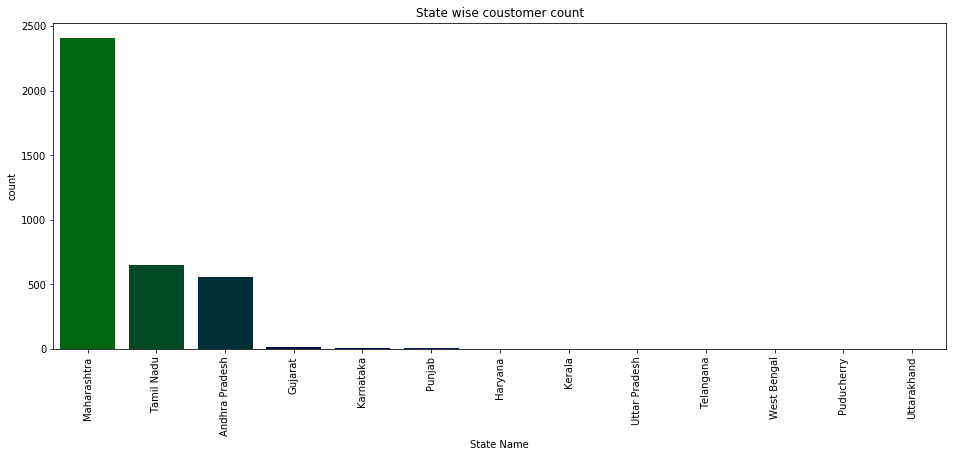

In [18]:
fig, ax = plt.subplots(figsize=(16,6))
unique_cust_dis = data_cust_inv[["Customer No.", "District"]].drop_duplicates()
sns.countplot(x = "District", data=unique_cust_dis, ax=ax, order=unique_cust_dis["District"].value_counts().index, saturation=1, palette="ocean")
plt.xticks(rotation="90")
plt.title("State wise coustomer count")
plt.xlabel("State Name")
plt.show()

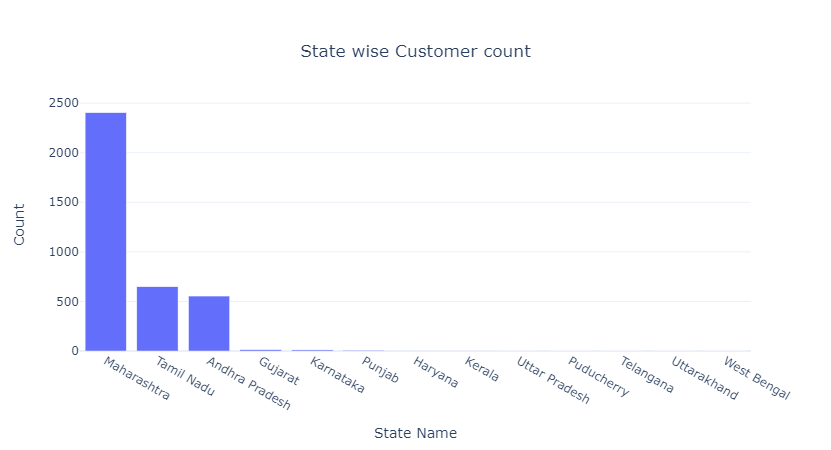

In [382]:
fig = px.bar(
    unique_cust_dis.groupby("District").size().reset_index().sort_values(0, ascending=False).rename(columns={0:"Count", "District":"State Name"}),
    x="State Name",
    y="Count",
    template="plotly_white",
    title={
        'text': "State wise Customer count",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    }
)

save_fig(fig, name="State Wise Customer Count")

In [20]:
cars = invoice[["Make", "Model", "Regn No"]].drop_duplicates().dropna()
duplicate_cars = cars[cars.duplicated("Regn No")].sort_values("Regn No")
final_cars = cars[~cars["Regn No"].isin(duplicate_cars["Regn No"])]
final_cars["Car"] = final_cars["Make"] + " " + final_cars["Model"]

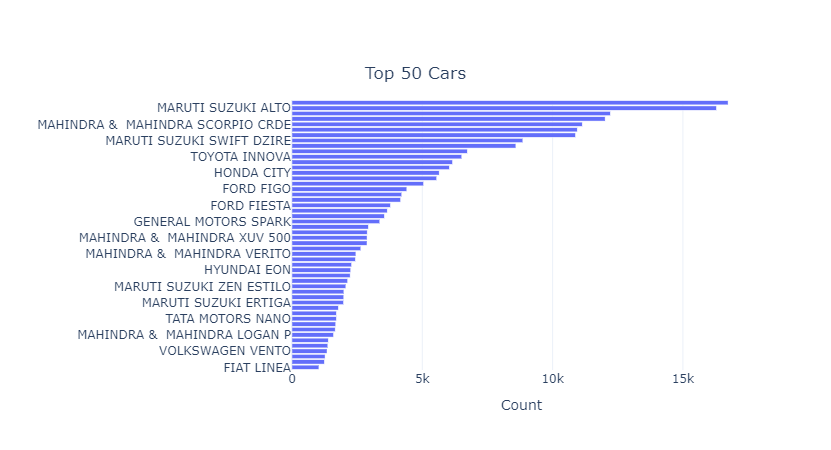

In [21]:
px.bar(
    final_cars["Car"].value_counts().iloc[:50][-1::-1].reset_index(),
    y="index",
    x="Car",
    template="plotly_white",
    title={
        'text': "Top 50 Cars",
        'y':0.85,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    labels={'Car':"Count", "index":""},
    orientation='h'
)

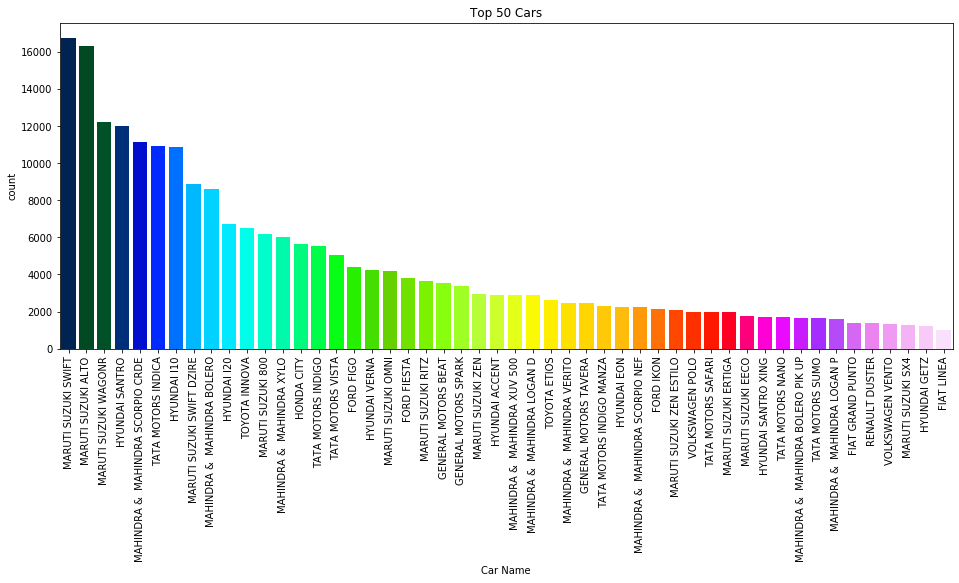

In [22]:
fig, ax = plt.subplots(figsize=(16,6))
sns.countplot(x="Car", data=final_cars, order=final_cars["Car"].value_counts().iloc[:50].index, ax=ax, saturation=1, palette="gist_ncar")
plt.xticks(rotation="90")
plt.title("Top 50 Cars")
plt.xlabel("Car Name")
plt.show()

In [23]:
cars = invoice[["Make", "Model", "Regn No"]].drop_duplicates().dropna()
cars["Car"] = cars["Make"] + " " + cars["Model"]

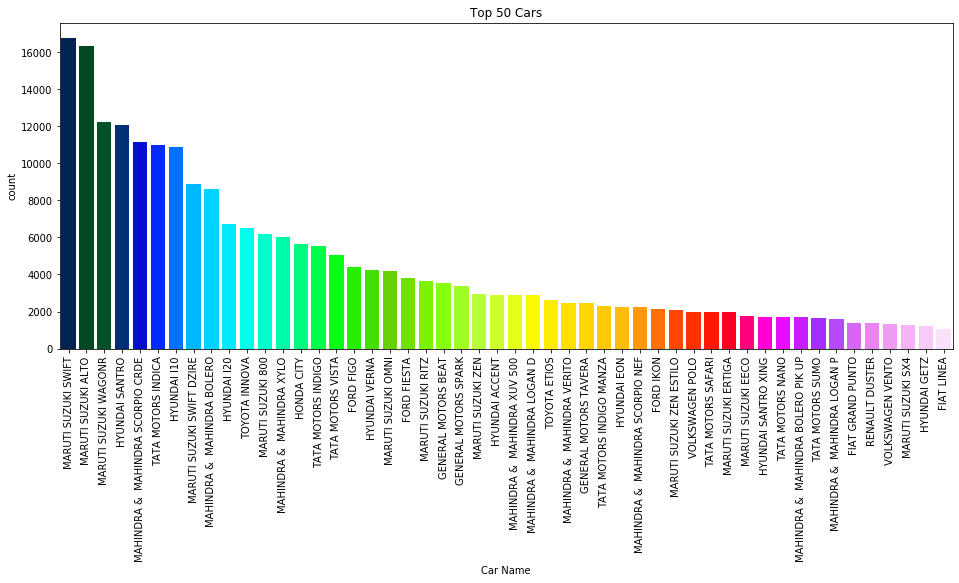

In [24]:
fig, ax = plt.subplots(figsize=(16,6))
sns.countplot(x="Car", data=cars, order=final_cars["Car"].value_counts().iloc[:50].index, ax=ax, saturation=1, palette="gist_ncar")
plt.xticks(rotation="90")
plt.title("Top 50 Cars")
plt.xlabel("Car Name")
plt.show()

In [25]:
state_code = ['AP', 'AR', 'BR', 'CG', 'CH', 'AN', 'DL', 'DN', 'DD', 'GA', 'GJ', 'HP', 'HR', 'JH', 'JK', 'KA', 'KL', 'LD', 'LA', 'MH', 'ML', 'MN', 'MP', 'MZ', 'NL', 'OD','OR', 'PB', 'PY', 'RJ', 'SK', 'TN', 'TS', 'TR', 'UP', 'UK', 'WB']

In [26]:
cust_orderType = data_cust_inv[["Customer No.", "Order Type"]].drop_duplicates()

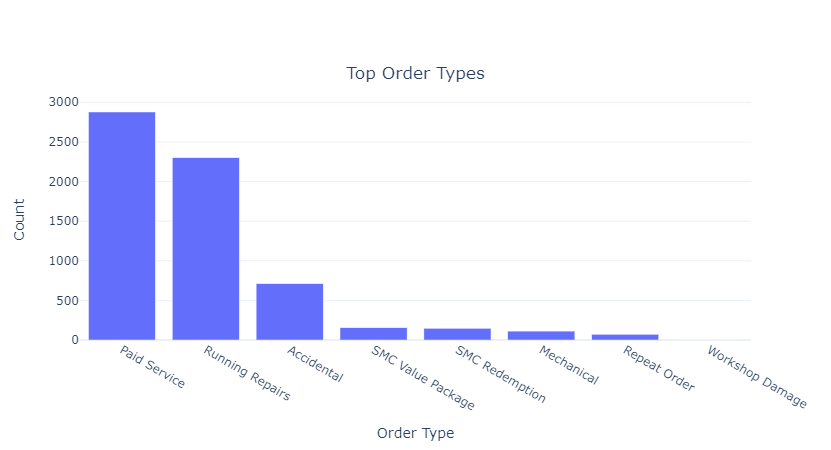

In [27]:
px.bar(
    cust_orderType["Order Type"].value_counts().reset_index(),
    x="index",
    y="Order Type",
    template="plotly_white",
    title={
        "text" : "Top Order Types",
        "x" : 0.5,
        "y" : 0.85
    },
    labels={
        "index" : "Order Type",
        "Order Type" : "Count"
    }
)

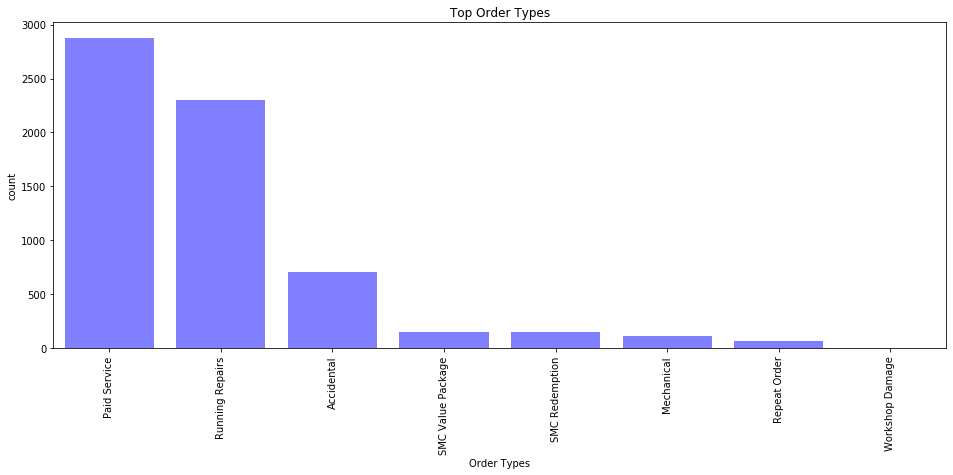

In [28]:
fig, ax = plt.subplots(figsize=(16,6))
sns.countplot(x="Order Type", data=cust_orderType, order=cust_orderType["Order Type"].value_counts().index, ax=ax, saturation=1, color="blue", alpha=0.5)
plt.xticks(rotation="90")
plt.title("Top Order Types")
plt.xlabel("Order Types")
plt.show()

In [29]:
null_cols.loc["Cust Type"]

Count      0.0
Count %    0.0
Name: Cust Type, dtype: float64

In [30]:
cust_custType = data_cust_inv[["Customer No.", "Cust Type"]].drop_duplicates()

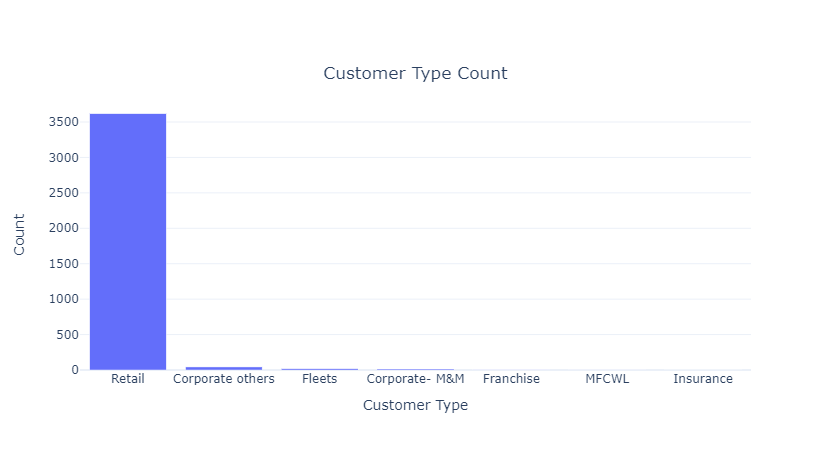

In [31]:
px.bar(
    cust_custType["Cust Type"].value_counts().reset_index(),
    x="index",
    y="Cust Type",
    template="plotly_white",
    title={
        "text" : "Customer Type Count",
        "x" : 0.5,
        "y" : 0.85
    },
    labels={
        "index" : "Customer Type",
        "Cust Type" : "Count"
    }
)

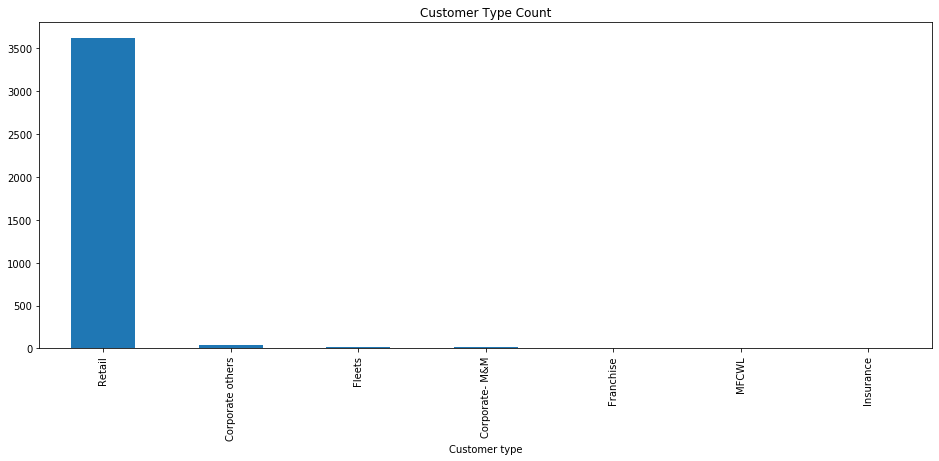

In [32]:
cust_custType["Cust Type"].value_counts().plot(kind="bar", figsize=(16, 6))
plt.xlabel("Customer type")
plt.title("Customer Type Count")
plt.show()

In [33]:
amt_order = pd.DataFrame(invoice.groupby("Order Type")["Total Amt Wtd Tax."].sum())

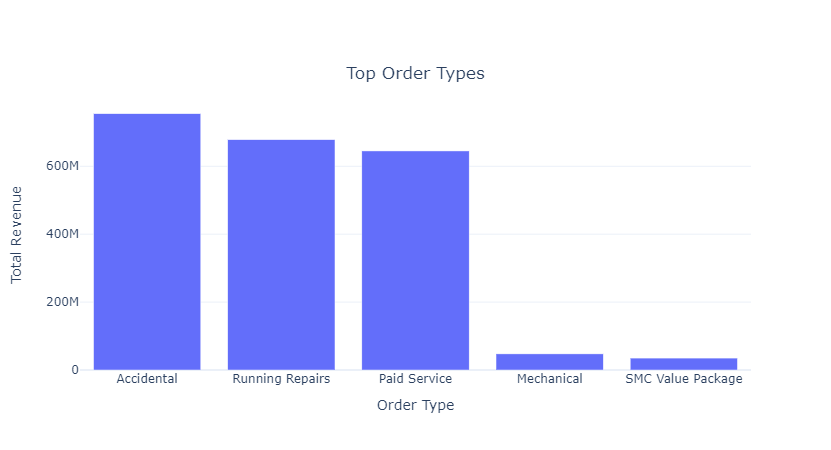

In [34]:
px.bar(
    amt_order.sort_values("Total Amt Wtd Tax.", ascending=False)["Total Amt Wtd Tax."][:5].reset_index(),
    x="Order Type",
    y="Total Amt Wtd Tax.",
    template="plotly_white",
    title={
        "text" : "Top Order Types",
        "x" : 0.5,
        "y" : 0.85
    },
    labels={
        "Total Amt Wtd Tax." : "Total Revenue"
    }
)

In [35]:
amt_order = amt_order.sort_values("Total Amt Wtd Tax.", ascending=False)
amt_order["Total Amt Wtd Tax."] = amt_order["Total Amt Wtd Tax."]//1000000
amt_order["Total Amt Wtd Tax."] = amt_order["Total Amt Wtd Tax."].astype("int")

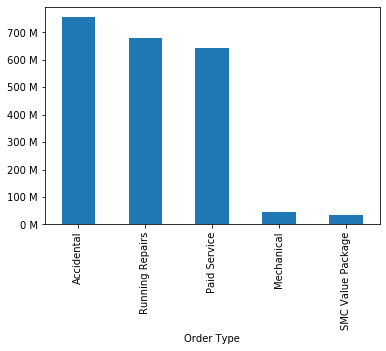

In [36]:
amt_order["Total Amt Wtd Tax."][:5].plot(kind="bar")
y = plt.yticks()[0][:-1]
plt.yticks(y, [str(i)[:-2]+" M" for i in y])
plt.show()

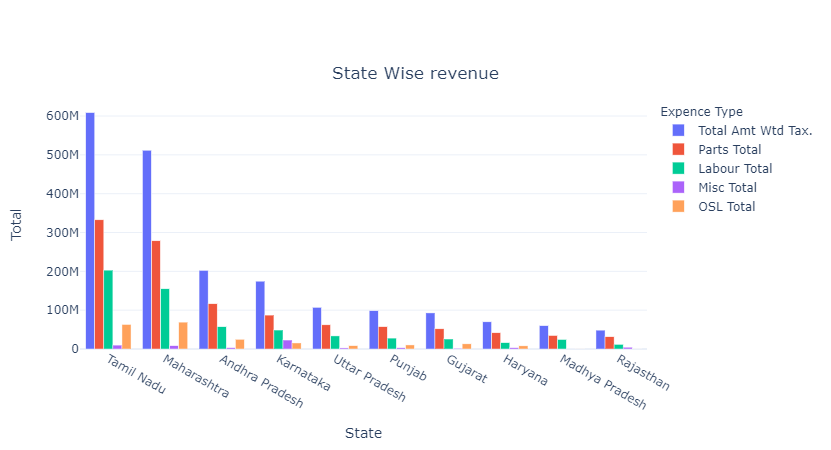

In [37]:
px.bar(
    (invoice.groupby(by="District")["Total Amt Wtd Tax.", "Parts Total", "Labour Total", "Misc Total", "OSL Total"].sum()).sort_values("Total Amt Wtd Tax.", ascending=False).iloc[:10].unstack().reset_index(),
    x="District",
    y=0,
    color="level_0",
    barmode='group',
    template="plotly_white",
    title={
        "text" : "State Wise revenue",
        "x" : 0.5,
        "y" : 0.85
    },
    labels={
        "District" : "State",
        "0" : "Total",
        "level_0" : "Expence Type"
    }
)

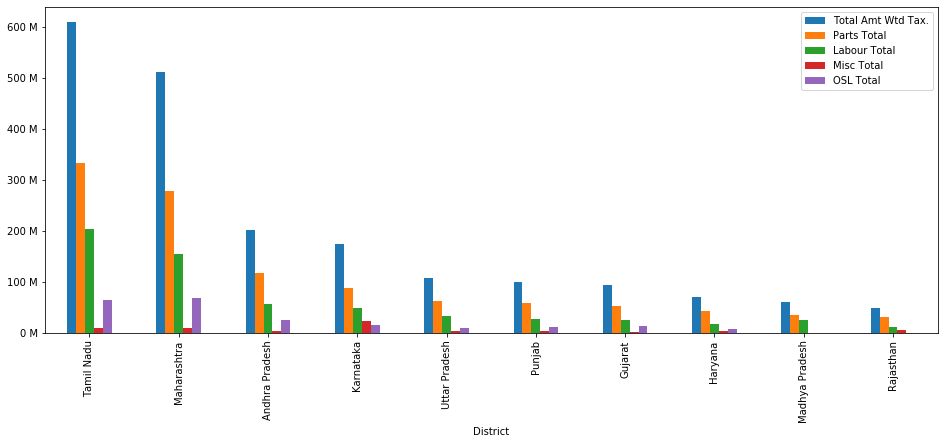

In [38]:
(invoice.groupby(by="District")["Total Amt Wtd Tax.", "Parts Total", "Labour Total", "Misc Total", "OSL Total"].sum()/1000000).sort_values("Total Amt Wtd Tax.", ascending=False).iloc[:10].plot(kind="bar", figsize=(16,6))
y = plt.yticks()[0][:-1]
plt.yticks(y, [str(i)[:-2]+" M" for i in y])
plt.show()

In [39]:
most_osl_cat = (invoice.groupby("Order Type")[["OSL Total"]].sum()//1000000).astype("int")
most_osl_cat = most_osl_cat[most_osl_cat["OSL Total"]>0]
most_osl_cat = most_osl_cat.sort_values("OSL Total", ascending=False)

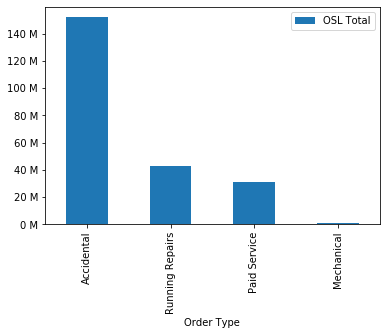

In [40]:
most_osl_cat.plot(kind="bar")
y = plt.yticks()[0][:-1]
plt.yticks(y, [str(i)[:-2]+" M" for i in y])
plt.show()

In [41]:
most_osl_cat = invoice.groupby("Order Type")[["OSL Total"]].sum()
most_osl_cat = most_osl_cat[most_osl_cat["OSL Total"]>1000000]
most_osl_cat = most_osl_cat.sort_values("OSL Total", ascending=False).reset_index()

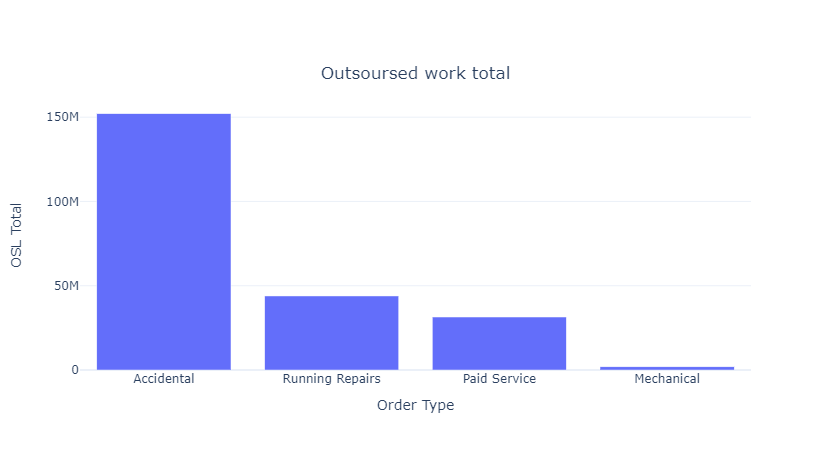

In [42]:
px.bar(
    most_osl_cat,
    x="Order Type",
    y="OSL Total",
    template="plotly_white",
    title={
        "text" : "Outsoursed work total",
        "x" : 0.5,
        "y" : 0.85
    }
)

# Data Cleaning

In [43]:
def null_columns():
    null_cols = data.isnull().sum()
    null_cols = pd.DataFrame(null_cols)
    null_cols.columns = ["Count"]
    null_cols["Count %"] = (null_cols["Count"]/data.shape[0])*100
    return (null_cols, null_cols[null_cols["Count %"]>0])

In [44]:
null_cols = list(null_cols[null_cols["Count %"]>90].index)

In [45]:
data.drop(columns=null_cols, inplace=True)

In [46]:
data["Partner Type"].value_counts()

1.0    124757
2.0     11453
3.0      4262
Name: Partner Type, dtype: int64

In [47]:
df_dpt = pd.DataFrame(data.groupby(["District", "Partner Type"]).size())
g = df_dpt[[0]].groupby(level=0, group_keys=False)
df_dpt = g.apply(lambda x: x.sort_values(0,ascending=False).head(1))

In [48]:
state_by_parter_imputer = df_dpt.reset_index().drop(columns=0).set_index("District")

In [49]:
mode_partner = data["Partner Type"].mode()[0]

In [50]:
def partnerImputer(x, parter_list, mode_partner):
    if pd.isna(x["Partner Type"]):
        if x["District"] in parter_list.index:
            x["Partner Type"] = parter_list.loc[x["District"]]["Partner Type"]
        else:
            x["Partner Type"] = mode_partner
    return x

In [51]:
data = data.apply(partnerImputer, axis=1, args=[state_by_parter_imputer, mode_partner])

In [52]:
data["Data Origin"].value_counts()

Z001    124886
Name: Data Origin, dtype: int64

In [53]:
data["Data Origin"].fillna("Z001", inplace=True)

In [54]:
data.drop(columns="Title", inplace=True)

In [55]:
data[["Amt Rcvd From Custom", "Amt Rcvd From Ins Co","CGST(14%)", "CGST(2.5%)", "CGST(6%)", "CGST(9%)", "IGST(12%)", "IGST(18%)", "IGST(28%)", "IGST(5%)", "SGST/UGST(14%)", "SGST/UGST(2.5%)", "SGST/UGST(6%)", "SGST/UGST(9%)"]].apply(pd.Series.value_counts)

,Amt Rcvd From Custom,Amt Rcvd From Ins Co,CGST(14%),CGST(2.5%),CGST(6%),CGST(9%),IGST(12%),IGST(18%),IGST(28%),IGST(5%),SGST/UGST(14%),SGST/UGST(2.5%),SGST/UGST(6%),SGST/UGST(9%)
0.0,144607,144607,144607,144607,144607,144607,144607,144607,144607,144607,144607,144607,144607,144607


In [56]:
data.drop(columns=["Amt Rcvd From Custom", "Amt Rcvd From Ins Co","CGST(14%)", "CGST(2.5%)", "CGST(6%)", "CGST(9%)", "IGST(12%)", "IGST(18%)", "IGST(28%)", "IGST(5%)", "SGST/UGST(14%)", "SGST/UGST(2.5%)", "SGST/UGST(6%)", "SGST/UGST(9%)"], inplace=True)

In [57]:
data[["Outstanding Amt", "TDS amount", "Total CGST", "Total GST", "Total SGST/UGST"]].apply(pd.Series.value_counts)

,Outstanding Amt,TDS amount,Total CGST,Total GST,Total SGST/UGST
0.0,144607,144607,144607,144607,144607


In [58]:
data.drop(columns=["Outstanding Amt", "TDS amount", "Total CGST", "Total GST", "Total SGST/UGST"], inplace=True)

In [59]:
data["Total IGST"].value_counts()

0.0    144607
Name: Total IGST, dtype: int64

In [60]:
data.drop(columns="Total IGST", inplace=True)

In [61]:
make_model_imputer = pd.DataFrame(data.groupby(["Make", "Model"]).size())[0].groupby(level=0, group_keys=False).apply(lambda x: x.sort_values(0, ascending=False).head(1)).reset_index().drop(columns=0).set_index("Make")

In [62]:
def model_imputer(row, impoter_data):
    if pd.isna(row["Model"]):
        row["Model"] = impoter_data.loc[row["Make"]]["Model"]
    return row

In [63]:
data = data.apply(model_imputer, args=[make_model_imputer], axis=1)

In [64]:
null_columns()[1]

,Count,Count %
ODN No.,9461,6.140795
Technician Name,84902,55.106836
Total Value,9461,6.140795
Material,384,0.249241
Labor Value Number,103954,67.472804
Description,384,0.249241
Target quantity UoM,384,0.249241


In [65]:
data.drop(columns=["ODN No.", "Technician Name", "Total Value", "Material", "Labor Value Number", "Description", "Target quantity UoM"], inplace=True)

In [66]:
null_columns()[1]

,Count,Count %


In [67]:
corr_table = data.corr().unstack().abs()
corr_table[(corr_table>0.5) & (corr_table<1)]

Invoice No          Job Card No           0.595230
                    DBM Order             0.595230
Job Card No         Invoice No            0.595230
Labour Total        Parts Total           0.579889
                    Total Amt Wtd Tax.    0.674731
                    Order Item            0.531006
OSL Total           Total Amt Wtd Tax.    0.524790
Parts Total         Labour Total          0.579889
                    Total Amt Wtd Tax.    0.965074
                    Order Item            0.545707
Total Amt Wtd Tax.  Labour Total          0.674731
                    OSL Total             0.524790
                    Parts Total           0.965074
                    Order Item            0.576891
DBM Order           Invoice No            0.595230
Order Item          Labour Total          0.531006
                    Parts Total           0.545707
                    Total Amt Wtd Tax.    0.576891
dtype: float64

In [68]:
data.drop(columns=["Invoice No", "Job Card No", "DBM Order", "Labour Total", "Parts Total", "Order Item", "OSL Total"], inplace=True)

In [69]:
data.drop(columns=["Business Partner", "Customer No.", "Misc Total", "Pin code", "Plant Name1", "Regn No", "Order Quantity", "Net value"], inplace=True)

In [70]:
data.drop(columns="User ID", inplace=True)

In [71]:
obj_cols=data.select_dtypes(["object"]).columns

In [72]:
for col in obj_cols:
    le = LabelEncoder()
    data[col] = le.fit_transform(data[col])

In [73]:
data.head()

,Partner Type,Data Origin,CITY,Cust Type,District,Gate Pass Time,Invoice Date,Invoice Time,JobCard Date,JobCard Time,KMs Reading,Make,Model,Order Type,Plant,Print Status,Recovrbl Exp,Total Amt Wtd Tax.,Item Category
0,1.0,0,15,6,8,639,1409,5753,1404,13920,3000,6,79,1,6,1,0.0,49.75,4
1,1.0,0,27,6,0,0,428,11599,431,13230,172979,8,19,4,3,0,0.0,1083.77,2
2,1.0,0,27,6,0,0,428,11599,431,13230,172979,8,19,4,3,0,0.0,1083.77,2
3,1.0,0,27,6,0,0,428,11599,431,13230,172979,8,19,4,3,0,0.0,1083.77,1
4,1.0,0,27,6,0,0,587,3334,590,8444,42413,9,128,6,3,0,0.0,1001.29,1


In [74]:
invoice.head()

,Amt Rcvd From Custom,Amt Rcvd From Ins Co,Area / Locality,CGST(14%),CGST(2.5%),CGST(6%),CGST(9%),CITY,Cash /Cashless Type,Claim No.,Cust Type,Customer No.,District,Expiry Date,Gate Pass Date,Gate Pass Time,IGST(12%),IGST(18%),IGST(28%),IGST(5%),Insurance Company,Invoice Date,Invoice No,Invoice Time,Job Card No,JobCard Date,JobCard Time,KMs Reading,Labour Total,Make,Misc Total,Model,ODN No.,OSL Total,Order Type,Outstanding Amt,Parts Total,Pin code,Plant,Plant Name1,Policy no.,Print Status,Recovrbl Exp,Regn No,SGST/UGST(14%),SGST/UGST(2.5%),SGST/UGST(6%),SGST/UGST(9%),Service Advisor Name,TDS amount,Technician Name,Total Amt Wtd Tax.,Total CGST,Total GST,Total IGST,Total SGST/UGST,Total Value,User ID
0,0.0,0.0,MAJIWADA,0.0,0.0,0.0,0.0,Thane,NaN,NaN,Retail,67849,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-02,7005200002,11:30:36,168303,2014-12-13,14:29:43,49317,1203.14,GENERAL MOTORS,0.00,SPARK,7.005200e+09,500.06,Paid Service,0.0,2348.75,400601,BC01,THANE,NaN,NO,0.0,KA19MA1291,0.0,0.0,0.0,0.0,NaN,0.0,RUPESH,4051.95,0.0,0.0,0.0,0.0,4051.95,BC01FS1
1,0.0,0.0,THNAE,0.0,0.0,0.0,0.0,THNAE,NaN,NaN,Retail,84419,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200003,10:07:32,173997,2015-01-02,14:12:18,78584,804.26,TATA MOTORS,197.03,INDICA,7.005200e+09,0.00,SMC Value Package,0.0,0.00,400603,BC01,THANE,NaN,NO,0.0,MH43R3046,0.0,0.0,0.0,0.0,NaN,0.0,PRASHANT,1001.29,0.0,0.0,0.0,0.0,1001.29,BC01SA2
2,0.0,0.0,THANE,0.0,0.0,0.0,0.0,THANE[W],NaN,NaN,Retail,81055,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200004,11:12:57,173889,2015-01-02,11:40:44,33985,180.19,MARUTI SUZUKI,0.00,ZEN,7.005200e+09,0.00,Running Repairs,0.0,52.95,400607,BC01,THANE,NaN,NO,0.0,AP09AX0582,0.0,0.0,0.0,0.0,NaN,0.0,IMRAN,233.14,0.0,0.0,0.0,0.0,233.14,BC01SA2
3,0.0,0.0,THNAE,0.0,0.0,0.0,0.0,THNAE,NaN,NaN,Retail,84419,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200005,11:40:44,174158,2015-01-03,10:12:32,78584,0.00,TATA MOTORS,0.00,INDICA,7.005200e+09,0.00,SMC Redemption,0.0,0.00,400603,BC01,THANE,NaN,NO,0.0,MH43R3046,0.0,0.0,0.0,0.0,NaN,0.0,PRASHANT,0.00,0.0,0.0,0.0,0.0,0.00,BC01SA2
4,0.0,0.0,THANE,0.0,0.0,0.0,0.0,THANE,NaN,NaN,Retail,18980,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200006,12:07:17,173860,2015-01-02,10:45:42,50057,1202.97,HYUNDAI,100.00,SANTRO XING,7.005200e+09,499.99,Paid Service,0.0,944.16,400603,BC01,THANE,NaN,NO,0.0,MH04CD9768,0.0,0.0,0.0,0.0,NaN,0.0,DAYANAND,2747.12,0.0,0.0,0.0,0.0,2747.12,BC01SA2


In [75]:
dist_order = pd.DataFrame(data_cust_inv.groupby("District")["Order Type"].value_counts())
dist_order = dist_order.rename(columns={"Order Type": "Count"})
g = dist_order[["Count"]].groupby(level=0, group_keys=False)
dist_order = g.apply(lambda x: x.sort_values("Count").tail(1))
dist_order = dist_order.sort_values("Count", ascending=False).reset_index().set_index("District")

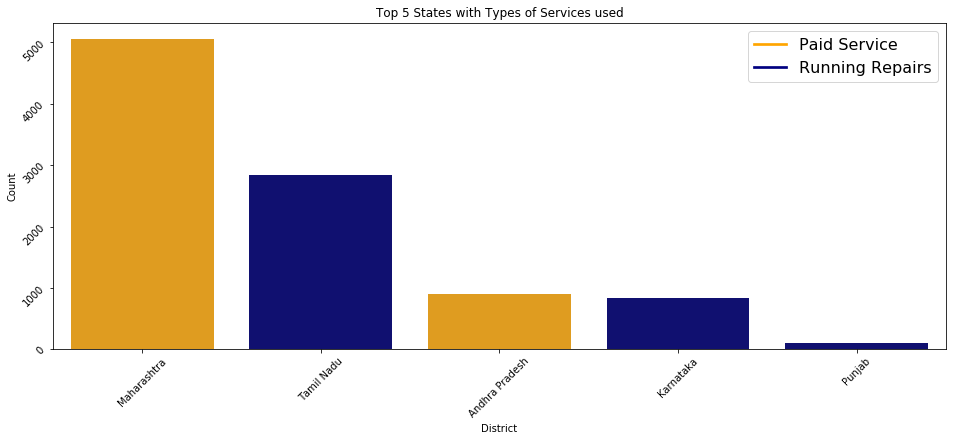

In [76]:
dist_order_5 = dist_order[0:5]
color_comb=["orange", "navy"]
dist_order_5["color"] = dist_order_5["Order Type"].apply(lambda x: color_comb[0] if x=="Paid Service" else color_comb[1])
plt.figure(figsize=(16,6))
sns.barplot(data=dist_order_5, x=dist_order_5.index, y="Count", palette=dist_order_5["color"])
plt.legend(['Paid Service', 'Running Repairs'], prop={'size': 16})
ax = plt.gca()
leg = ax.get_legend()
leg.legendHandles[0].set_color(color_comb[0])
leg.legendHandles[1].set_color(color_comb[1])
plt.xticks(rotation=45)
plt.yticks(rotation=45)
plt.title("Top 5 States with Types of Services used")
plt.show()

In [77]:
dist_order = pd.DataFrame(invoice.groupby("District")["Order Type"].value_counts())
dist_order = dist_order.rename(columns={"Order Type": "Count"})
g = dist_order[["Count"]].groupby(level=0, group_keys=False)
dist_order = g.apply(lambda x: x.sort_values("Count").tail(1))
dist_order = dist_order.sort_values("Count", ascending=False).reset_index().set_index("District")

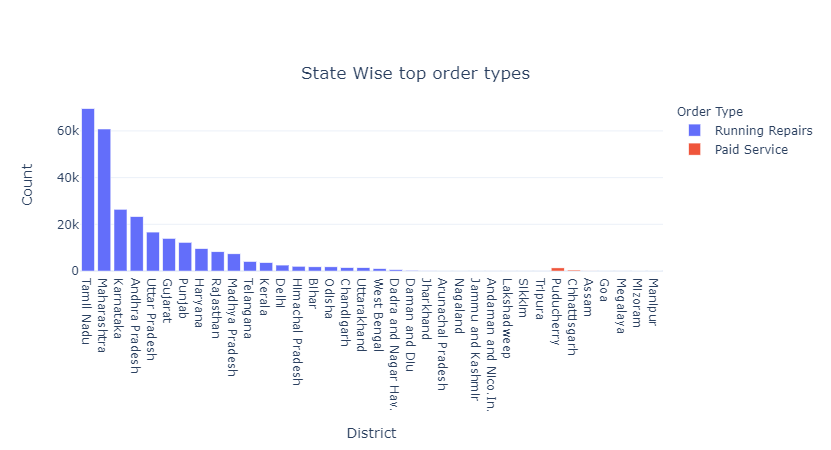

In [78]:
px.bar(
    dist_order.reset_index(),
    x="District",
    y="Count",
    color="Order Type",
    template="plotly_white",
    title={
        "text" : "State Wise top order types",
        "x" : 0.5,
        "y" : 0.85
    }
)

In [79]:
dist_order = pd.DataFrame(data_cust_inv.groupby("District")["Order Type"].value_counts())
dist_order = dist_order.rename(columns={"Order Type": "Count"})
g = dist_order[["Count"]].groupby(level=0, group_keys=False)
dist_order = g.apply(lambda x: x.sort_values("Count", ascending=False))
dist_order = dist_order.sort_values("Count", ascending=False)

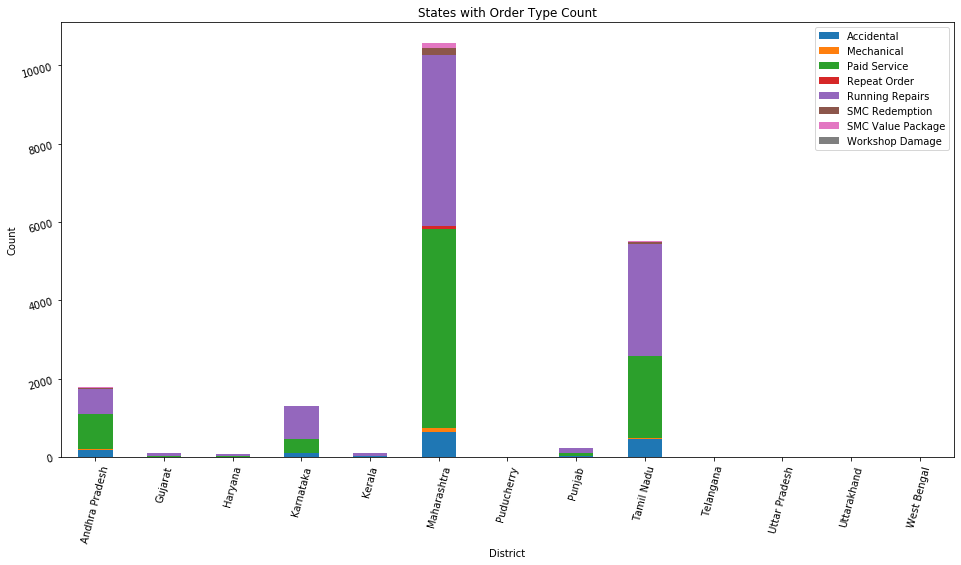

In [80]:
dist_order.unstack().fillna(0).plot(kind="bar", stacked=True, figsize=(16, 8))
plt.xticks(rotation=75)
plt.yticks(rotation=15)
ax = plt.gca()
ax.legend([i.split(",")[1].split(")")[0].strip() for i in  ax.get_legend_handles_labels()[1]])
plt.title("States with Order Type Count")
plt.ylabel("Count")
plt.show()

In [81]:
dist_order = pd.DataFrame(invoice.groupby("District")["Order Type"].value_counts())
dist_order = dist_order.rename(columns={"Order Type": "Count"})
g = dist_order[["Count"]].groupby(level=0, group_keys=False)
dist_order = g.apply(lambda x: x.sort_values("Count", ascending=False))
dist_order = dist_order.sort_values("Count", ascending=False)

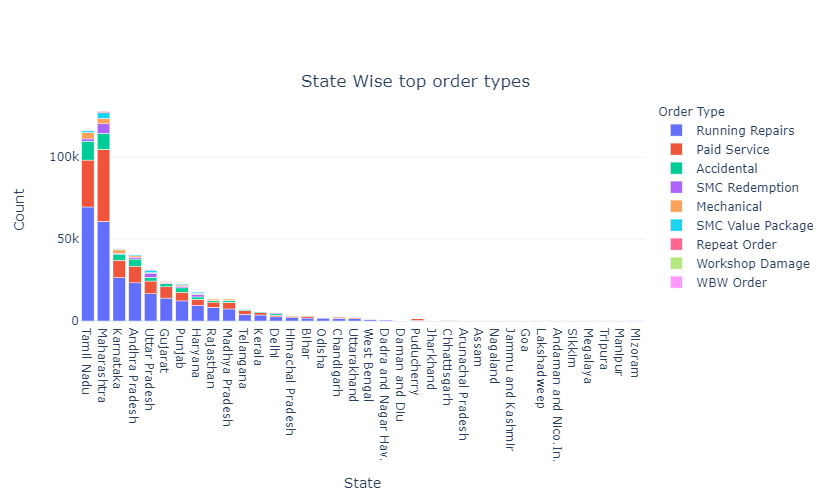

In [451]:
fig = px.bar(
    dist_order.reset_index(),
    x="District",
    y="Count",
    color="Order Type",
    template="plotly_white",
    title={
        "text" : "State Wise top order types",
        "x" : 0.5,
        "y" : 0.85
    },
    height=500,
    labels={
        "District":"State"
    }
)

save_fig(fig, name="State Wise Top Orders")

In [83]:
invoice_new = invoice.copy()

In [84]:
invoice_new["Invoice Date"] = pd.to_datetime(invoice_new["Invoice Date"])
invoice_new["Year"] = invoice_new["Invoice Date"].map(lambda date: date.year)
invoice_new["Month"] = invoice_new["Invoice Date"].map(lambda date: date.month)

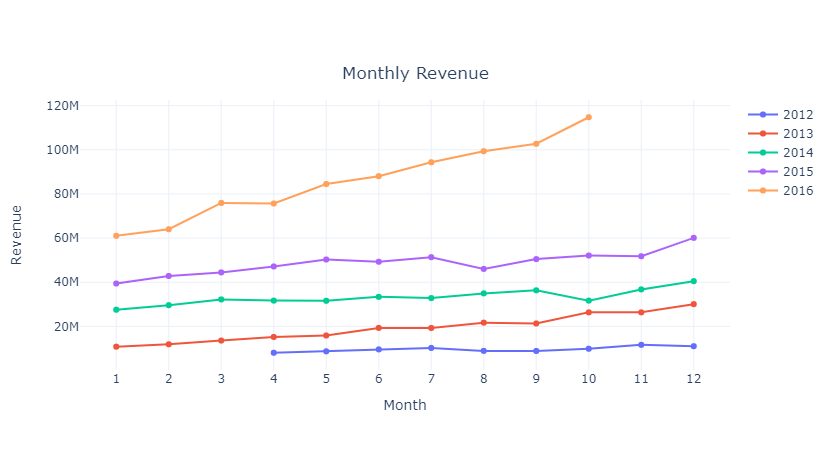

In [659]:
inv_income = invoice_new.groupby(["Year", "Month"])["Total Amt Wtd Tax."].sum().reset_index()
plot_data = []
for yr in inv_income["Year"].unique():
    pl_dt = go.Scatter(
        x = inv_income[inv_income["Year"]==yr]["Month"],
        y = inv_income[inv_income["Year"]==yr]["Total Amt Wtd Tax."],
        name = str(yr),
    )
    plot_data.append(pl_dt)

plot_layout = go.Layout(
    xaxis = dict(tickmode = 'linear', 
             tick0 = 1,
             dtick = 1,
            title = "Month"),
    title = {
        "text" : "Monthly Revenue",
        "x" : 0.5,
        "y" : 0.85
    },
    yaxis={
        "title" : "Revenue"
    },
    template="plotly_white"
)
fig = go.Figure(data=plot_data, layout=plot_layout)
# pyoff.iplot(fig)
save_fig(fig, name="Monthly Revenue Hist")

In [86]:
invoice_new["DayOfWeek"] = invoice_new["Invoice Date"].map(lambda date: date.dayofweek)

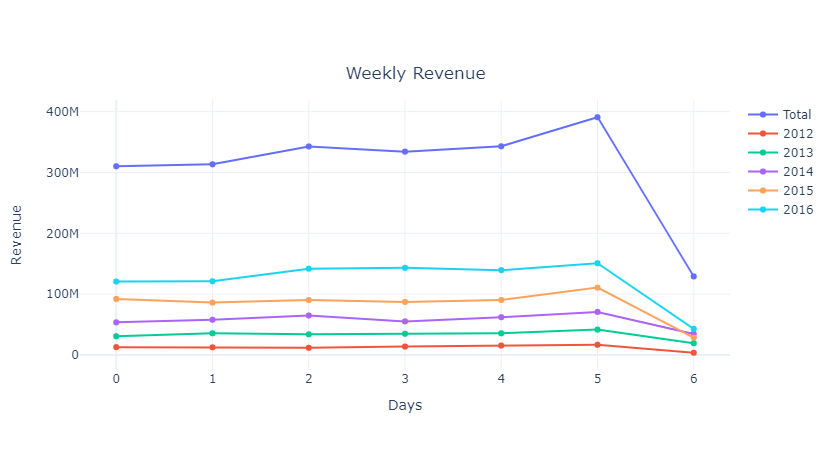

In [87]:
inv_income = invoice_new.groupby(["DayOfWeek"])["Total Amt Wtd Tax."].sum().reset_index()
plot_data = [
    go.Scatter(
        x = inv_income["DayOfWeek"],
        y = inv_income["Total Amt Wtd Tax."],
        name = "Total",
    )
]
inv_income = invoice_new.groupby(["Year", "DayOfWeek"])["Total Amt Wtd Tax."].sum().reset_index()
for yr in inv_income["Year"].unique():
    pt_dt = go.Scatter(
        x = inv_income[inv_income["Year"]==yr]["DayOfWeek"],
        y = inv_income[inv_income["Year"]==yr]["Total Amt Wtd Tax."],
        name = str(yr),
    )
    plot_data.append(pt_dt)

plot_layout = go.Layout(
    title = {
        "text" : "Weekly Revenue",
        "x" : 0.5,
        "y" : 0.85
    },
    yaxis={
        "title" : "Revenue"
    },
    xaxis={
        "title" : "Days"
    },
    template="plotly_white"
)

fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

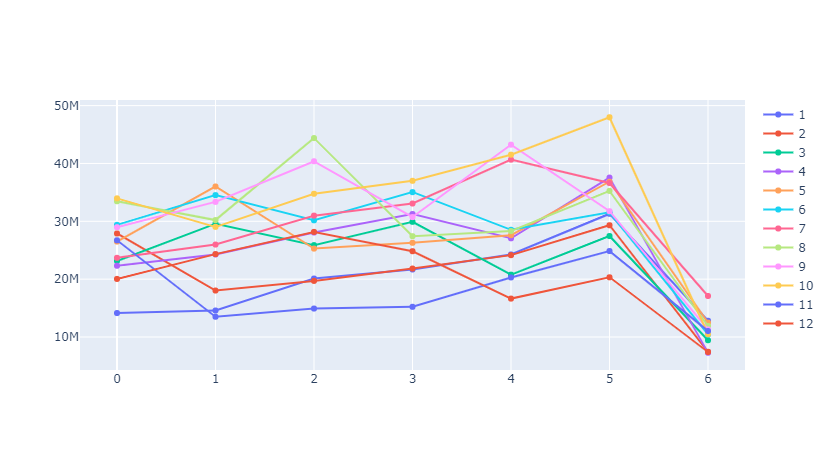

In [88]:
inv_income = invoice_new.groupby(["Month", "DayOfWeek"])["Total Amt Wtd Tax."].sum().reset_index()
plot_data=[]
for mon in np.sort(inv_income["Month"].unique()):
    pt_dt = go.Scatter(
        x = inv_income[inv_income["Month"]==mon]["DayOfWeek"],
        y = inv_income[inv_income["Month"]==mon]["Total Amt Wtd Tax."],
        name = str(mon),
    )
    plot_data.append(pt_dt)

fig = go.Figure(data=plot_data)
pyoff.iplot(fig)

In [89]:
invoice_new["YearMon"] = invoice_new["Invoice Date"].map(lambda date: date.year*100 + date.month)

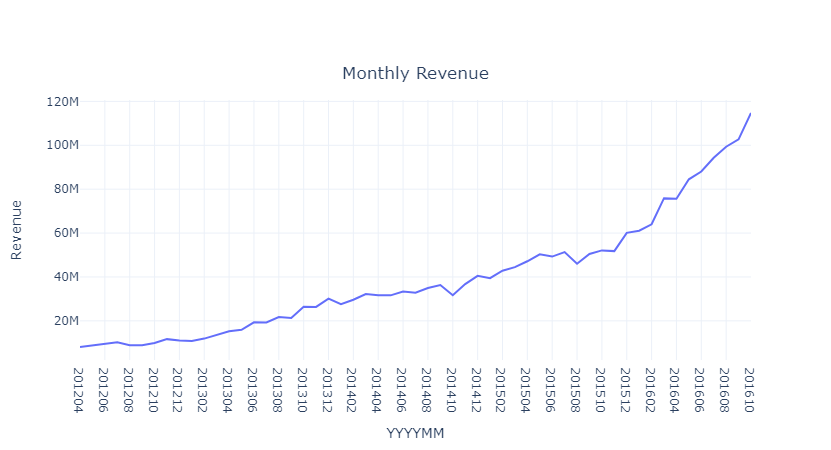

In [90]:
inv_income = invoice_new.groupby(["YearMon"])["Total Amt Wtd Tax."].sum().reset_index()
plot_data = [
    go.Scatter(
        x = inv_income["YearMon"],
        y = inv_income["Total Amt Wtd Tax."],
    )
]

plot_layout = go.Layout(
    xaxis={
        "type": "category",
        "title" : "YYYYMM"
    },
    yaxis={
        "title" : "Revenue"
    },
    title = {
        "text" : "Monthly Revenue",
        "x" : 0.5,
        "y" : 0.85
    },
    template="plotly_white"
)

fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

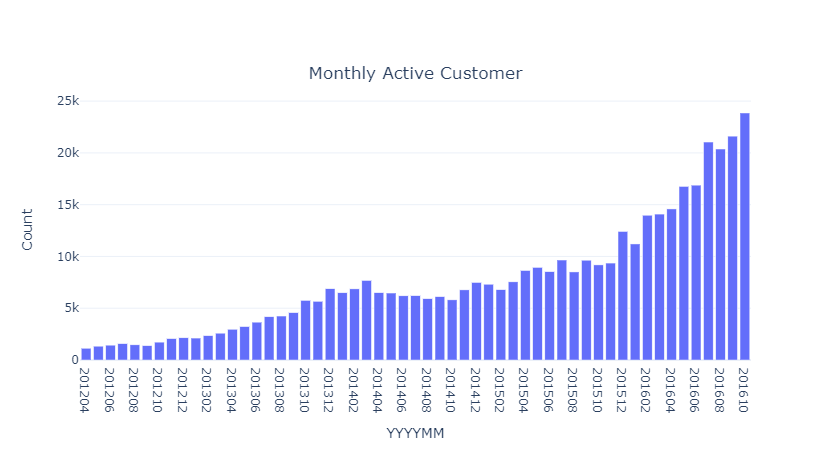

In [91]:
inv_count = invoice_new.groupby("YearMon")["Customer No."].nunique().reset_index()
plot_data = [
    go.Bar(
        x = inv_count["YearMon"],
        y = inv_count["Customer No."],
    )
]

plot_layout = go.Layout(
    title = {
        "text" : "Monthly Active Customer",
        "x" : 0.5,
        "y" : 0.85
    },
    xaxis={
        "type": "category",
        "title" : "YYYYMM"
    },
    yaxis={
        "title" : "Count"
    },
    template="plotly_white"
)

fig = go.Figure(data = plot_data, layout=plot_layout)
pyoff.iplot(fig)

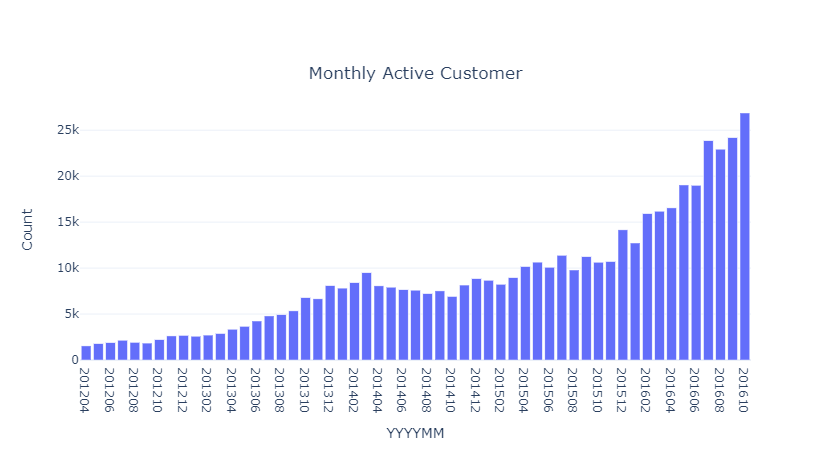

In [92]:
inv_count = invoice_new.groupby("YearMon").size().reset_index()
plot_data = [
    go.Bar(
        x = inv_count["YearMon"],
        y = inv_count[0],
    )
]

plot_layout = go.Layout(
    title = {
        "text" : "Monthly Active Customer",
        "x" : 0.5,
        "y" : 0.85
    },
    xaxis={
        "type": "category",
        "title" : "YYYYMM"
    },
    yaxis={
        "title" : "Count"
    },
    template="plotly_white"
)

fig = go.Figure(data = plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [93]:
new_cust = invoice_new.groupby('Customer No.')["Invoice Date"].min().reset_index()
new_cust = new_cust.rename(columns = {"Invoice Date" : "FirstInvDate"})
invoice_new = pd.merge(invoice_new, new_cust, on="Customer No.")

In [94]:
lost_cust = invoice_new.groupby('Customer No.')["Invoice Date"].max().reset_index()
lost_cust = lost_cust.rename(columns = {"Invoice Date" : "LastInvDate"})
invoice_new = pd.merge(invoice_new, lost_cust, on="Customer No.")

In [95]:
invoice_new["UserType"] = "New"
invoice_new.loc[invoice_new["Invoice Date"]>invoice_new["FirstInvDate"], "UserType"] = "Existing"
# invoice_new.loc[invoice_new["Invoice Date"]==invoice_new["LastInvDate"], "UserType"] = "Lost"

In [96]:
one_time_cust = invoice_new[invoice_new["FirstInvDate"] == invoice_new["LastInvDate"]].groupby("YearMon").size().reset_index()

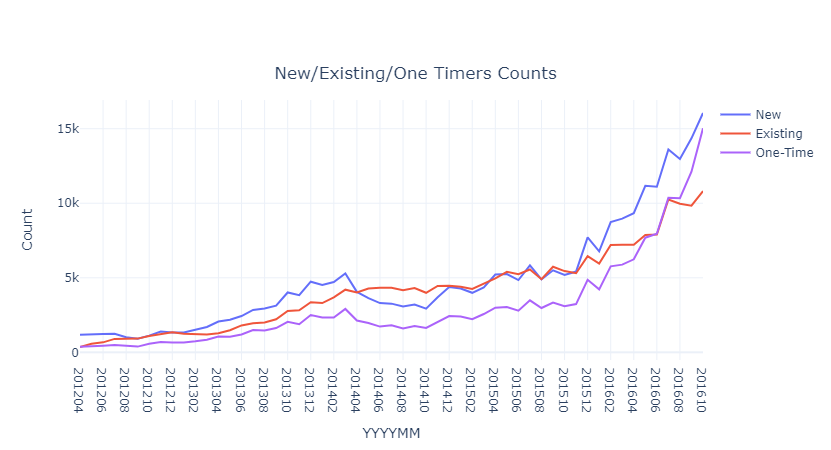

In [97]:
mon_user_count = invoice_new.groupby(["YearMon", "UserType"]).size().reset_index()

plot_data = [
    go.Scatter(
        x = mon_user_count[mon_user_count["UserType"] == "New"]["YearMon"],
        y = mon_user_count[mon_user_count["UserType"] == "New"][0],
        name = "New",
    ),
    go.Scatter(
        x = mon_user_count[mon_user_count["UserType"] == "Existing"]["YearMon"],
        y = mon_user_count[mon_user_count["UserType"] == "Existing"][0],
        name = "Existing",
    ),
    go.Scatter(
        x = mon_user_count[mon_user_count["UserType"] == "Lost"]["YearMon"],
        y = mon_user_count[mon_user_count["UserType"] == "Lost"][0],
        name = "Lost",
    ),
    go.Scatter(
        x = one_time_cust["YearMon"],
        y = one_time_cust[0],
        name = "One-Time",
    )
]

plot_layout = go.Layout(
    title = {
        "text" : "New/Existing/One Timers Counts",
        "x" : 0.5,
        "y" : 0.85
    },
    xaxis={
        "type": "category",
        "title" : "YYYYMM"
    },
    yaxis={
        "title" : "Count"
    },
    template="plotly_white"
)

fig = go.Figure(plot_data, plot_layout)
pyoff.iplot(fig)

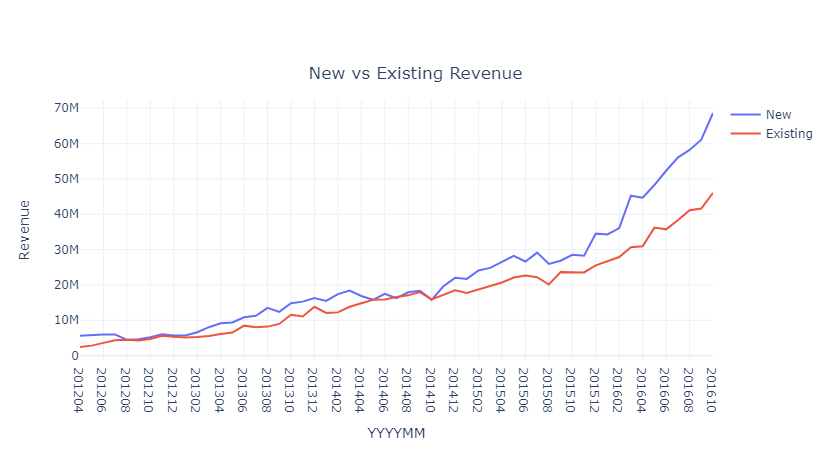

In [98]:
mon_user_revenue = invoice_new.groupby(["YearMon", "UserType"])["Total Amt Wtd Tax."].sum().reset_index()

plot_data = [
    go.Scatter(
        x = mon_user_revenue[mon_user_revenue["UserType"] == "New"]["YearMon"],
        y = mon_user_revenue[mon_user_revenue["UserType"] == "New"]["Total Amt Wtd Tax."],
        name = "New",
    ),
    go.Scatter(
        x = mon_user_revenue[mon_user_revenue["UserType"] == "Existing"]["YearMon"],
        y = mon_user_revenue[mon_user_revenue["UserType"] == "Existing"]["Total Amt Wtd Tax."],
        name = "Existing",
    )
]

plot_layout = go.Layout(
    title = {
        "text" : "New vs Existing Revenue",
        "x" : 0.5,
        "y" : 0.85
    },
    xaxis={
        "type": "category",
        "title" : "YYYYMM"
    },
    yaxis={
        "title" : "Revenue"
    },
    template="plotly_white"
)

fig = go.Figure(plot_data, plot_layout)
pyoff.iplot(fig)

## RFM Clustring

In [99]:
inv_cust = pd.DataFrame(invoice_new["Customer No."].unique())
inv_cust.columns = ["Customer No."]
inv_cust = inv_cust[inv_cust["Customer No."] != "E4981"]

last_purchase = invoice_new["LastInvDate"].max()
inv_res = invoice_new.groupby(["Customer No."])["Invoice Date"].max().reset_index()
inv_res.columns = ["Customer No.", "Last Purchase"]
inv_res["Recency"] = (last_purchase - inv_res["Last Purchase"]).dt.days

inv_cust = pd.merge(inv_cust, inv_res, on="Customer No.")

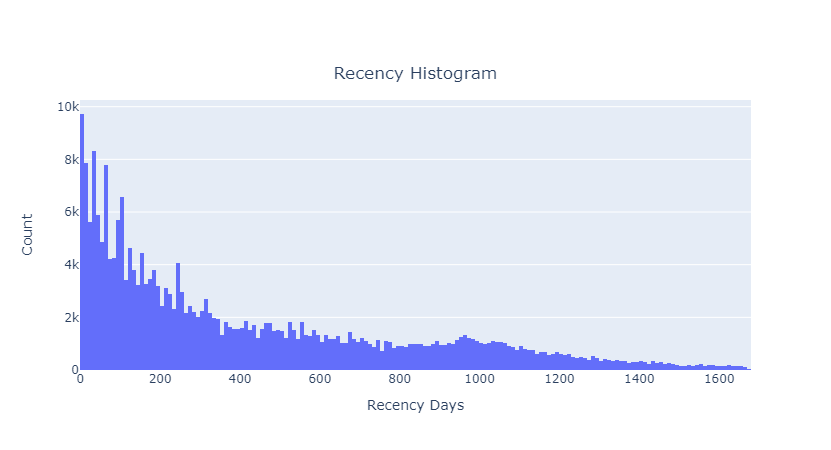

In [100]:
plot_data = [
    go.Histogram(
        x=inv_cust["Recency"]
    )
]

plot_layout = go.Layout(
    title={
        "text":"Recency Histogram",
        "x":0.5,
        "y":0.85
    },
    xaxis={
        "title":"Recency Days"
    },
    yaxis={
        "title":"Count"
    }
)

fig = go.Figure(plot_data, plot_layout)
pyoff.iplot(fig)

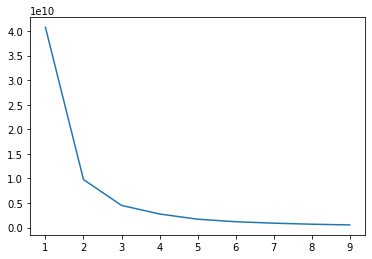

In [101]:
sse = {}

inv_recency = inv_cust[["Recency"]]

for k in range(1, 10):
    kmean = KMeans(n_clusters=k, max_iter=1000).fit(inv_recency)
    inv_recency["cluster"] = kmean.labels_
    sse[k] = kmean.inertia_
    
plt.plot(list(sse.keys()), list(sse.values()))

In [102]:
kmean = KMeans(n_clusters=3, max_iter=1000).fit(inv_recency[["Recency"]])
inv_recency["cluster_1000"] = kmean.predict(inv_recency[["Recency"]])
kmean = KMeans(n_clusters=3, max_iter=10000).fit(inv_recency[["Recency"]])
inv_recency["cluster_10000"] = kmean.predict(inv_recency[["Recency"]])
kmean = KMeans(n_clusters=3).fit(inv_recency[["Recency"]])
inv_recency["cluster_def"] = kmean.predict(inv_recency[["Recency"]])

In [103]:
inv_recency.groupby("cluster_1000")["Recency"].describe()

,count,mean,std,min,25%,50%,75%,max
cluster_1000,,,,,,,,
0,64221.0,572.085564,138.921385,353.0,454.0,557.0,684.0,846.0
1,47248.0,1118.906536,199.479773,847.0,961.0,1070.0,1238.0,1673.0
2,142014.0,132.800344,99.056533,0.0,46.0,110.0,210.0,352.0


In [104]:
inv_recency.groupby("cluster_10000")["Recency"].describe()

,count,mean,std,min,25%,50%,75%,max
cluster_10000,,,,,,,,
0,64221.0,572.085564,138.921385,353.0,454.0,557.0,684.0,846.0
1,142014.0,132.800344,99.056533,0.0,46.0,110.0,210.0,352.0
2,47248.0,1118.906536,199.479773,847.0,961.0,1070.0,1238.0,1673.0


In [105]:
inv_recency.groupby("cluster_def")["Recency"].describe()

,count,mean,std,min,25%,50%,75%,max
cluster_def,,,,,,,,
0,64221.0,572.085564,138.921385,353.0,454.0,557.0,684.0,846.0
1,142014.0,132.800344,99.056533,0.0,46.0,110.0,210.0,352.0
2,47248.0,1118.906536,199.479773,847.0,961.0,1070.0,1238.0,1673.0


In [106]:
inv_recency.head()

,Recency,cluster,cluster_1000,cluster_10000,cluster_def
0,668,8,0,0,0
1,322,3,2,1,1
2,319,3,2,1,1
3,323,3,2,1,1
4,254,3,2,1,1


In [107]:
def order_cluster(cluster_field_name, target_field_name,df,ascending):
    df_new = df.groupby(cluster_field_name)[target_field_name].mean().reset_index()
    df_new = df_new.sort_values(by=target_field_name,ascending=ascending).reset_index(drop=True)
    df_new['index'] = df_new.index
    df_final = pd.merge(df,df_new[[cluster_field_name,'index']], on=cluster_field_name)
    df_final = df_final.drop([cluster_field_name],axis=1)
    df_final = df_final.rename(columns={"index":cluster_field_name})
    return df_final

In [108]:
kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_cust[["Recency"]])
inv_cust["Recency_Cluster"] = kmean.predict(inv_cust[["Recency"]])

inv_cust = order_cluster("Recency_Cluster", "Recency", inv_cust, False)

In [109]:
inv_cust = inv_cust.drop(columns="Last Purchase")

In [110]:
inv_cust.groupby("Recency_Cluster")["Recency"].describe()

,count,mean,std,min,25%,50%,75%,max
Recency_Cluster,,,,,,,,
0,23989.0,1274.075868,160.462319,1067.0,1137.0,1235.0,1387.0,1673.0
1,43142.0,860.136480,122.303252,653.0,749.0,864.0,967.0,1066.0
2,60571.0,446.165029,108.622756,277.0,346.0,439.0,537.0,652.0
3,125781.0,109.468322,79.108345,0.0,39.0,96.0,171.0,276.0


In [111]:
cust_freq = invoice_new.groupby('Customer No.')["Invoice Date"].count().reset_index()
cust_freq.columns = ["Customer No.", "Frequency"]
inv_cust = pd.merge(inv_cust, cust_freq, on="Customer No.")

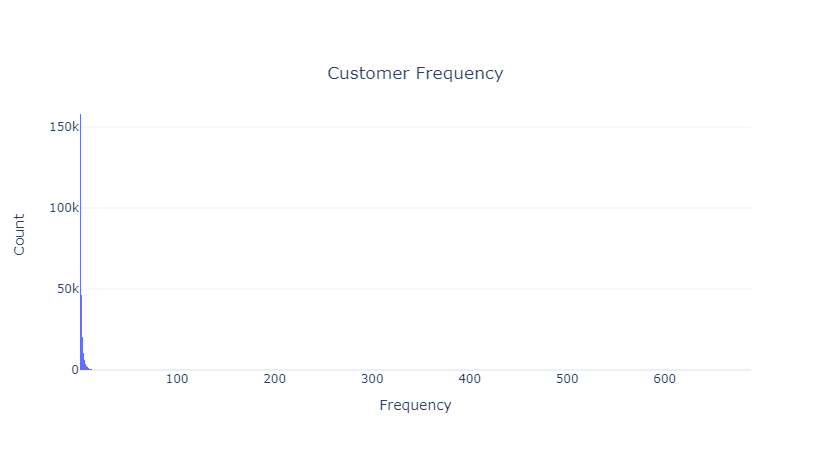

In [112]:
plot_data = [
    go.Histogram(
        x=inv_cust["Frequency"],
    )
]

plot_layout = go.Layout(
    title = {
        "text" : "Customer Frequency",
        "x" : 0.5,
        "y" : 0.85
    },
    xaxis={
        "title" : "Frequency"
    },
    yaxis={
        "title" : "Count"
    },
    template="plotly_white"
)

fig = go.Figure(plot_data, plot_layout)
pyoff.iplot(fig)

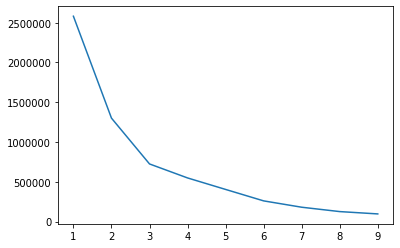

In [113]:
sse = {}

inv_freq = inv_cust[["Frequency"]]

for k in range(1, 10):
    kmean = KMeans(n_clusters=k, max_iter=1000).fit(inv_freq)
    inv_freq["cluster"] = kmean.labels_
    sse[k] = kmean.inertia_
    
plt.plot(list(sse.keys()), list(sse.values()))

In [114]:
kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_cust[["Frequency"]])
inv_cust["Frequency_Cluster"] = kmean.predict(inv_cust[["Frequency"]])

inv_cust = order_cluster("Frequency_Cluster", "Frequency", inv_cust, True)

In [115]:
inv_cust.groupby("Frequency_Cluster")["Frequency"].describe()

,count,mean,std,min,25%,50%,75%,max
Frequency_Cluster,,,,,,,,
0,224902.0,1.385928,0.645677,1.0,1.0,1.0,2.0,3.0
1,27023.0,5.487955,1.751257,4.0,4.0,5.0,6.0,11.0
2,1551.0,17.176015,11.315845,12.0,13.0,14.0,18.0,157.0
3,7.0,429.571429,161.590900,251.0,328.5,360.0,525.5,688.0


In [116]:
inv_rev = invoice_new.groupby('Customer No.')["Total Amt Wtd Tax."].sum().reset_index()
inv_rev.columns = ["Customer No.", "Revenue"]
inv_cust = pd.merge(inv_cust, inv_rev, on="Customer No.")

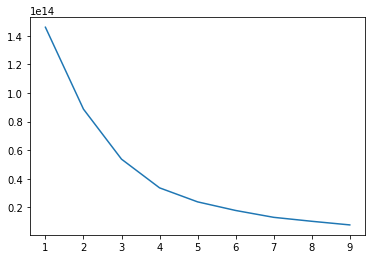

In [117]:
sse = {}

inv_freq = inv_cust[["Revenue"]]

for k in range(1, 10):
    kmean = KMeans(n_clusters=k, max_iter=1000).fit(inv_freq)
    inv_freq["cluster"] = kmean.labels_
    sse[k] = kmean.inertia_
    
plt.plot(list(sse.keys()), list(sse.values()))

In [118]:
kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_cust[["Revenue"]])
inv_cust["Revenue_Cluster"] = kmean.predict(inv_cust[["Revenue"]])

inv_cust = order_cluster("Revenue_Cluster", "Revenue", inv_cust, True)

In [119]:
inv_cust.groupby("Revenue_Cluster")["Revenue"].describe()

,count,mean,std,min,25%,50%,75%,max
Revenue_Cluster,,,,,,,,
0,232772.0,4.314179e+03,5385.540145,-0.01,433.8800,2130.240,6048.470,24355.20
1,19220.0,4.442723e+04,19646.886212,24357.71,29546.7800,37648.125,53332.555,112177.42
2,1471.0,1.803263e+05,79404.869544,112393.49,129359.2950,152600.500,199577.155,657705.63
3,20.0,1.424063e+06,731390.924531,854562.73,918410.6125,1097349.175,1655018.160,3801248.91


In [120]:
inv_cust["OverallScore"] = inv_cust["Recency_Cluster"] + inv_cust["Frequency_Cluster"] + inv_cust["Revenue_Cluster"]

inv_cust.groupby("OverallScore")[["Recency", "Frequency", "Revenue"]].mean()

,Recency,Frequency,Revenue
OverallScore,,,
0,1275.712486,1.287150,3.893606e+03
1,881.538822,1.473081,4.855380e+03
2,487.119649,1.624703,5.863818e+03
3,141.622355,1.609502,5.473126e+03
4,166.128561,4.425770,2.765509e+04
5,142.431273,6.801749,5.951799e+04
6,137.017224,13.382979,1.016271e+05
7,109.268750,26.550000,2.237252e+05
8,66.555556,88.111111,1.367477e+06


In [121]:
inv_cust["Segment"] = "Low-Value"
inv_cust.loc[inv_cust["OverallScore"]>3, "Segment"] = "Mid-Value"
inv_cust.loc[inv_cust["OverallScore"]>6, "Segment"] = "High-Value"

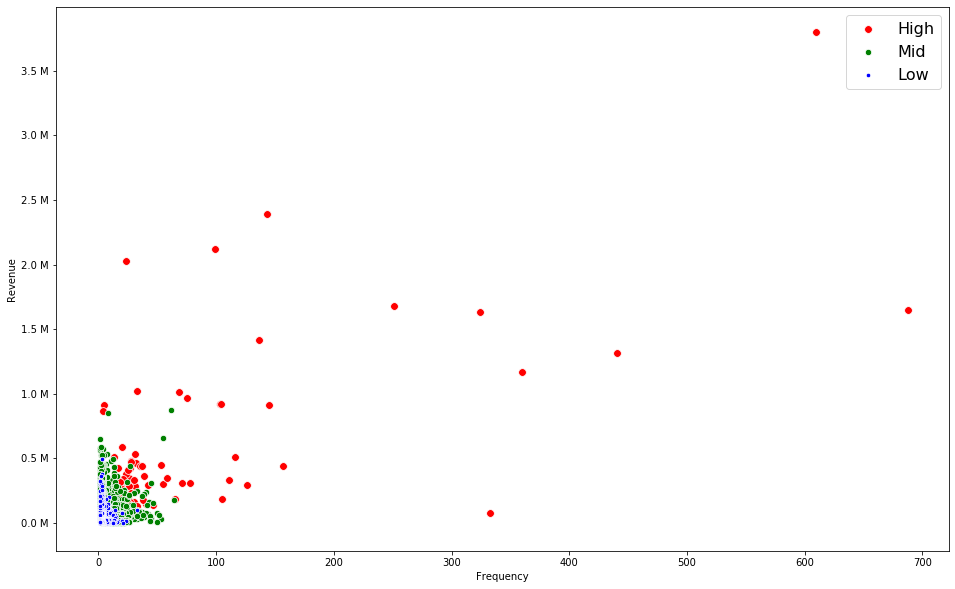

In [462]:
fig = plt.figure(figsize=(16, 10))

sns.scatterplot(x = "Frequency", y = "Revenue", data = inv_cust[(inv_cust["Segment"]=="High-Value") & (inv_cust["Customer No."] != "E4981")], s=60, color="red")
sns.scatterplot(x = "Frequency", y = "Revenue", data = inv_cust[(inv_cust["Segment"]=="Mid-Value") & (inv_cust["Customer No."] != "E4981")], s=40, color="green")
sns.scatterplot(x = "Frequency", y = "Revenue", data = inv_cust[(inv_cust["Segment"]=="Low-Value") & (inv_cust["Customer No."] != "E4981")], s=20, color="blue")

plt.legend(['High', 'Mid', "Low"], prop={'size': 16})

y = plt.yticks()[0][1:-1]
plt.yticks(y, [str(i/1000000)[:]+" M" for i in y])
fig.savefig('Plots\Frequency vs revenue.png', transparent=True)
plt.show()

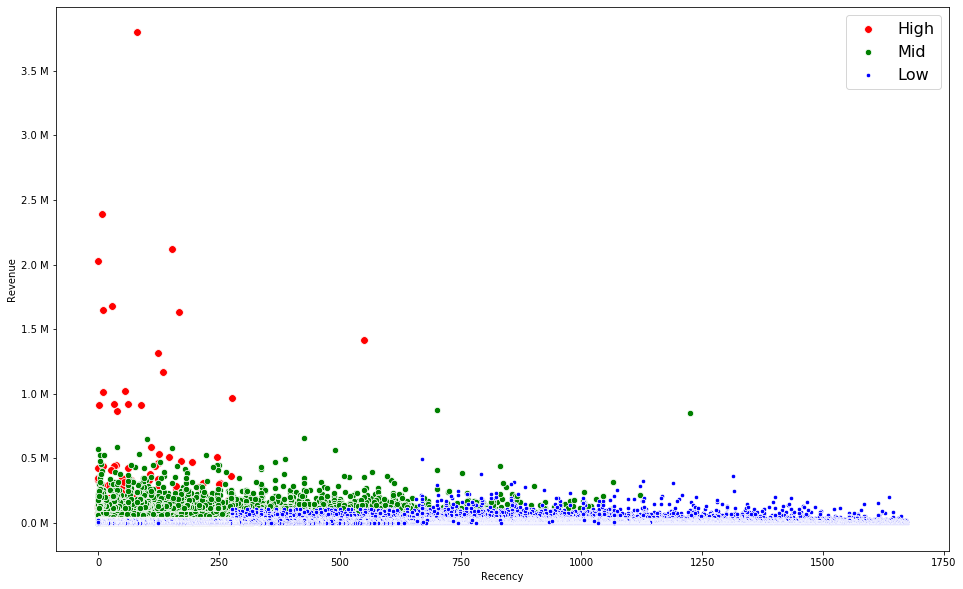

In [123]:
plt.figure(figsize=(16, 10))

sns.scatterplot(x = "Recency", y = "Revenue", data = inv_cust[(inv_cust["Segment"]=="High-Value") & (inv_cust["Customer No."] != "E4981")], s=60, color="red")
sns.scatterplot(x = "Recency", y = "Revenue", data = inv_cust[(inv_cust["Segment"]=="Mid-Value") & (inv_cust["Customer No."] != "E4981")], s=40, color="green")
sns.scatterplot(x = "Recency", y = "Revenue", data = inv_cust[(inv_cust["Segment"]=="Low-Value") & (inv_cust["Customer No."] != "E4981")], s=20, color="blue")

plt.legend(['High', 'Mid', "Low"], prop={'size': 16})

y = plt.yticks()[0][1:-1]
plt.yticks(y, [str(i/1000000)[:]+" M" for i in y])

plt.show()

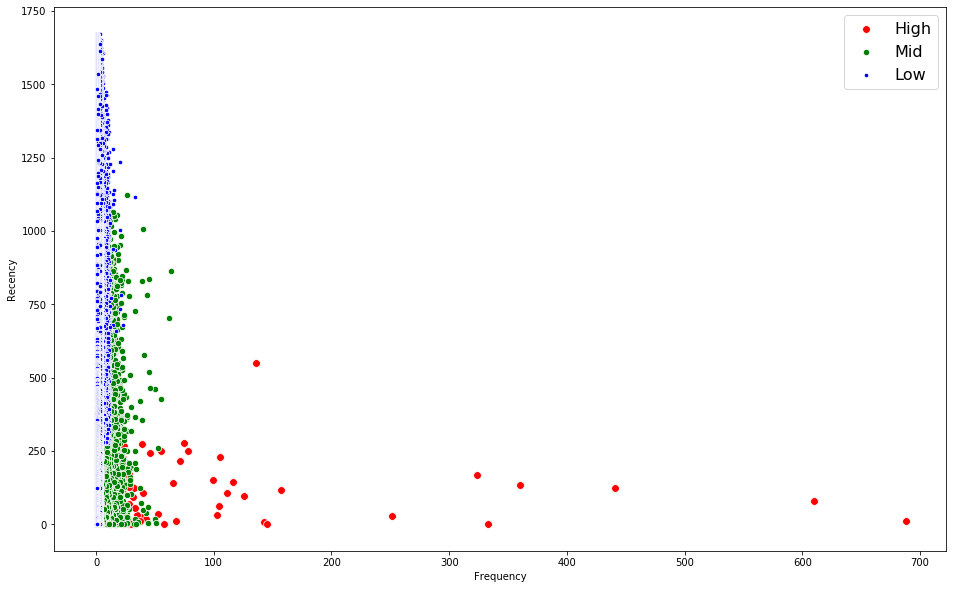

In [124]:
plt.figure(figsize=(16, 10))

sns.scatterplot(x = "Frequency", y = "Recency", data = inv_cust[(inv_cust["Segment"]=="High-Value") & (inv_cust["Customer No."] != "E4981")], s=60, color="red")
sns.scatterplot(x = "Frequency", y = "Recency", data = inv_cust[(inv_cust["Segment"]=="Mid-Value") & (inv_cust["Customer No."] != "E4981")], s=40, color="green")
sns.scatterplot(x = "Frequency", y = "Recency", data = inv_cust[(inv_cust["Segment"]=="Low-Value") & (inv_cust["Customer No."] != "E4981")], s=20, color="blue")

plt.legend(['High', 'Mid', "Low"], prop={'size': 16})

plt.show()

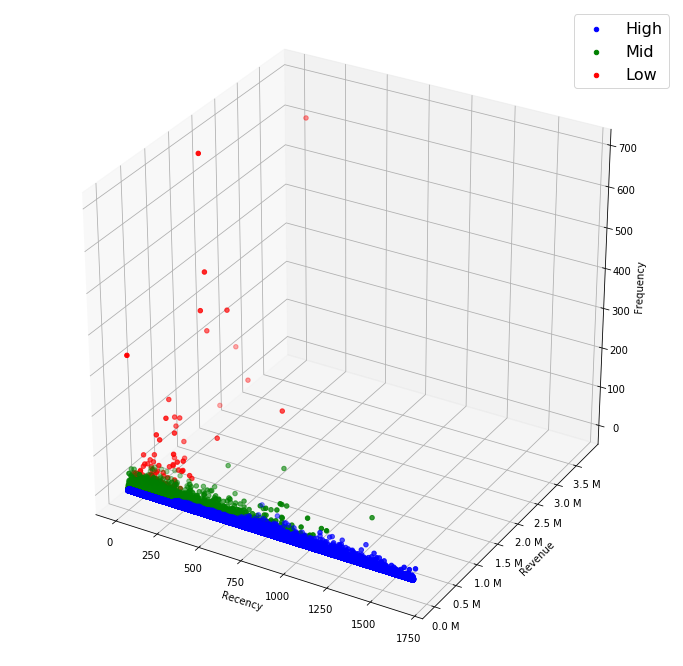

In [464]:
fig = plt.figure(figsize=(12, 12))
ax = fig.add_subplot(111, projection='3d')

x=inv_cust[inv_cust["Segment"]=="Low-Value"]["Recency"]
y=inv_cust[inv_cust["Segment"]=="Low-Value"]["Revenue"]
z=inv_cust[inv_cust["Segment"]=="Low-Value"]["Frequency"]

ax.scatter(x, y, z, color="blue")

x=inv_cust[inv_cust["Segment"]=="Mid-Value"]["Recency"]
y=inv_cust[inv_cust["Segment"]=="Mid-Value"]["Revenue"]
z=inv_cust[inv_cust["Segment"]=="Mid-Value"]["Frequency"]

ax.scatter(x, y, z, color="green")

x=inv_cust[inv_cust["Segment"]=="High-Value"]["Recency"]
y=inv_cust[inv_cust["Segment"]=="High-Value"]["Revenue"]
z=inv_cust[inv_cust["Segment"]=="High-Value"]["Frequency"]

ax.scatter(x, y, z, color="red")
ax.set_xlabel('Recency')
ax.set_ylabel('Revenue')
ax.set_zlabel('Frequency')

y = plt.yticks()[0][1:-1]
plt.yticks(y, [str(i/1000000)[:]+" M" for i in y])
plt.legend(['High', 'Mid', "Low"], prop={'size': 16})
fig.savefig('Plots\RFM.png', transparent=True)
plt.show()

In [126]:
best_cust = invoice_new[invoice_new["Customer No."] == "E4981"]

In [127]:
customer[customer["Customer No."] == "E4981"]

,Business Partner,Customer No.,Partner Type,Data Origin,Title,Marital Status,Occupation,Date of Birth,Death date
554941,E4981,E4981,1.0,Z001,NaN,NaN,NaN,NaN,NaT


In [128]:
best_cust["Regn No"].nunique()

945

In [129]:
inv_1y = invoice.copy()
inv_1y["Invoice Date"] = pd.to_datetime(inv_1y["Invoice Date"])
start = inv_1y["Invoice Date"].max()
# start = inv_1y["Invoice Date"].min()
inv_1y = inv_1y[inv_1y["Invoice Date"]<= start - pd.DateOffset(years=2)]
# inv_1y = inv_1y[inv_1y["Invoice Date"]<= start + pd.DateOffset(years=1)]
inv_2y = invoice.copy()
inv_2y["Invoice Date"] = pd.to_datetime(inv_2y["Invoice Date"])
inv_2y = inv_2y[inv_2y["Invoice Date"] > start - pd.DateOffset(years=2)]
# inv_2y = inv_2y[(inv_2y["Invoice Date"] > start + pd.DateOffset(years=1)) & (inv_2y["Invoice Date"] <= start + pd.DateOffset(years=3))]

In [130]:
inv_cust_new = pd.DataFrame(inv_1y["Customer No."].unique())
inv_cust_new.columns = ["Customer No."]

inv_cust_new = inv_cust_new[inv_cust_new["Customer No."] != 'E4981']

inv_recency = inv_1y.groupby("Customer No.")["Invoice Date"].max().reset_index()
inv_recency.columns = ["Customer No.", "LastPurchaseDate"]
inv_recency["Recency"] = (inv_recency["LastPurchaseDate"].max() - inv_recency["LastPurchaseDate"]).dt.days
inv_cust_new = pd.merge(inv_cust_new, inv_recency[["Customer No.", "Recency"]], on="Customer No.")

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_cust_new[["Recency"]])
inv_cust_new["RecencyCluster"] = kmean.predict(inv_cust_new[["Recency"]])

inv_cust_new = order_cluster("RecencyCluster", "Recency", inv_cust_new, False)

In [131]:
inv_freq = inv_1y.groupby("Customer No.").size().reset_index()
inv_freq.columns = ["Customer No.", "Frequency"]
inv_cust_new = pd.merge(inv_cust_new, inv_freq, on="Customer No.")

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_cust_new[["Frequency"]])
inv_cust_new["FrequencyCluster"] = kmean.predict(inv_cust_new[["Frequency"]])

inv_cust_new = order_cluster("FrequencyCluster", "Frequency", inv_cust_new, True)

In [132]:
inv_rev = inv_1y.groupby("Customer No.")["Total Amt Wtd Tax."].sum().reset_index()
inv_rev.columns=["Customer No.", "Revenue"]
inv_cust_new = pd.merge(inv_cust_new, inv_rev, on="Customer No.")

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_cust_new[["Revenue"]])
inv_cust_new["RevenueCluster"] = kmean.predict(inv_cust_new[["Revenue"]])

inv_cust_new = order_cluster("RevenueCluster", "Revenue", inv_cust_new, True)

In [133]:
inv_cust_new["OverallScore"] = inv_cust_new["RecencyCluster"] + inv_cust_new["FrequencyCluster"] + inv_cust_new["RevenueCluster"]

inv_cust_new["Segment"] = "Low-Value"
inv_cust_new.loc[inv_cust_new["OverallScore"]>2, "Segment"] = "Mid-Value"
inv_cust_new.loc[inv_cust_new["OverallScore"]>6, "Segment"] = "High-Value"

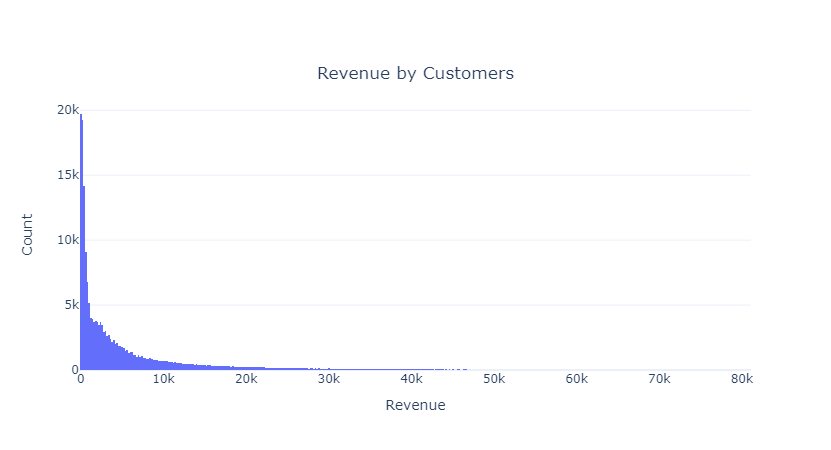

In [134]:
inv_cust_2y = inv_2y.groupby("Customer No.")["Total Amt Wtd Tax."].sum().reset_index()
inv_cust_2y.columns = ["Customer No.", "2yRevenue"]

plot_data = [
    go.Histogram(
        x=inv_cust_2y[inv_cust_2y["2yRevenue"]<inv_cust_2y["2yRevenue"].quantile(0.99)]["2yRevenue"]
    )
]

plot_layout=go.Layout(
    template="plotly_white",
    title={
        "text" : "Revenue by Customers",
        "x" : 0.5,
        "y" : 0.85
    },
    xaxis={
        "title" : "Revenue"
    },
    yaxis={
        "title" : "Count"
    }
)

fig = go.Figure(plot_data, plot_layout)
pyoff.iplot(fig)

In [135]:
inv_merge = pd.merge(inv_cust_new, inv_cust_2y, on="Customer No.", how="left")
inv_merge = inv_merge.fillna(0)

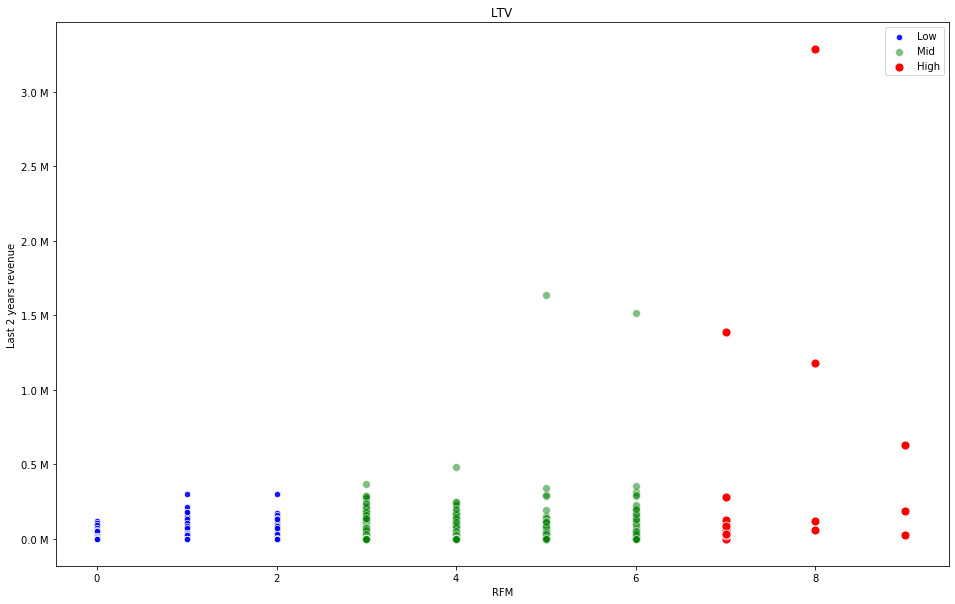

In [136]:
plt.figure(figsize=(16,10))

sns.scatterplot(x=inv_merge.query("Segment == 'Low-Value'")["OverallScore"], y=inv_merge.query("Segment == 'Low-Value'")["2yRevenue"], color="blue", s=40, alpha=0.9)
sns.scatterplot(x=inv_merge.query("Segment == 'Mid-Value'")["OverallScore"], y=inv_merge.query("Segment == 'Mid-Value'")["2yRevenue"], color="green", s=60, alpha=0.5)
sns.scatterplot(x=inv_merge.query("Segment == 'High-Value'")["OverallScore"], y=inv_merge.query("Segment == 'High-Value'")["2yRevenue"], color="red", s=80, alpha=1)

plt.legend(["Low", "Mid", "High"])
plt.title("LTV")
plt.xlabel("RFM")
plt.ylabel("Last 2 years revenue")

y = plt.yticks()[0][1:-1]
plt.yticks(y, [str(i/1000000)[:]+" M" for i in y])

plt.show()

In [137]:
kmean = KMeans(n_clusters=3, max_iter=1000)
kmean.fit(inv_merge[["2yRevenue"]])
inv_merge["LTVCluster"] = kmean.predict(inv_merge[["2yRevenue"]])

inv_merge = order_cluster("LTVCluster", "2yRevenue", inv_merge, True)

In [559]:
inv_cust_2y = inv_2y.groupby("Customer No.")["Total Amt Wtd Tax."].sum().reset_index()
inv_cust_2y.columns = ["Customer No.", "2yRevenue"]
inv_merge = pd.merge(inv_cust_new, inv_cust_2y, on="Customer No.", how="left")
inv_merge = inv_merge.fillna(0)
inv_merge["LTVCluster"] = 0
inv_merge.loc[inv_merge["Revenue"] > inv_merge["Revenue"].quantile(0.5), "LTVCluster"] = 1

In [533]:
kmean = KMeans(n_clusters=2, max_iter=1000)
kmean.fit(inv_merge[["Revenue"]])
inv_merge["LTVCluster"] = kmean.predict(inv_merge[["2yRevenue"]])

inv_merge = order_cluster("LTVCluster", "Revenue", inv_merge, True)

In [562]:
inv_merge["LTVCluster"].value_counts()

1    38173
0    38173
Name: LTVCluster, dtype: int64

In [563]:
inv_class = inv_merge.join(pd.get_dummies(inv_merge["Segment"])).drop(columns="Segment")

In [564]:
corr_mat = inv_class.corr().abs()

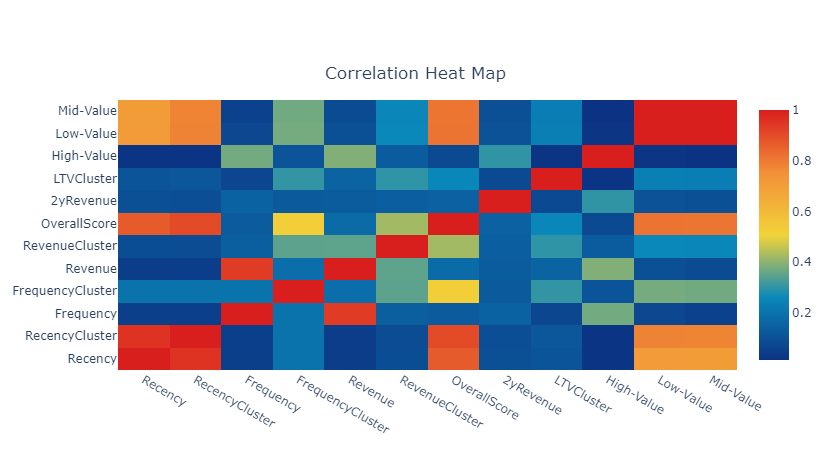

In [565]:
plot_data = [
    go.Heatmap(x=corr_mat.columns, y=corr_mat.columns, z=corr_mat, colorscale='Portland')
]

plot_layout = go.Layout(
    title = {
        "text" : "Correlation Heat Map",
        "x" : 0.5,
        "y" : 0.85
    }
)

fig = go.Figure(plot_data, plot_layout)
pyoff.iplot(fig)

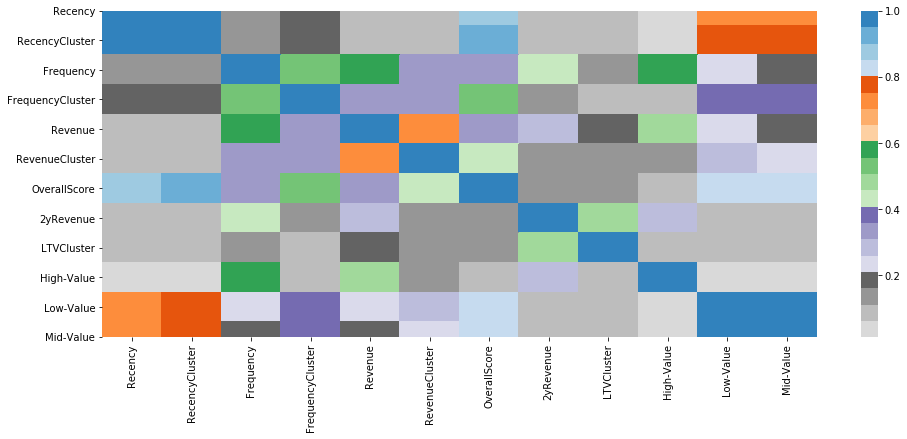

In [142]:
plt.figure(figsize=(16,6))
sns.heatmap(corr_mat, cmap='tab20c_r')

In [566]:
corr_mat['LTVCluster'].sort_values(ascending=False)

LTVCluster          1.000000
FrequencyCluster    0.304184
RevenueCluster      0.300026
OverallScore        0.257997
Low-Value           0.233482
Mid-Value           0.232895
Revenue             0.154235
RecencyCluster      0.118471
Recency             0.110911
2yRevenue           0.081021
Frequency           0.070089
High-Value          0.017359
Name: LTVCluster, dtype: float64

In [597]:
x = inv_class.drop(columns=["Customer No.", "LTVCluster", "Revenue", "2yRevenue"])
y = inv_class["LTVCluster"]

In [599]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.1, random_state=42)

In [600]:
xgbModel = xgb.XGBClassifier(max_depth=3, learning_rate=0.1)
xgbModel.fit(X_train, y_train)

print('Accuracy of XGB classifier on training set: {:.2f}'
       .format(xgbModel.score(X_train, y_train)))
print('Accuracy of XGB classifier on test set: {:.2f}'
       .format(xgbModel.score(X_test, y_test)))

y_pred = xgbModel.predict(X_test)
print(classification_report(y_test, y_pred))

Accuracy of XGB classifier on training set: 1.00
Accuracy of XGB classifier on test set: 1.00
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3836
           1       1.00      1.00      1.00      3799

    accuracy                           1.00      7635
   macro avg       1.00      1.00      1.00      7635
weighted avg       1.00      1.00      1.00      7635



In [520]:
X_test.shape, y_test.shape, y_pred.shape

((7635, 10), (7635,), (7635,))

In [530]:
ltv_final = X_test.join(y_test).join(pd.Series(np.round(y_pred), name="LTV_predict"))

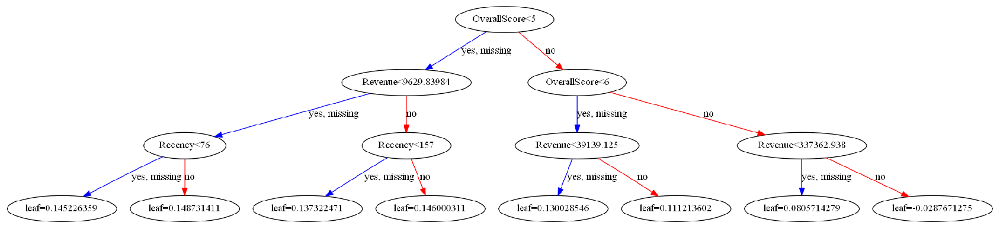

In [149]:
xgb.plot_tree(xgbModel)
fig = plt.gcf()
fig.set_size_inches(30, 20)
plt.show()

## Churn Prediction

In [150]:
invoice_chrun = invoice.copy()
invoice_chrun["Invoice Date"] = pd.to_datetime(invoice_chrun["Invoice Date"])
invoice_chrun = invoice_chrun.sort_values(["Customer No.", "Invoice Date"])
invoice_chrun["Diff"] = invoice_chrun.groupby("Customer No.")["Invoice Date"].apply(lambda x: x.diff())

In [151]:
invoice_chrun["Diff"].describe()

count                      238830
mean      96 days 12:19:37.902274
std      134 days 04:42:06.413084
min               0 days 00:00:00
25%               9 days 00:00:00
50%              50 days 00:00:00
75%             132 days 00:00:00
max            1623 days 00:00:00
Name: Diff, dtype: object

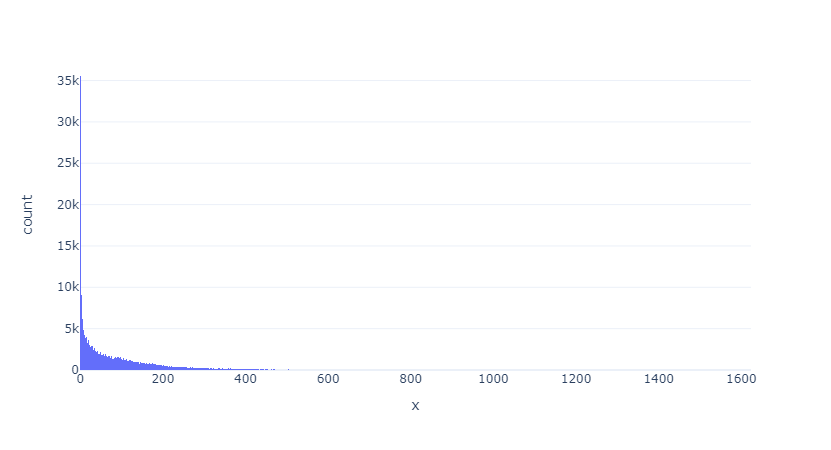

In [152]:
px.histogram(x=invoice_chrun["Diff"].dt.days, template="plotly_white")

(array([1.92405e+05, 3.24630e+04, 8.81500e+03, 2.79400e+03, 1.23300e+03,
        5.86000e+02, 3.05000e+02, 1.40000e+02, 6.90000e+01, 2.00000e+01]),
 array([   0. ,  162.3,  324.6,  486.9,  649.2,  811.5,  973.8, 1136.1,
        1298.4, 1460.7, 1623. ]),
 <a list of 10 Patch objects>)

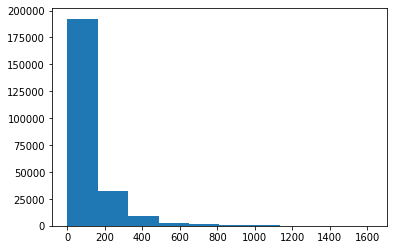

In [153]:
plt.hist(invoice_chrun["Diff"].dt.days)

In [154]:
inv_past = invoice.copy()
inv_past["Invoice Date"] = pd.to_datetime(inv_past["Invoice Date"])
sep = inv_past["Invoice Date"].max() - pd.DateOffset(years=1)
inv_past = inv_past[inv_past["Invoice Date"]<= sep]
inv_fu = invoice.copy()
inv_fu["Invoice Date"] = pd.to_datetime(inv_fu["Invoice Date"])
inv_fu = inv_fu[inv_fu["Invoice Date"] > sep]

In [155]:
inv_chu = pd.DataFrame(inv_fu["Customer No."].drop_duplicates())
inv_chu["Churn"] = 0
inv_chu.head()

,Customer No.,Churn
99838,51425,0
99839,11504,0
99840,E13225,0
99841,133693,0
99842,105963,0


In [156]:
inv_past = pd.merge(inv_past, inv_chu, on="Customer No.", how="left")

In [157]:
inv_past["Churn"].value_counts()

0.0    67797
Name: Churn, dtype: int64

In [158]:
inv_past.shape, inv_fu.shape

((270147, 59), (222167, 58))

In [159]:
inv_past["Churn"] = inv_past["Churn"].fillna(1)

In [160]:
inv_past["Churn"].value_counts()

1.0    202350
0.0     67797
Name: Churn, dtype: int64

In [161]:
data.columns

Index(['Partner Type', 'Data Origin', 'CITY', 'Cust Type', 'District',
       'Gate Pass Time', 'Invoice Date', 'Invoice Time', 'JobCard Date',
       'JobCard Time', 'KMs Reading', 'Make', 'Model', 'Order Type', 'Plant',
       'Print Status', 'Recovrbl Exp', 'Total Amt Wtd Tax.', 'Item Category'],
      dtype='object')

In [162]:
inv_past.head()

,Amt Rcvd From Custom,Amt Rcvd From Ins Co,Area / Locality,CGST(14%),CGST(2.5%),CGST(6%),CGST(9%),CITY,Cash /Cashless Type,Claim No.,Cust Type,Customer No.,District,Expiry Date,Gate Pass Date,Gate Pass Time,IGST(12%),IGST(18%),IGST(28%),IGST(5%),Insurance Company,Invoice Date,Invoice No,Invoice Time,Job Card No,JobCard Date,JobCard Time,KMs Reading,Labour Total,Make,Misc Total,Model,ODN No.,OSL Total,Order Type,Outstanding Amt,Parts Total,Pin code,Plant,Plant Name1,Policy no.,Print Status,Recovrbl Exp,Regn No,SGST/UGST(14%),SGST/UGST(2.5%),SGST/UGST(6%),SGST/UGST(9%),Service Advisor Name,TDS amount,Technician Name,Total Amt Wtd Tax.,Total CGST,Total GST,Total IGST,Total SGST/UGST,Total Value,User ID,Churn
0,0.0,0.0,MAJIWADA,0.0,0.0,0.0,0.0,Thane,NaN,NaN,Retail,67849,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-02,7005200002,11:30:36,168303,2014-12-13,14:29:43,49317,1203.14,GENERAL MOTORS,0.00,SPARK,7.005200e+09,500.06,Paid Service,0.0,2348.75,400601,BC01,THANE,NaN,NO,0.0,KA19MA1291,0.0,0.0,0.0,0.0,NaN,0.0,RUPESH,4051.95,0.0,0.0,0.0,0.0,4051.95,BC01FS1,1.0
1,0.0,0.0,THNAE,0.0,0.0,0.0,0.0,THNAE,NaN,NaN,Retail,84419,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200003,10:07:32,173997,2015-01-02,14:12:18,78584,804.26,TATA MOTORS,197.03,INDICA,7.005200e+09,0.00,SMC Value Package,0.0,0.00,400603,BC01,THANE,NaN,NO,0.0,MH43R3046,0.0,0.0,0.0,0.0,NaN,0.0,PRASHANT,1001.29,0.0,0.0,0.0,0.0,1001.29,BC01SA2,0.0
2,0.0,0.0,THANE,0.0,0.0,0.0,0.0,THANE[W],NaN,NaN,Retail,81055,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200004,11:12:57,173889,2015-01-02,11:40:44,33985,180.19,MARUTI SUZUKI,0.00,ZEN,7.005200e+09,0.00,Running Repairs,0.0,52.95,400607,BC01,THANE,NaN,NO,0.0,AP09AX0582,0.0,0.0,0.0,0.0,NaN,0.0,IMRAN,233.14,0.0,0.0,0.0,0.0,233.14,BC01SA2,0.0
3,0.0,0.0,THNAE,0.0,0.0,0.0,0.0,THNAE,NaN,NaN,Retail,84419,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200005,11:40:44,174158,2015-01-03,10:12:32,78584,0.00,TATA MOTORS,0.00,INDICA,7.005200e+09,0.00,SMC Redemption,0.0,0.00,400603,BC01,THANE,NaN,NO,0.0,MH43R3046,0.0,0.0,0.0,0.0,NaN,0.0,PRASHANT,0.00,0.0,0.0,0.0,0.0,0.00,BC01SA2,0.0
4,0.0,0.0,THANE,0.0,0.0,0.0,0.0,THANE,NaN,NaN,Retail,18980,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200006,12:07:17,173860,2015-01-02,10:45:42,50057,1202.97,HYUNDAI,100.00,SANTRO XING,7.005200e+09,499.99,Paid Service,0.0,944.16,400603,BC01,THANE,NaN,NO,0.0,MH04CD9768,0.0,0.0,0.0,0.0,NaN,0.0,DAYANAND,2747.12,0.0,0.0,0.0,0.0,2747.12,BC01SA2,0.0


In [163]:
cust_city = inv_past.groupby(["Customer No."])["CITY"].nunique().reset_index()
cust_city[cust_city["CITY"]>1]

,Customer No.,CITY


In [164]:
cust_city = inv_past.groupby(["Customer No."])["District"].nunique().reset_index()
cust_city[cust_city["District"]>1]

,Customer No.,District


In [165]:
cust_chur = customer.copy()
cust_chur.drop(columns=["Title", "Marital Status", "Occupation", "Date of Birth", "Death date", "Business Partner"], inplace = True)
cust_chur.head()

,Customer No.,Partner Type,Data Origin
0,1,1.0,Z001
1,2,1.0,Z005
2,4,1.0,Z005
3,5,1.0,Z005
4,7,1.0,Z008


In [166]:
cust_city = inv_past[["Customer No.", "CITY", "District"]].drop_duplicates()
cust_city.shape, cust_chur.shape

((131297, 3), (555338, 3))

In [167]:
cust_chur = pd.merge(cust_chur, cust_city, on="Customer No.", how="right")

In [168]:
cust_city = inv_past.groupby(["Customer No."])["Cust Type"].unique().reset_index()
cust_city[cust_city["Cust Type"].apply(lambda x: len(x)>1)].head()

,Customer No.,Cust Type
35844,1376,"[Retail, Fleets]"
36088,13987,"[Retail, Fleets]"
44671,22016,"[Retail, Corporate others]"
127815,E11111,"[Corporate others, Retail]"
127816,E11112,"[Retail, Corporate others]"


In [169]:
cust_city["Cust Type"] = cust_city["Cust Type"].apply(lambda x: x[-1])

In [170]:
cust_chur = pd.merge(cust_chur, cust_city, on="Customer No.", how="left")

In [171]:
cust_car_count = inv_past.groupby("Customer No.")["ODN No."].nunique().reset_index()
cust_car_count.columns = ["Customer No.", "Car Count"]
cust_car_count.head()

,Customer No.,Car Count
0,1,4
1,10,5
2,100,2
3,1000,6
4,10000,7


In [172]:
cust_chur = pd.merge(cust_chur, cust_car_count, on="Customer No.", how="left")

In [173]:
best_car = cust_chur[cust_chur["Customer No."] == 'E4981']
cust_chur = cust_chur[cust_chur["Customer No."] != 'E4981']

In [174]:
inv_recency = inv_past.groupby("Customer No.")["Invoice Date"].max().reset_index()
inv_recency.columns = ["Customer No.", "LastPurchaseDate"]
inv_recency["Recency"] = (inv_recency["LastPurchaseDate"].max() - inv_recency["LastPurchaseDate"]).dt.days
cust_chur = pd.merge(cust_chur, inv_recency[["Customer No.", "Recency"]], on="Customer No.", how = "left")

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(cust_chur[["Recency"]])
cust_chur["RecencyCluster"] = kmean.predict(cust_chur[["Recency"]])

cust_chur = order_cluster("RecencyCluster", "Recency", cust_chur, False)

In [175]:
inv_freq = inv_past.groupby("Customer No.").size().reset_index()
inv_freq.columns = ["Customer No.", "Frequency"]
cust_chur = pd.merge(cust_chur, inv_freq, on="Customer No.", how="left")

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(cust_chur[["Frequency"]])
cust_chur["FrequencyCluster"] = kmean.predict(cust_chur[["Frequency"]])

cust_chur = order_cluster("FrequencyCluster", "Frequency", cust_chur, True)

In [176]:
inv_rev = inv_past.groupby("Customer No.")["Total Amt Wtd Tax."].sum().reset_index()
inv_rev.columns=["Customer No.", "Revenue"]
cust_chur = pd.merge(cust_chur, inv_rev, on="Customer No.", how="left")

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(cust_chur[["Revenue"]])
cust_chur["RevenueCluster"] = kmean.predict(cust_chur[["Revenue"]])

cust_chur = order_cluster("RevenueCluster", "Revenue", cust_chur, True)

In [177]:
cust_chur["OverallScore"] = cust_chur["RecencyCluster"] + cust_chur["FrequencyCluster"] + cust_chur["RevenueCluster"]

In [178]:
cust_chur["Segment"] = "Low-Value"
cust_chur.loc[cust_chur["OverallScore"]>2, "Segment"] = "Mid-Value"
cust_chur.loc[cust_chur["OverallScore"]>6, "Segment"] = "High-Value"

In [179]:
cust_chur = pd.merge(cust_chur, inv_chu, on="Customer No.", how="left")

In [180]:
cust_chur.Churn = cust_chur.Churn.fillna(1)

In [181]:
cust_chur.drop(columns=["Partner Type", "Data Origin"], inplace=True)

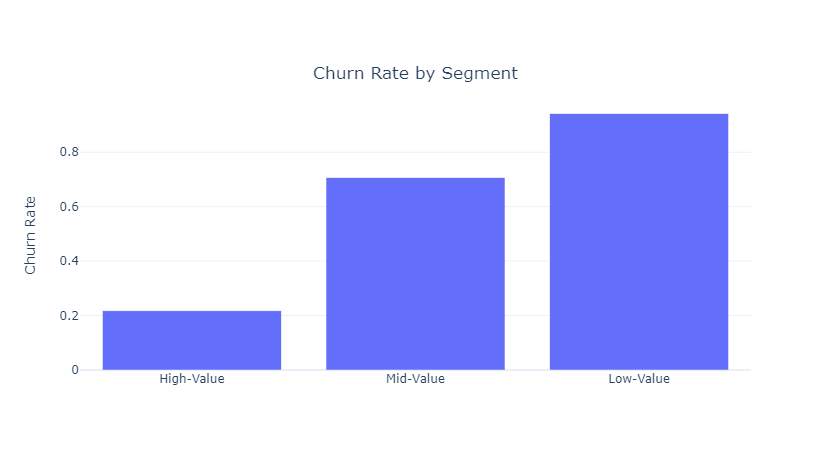

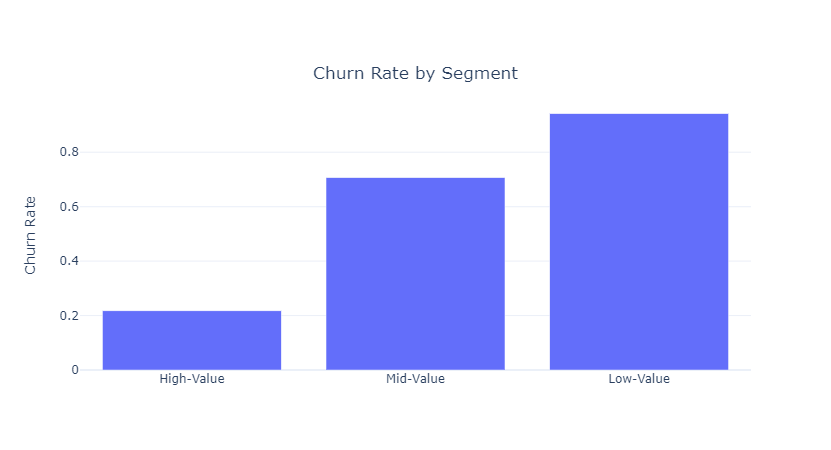

In [466]:
chur_rate_segment = cust_chur.groupby("Segment")["Churn"].mean().reset_index().sort_values("Churn")

plot_data=[
    go.Bar(
        x = chur_rate_segment["Segment"],
        y = chur_rate_segment["Churn"],
    )
]

plot_layout = go.Layout(
    title = {
        "text" : "Churn Rate by Segment",
        "x" : 0.5,
        "y" : 0.85
    },
    yaxis = { "title" : "Churn Rate"},
    template="plotly_white"
)

fig = go.Figure(plot_data, plot_layout)
pyoff.iplot(fig)
save_fig(fig, name="Churn rate from each segment")

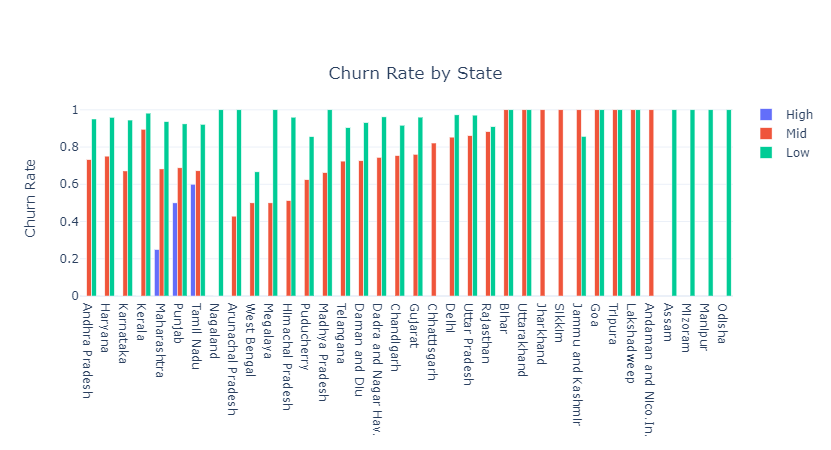

In [183]:
chur_rate_district_high = cust_chur[cust_chur["Segment"] == "High-Value"].groupby("District")["Churn"].mean().reset_index().sort_values("Churn")
chur_rate_district_mid = cust_chur[cust_chur["Segment"] == "Mid-Value"].groupby("District")["Churn"].mean().reset_index().sort_values("Churn")
chur_rate_district_low = cust_chur[cust_chur["Segment"] == "Low-Value"].groupby("District")["Churn"].mean().reset_index().sort_values("Churn")

plot_data=[
    go.Bar(
        x = chur_rate_district_high["District"],
        y = chur_rate_district_high["Churn"],
        name = "High"
    ),
    go.Bar(
        x = chur_rate_district_mid["District"],
        y = chur_rate_district_mid["Churn"],
        name = "Mid"
    ),
    go.Bar(
        x = chur_rate_district_low["District"],
        y = chur_rate_district_low["Churn"],
        name = "Low"
    )
]

plot_layout = go.Layout(
    title = {
        "text" : "Churn Rate by State",
        "x" : 0.5,
        "y" : 0.85
    },
    yaxis = { "title" : "Churn Rate"},
    template="plotly_white"
)

fig = go.Figure(plot_data, plot_layout)
pyoff.iplot(fig)

In [184]:
cust_chur.drop(columns="CITY", inplace=True)

In [185]:
corr_mat = cust_chur.corr().abs()
corr_mat[corr_mat>0.75]

,Car Count,Recency,RecencyCluster,Frequency,FrequencyCluster,Revenue,RevenueCluster,OverallScore,Churn
Car Count,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN
Recency,NaN,1.000000,0.960724,NaN,NaN,NaN,NaN,0.870954,NaN
RecencyCluster,NaN,0.960724,1.000000,NaN,NaN,NaN,NaN,0.902030,NaN
Frequency,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN
FrequencyCluster,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN
Revenue,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN
RevenueCluster,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN
OverallScore,NaN,0.870954,0.902030,NaN,NaN,NaN,NaN,1.000000,NaN
Churn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0


In [186]:
corr_mat["Churn"]

Car Count           0.123635
Recency             0.323697
RecencyCluster      0.316952
Frequency           0.123635
FrequencyCluster    0.164339
Revenue             0.077246
RevenueCluster      0.076732
OverallScore        0.330264
Churn               1.000000
Name: Churn, dtype: float64

In [187]:
x = pd.get_dummies(cust_chur.drop(columns = ["Customer No.", "Churn"]))
y = cust_chur["Churn"]

In [188]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.1, random_state=42)

In [189]:
xgbModel = xgb.XGBClassifier(max_depth=5, learning_rate=0.1)
xgbModel.fit(X_train, y_train)

print('Accuracy of XGB classifier on training set: {:.2f}'
       .format(xgbModel.score(X_train, y_train)))
print('Accuracy of XGB classifier on test set: {:.2f}'
       .format(xgbModel.score(X_test, y_test)))

y_pred = xgbModel.predict(X_test)
print(classification_report(y_test, y_pred))

Accuracy of XGB classifier on training set: 0.85
Accuracy of XGB classifier on test set: 0.84
              precision    recall  f1-score   support

         0.0       0.59      0.20      0.30      2182
         1.0       0.86      0.97      0.91     10948

    accuracy                           0.84     13130
   macro avg       0.72      0.59      0.60     13130
weighted avg       0.81      0.84      0.81     13130



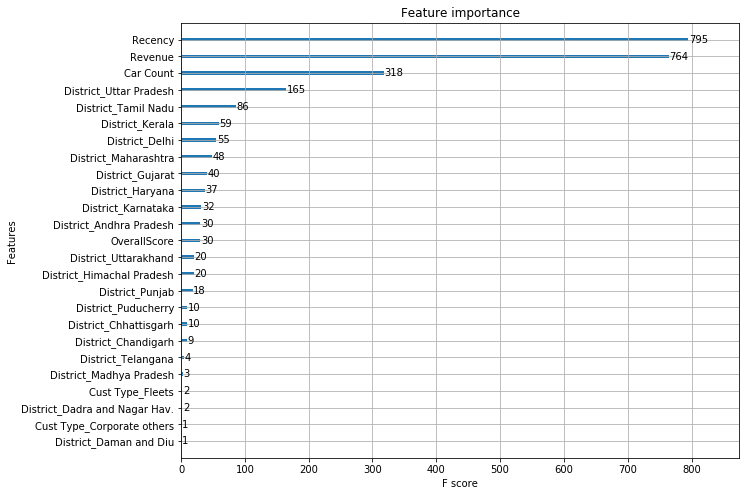

In [190]:
fig, ax = plt.subplots(figsize=(10,8))
xgb.plot_importance(xgbModel, ax=ax)

## Next Service Date

In [191]:
inv_behav = invoice.copy()
inv_behav["Invoice Date"] = pd.to_datetime(inv_behav["Invoice Date"])
inv_behav = inv_behav[(inv_behav["Invoice Date"] <= (inv_behav["Invoice Date"].max() - pd.DateOffset(years=1))) & (inv_behav["Invoice Date"] > (inv_behav["Invoice Date"].max() - pd.DateOffset(years=3)))]
inv_fu = invoice.copy()
inv_fu["Invoice Date"] = pd.to_datetime(inv_fu["Invoice Date"])
inv_fu = inv_fu[(inv_fu["Invoice Date"] > (inv_fu["Invoice Date"].max() - pd.DateOffset(years=1)))]

In [192]:
inv_cust[(inv_cust["Segment"]=="High-Value")]["Frequency"].describe()

count    175.000000
mean      44.085714
std       88.849211
min        4.000000
25%       14.000000
50%       18.000000
75%       28.000000
max      688.000000
Name: Frequency, dtype: float64

In [193]:
inv_cust[(inv_cust["Segment"]=="Mid-Value")]["Frequency"].describe()

count    23142.000000
mean         5.312721
std          3.741402
min          1.000000
25%          3.000000
50%          4.000000
75%          6.000000
max         64.000000
Name: Frequency, dtype: float64

In [194]:
inv_next_cust = inv_behav[["Customer No.", "Regn No"]].drop_duplicates().dropna().sort_values(["Regn No", "Customer No."])

inv_fir_fu = inv_fu.groupby(["Customer No.", "Regn No"])["Invoice Date"].min().reset_index()
inv_fir_fu.columns = ['Customer No.', "Regn No",'MinPurchaseDate']
inv_last_behav = inv_behav.groupby(["Customer No.", "Regn No"])["Invoice Date"].max().reset_index()
inv_last_behav.columns = ['Customer No.', "Regn No",'MaxPurchaseDate']

In [195]:
inv_next_ser = pd.merge(inv_last_behav, inv_fir_fu, on=["Customer No.", "Regn No"], how="left")
inv_next_ser["NextServiceDays"] = (inv_next_ser["MinPurchaseDate"] - inv_next_ser["MaxPurchaseDate"]).dt.days
inv_next_cust = pd.merge(inv_next_cust, inv_next_ser[["Customer No.", "Regn No", "NextServiceDays"]], on=["Customer No.", "Regn No"], how="left")
inv_next_cust = inv_next_cust.fillna(9999)

In [196]:
end = inv_behav["Invoice Date"].max()
cust_res = inv_behav.groupby(["Customer No.", "Regn No"])["Invoice Date"].max().reset_index()
cust_res.columns = ["Customer No.", "Regn No", "LastService"]
cust_res["Recency"] = (end - cust_res["LastService"]).dt.days
inv_next_cust = pd.merge(inv_next_cust, cust_res[["Customer No.", "Regn No", "Recency"]], on=["Customer No.", "Regn No"], how="left")

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_next_cust[["Recency"]])
inv_next_cust["RecencyCluster"] = kmean.predict(inv_next_cust[["Recency"]])
inv_next_cust = order_cluster("RecencyCluster", "Recency", inv_next_cust, False)

In [197]:
cust_fre = inv_behav.groupby(["Customer No.", "Regn No"]).size().reset_index()
cust_fre.columns = ["Customer No.", "Regn No", "Frequency"]
inv_next_cust = pd.merge(inv_next_cust, cust_fre, on=["Customer No.", "Regn No"], how="left")

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_next_cust[["Frequency"]])
inv_next_cust["FrequencyCluster"] = kmean.predict(inv_next_cust[["Frequency"]])
inv_next_cust = order_cluster("FrequencyCluster", "Recency", inv_next_cust, True)

In [198]:
cust_rev = inv_behav.groupby(["Customer No.", "Regn No"])["Total Amt Wtd Tax."].sum().reset_index()
cust_rev.columns = ["Customer No.", "Regn No", "Revenue"]
inv_next_cust = pd.merge(inv_next_cust, cust_rev, on=["Customer No.", "Regn No"], how="left")

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_next_cust[["Revenue"]])
inv_next_cust["RevenueCluster"] = kmean.predict(inv_next_cust[["Revenue"]])
inv_next_cust = order_cluster("RevenueCluster", "Revenue", inv_next_cust, True)

In [199]:
inv_next_cust["OverallScore"] = inv_next_cust["RecencyCluster"] + inv_next_cust["FrequencyCluster"] + inv_next_cust["RevenueCluster"]

In [200]:
inv_next_cust['Segment'] = 'Low-Value'
inv_next_cust.loc[inv_next_cust['OverallScore']>2,'Segment'] = 'Mid-Value' 
inv_next_cust.loc[inv_next_cust['OverallScore']>6,'Segment'] = 'High-Value' 

In [201]:
inv_days = inv_behav.sort_values(["Regn No", "Customer No.", "Invoice Date"])[["Regn No", "Customer No.", "Invoice Date"]]
inv_days = inv_days.drop_duplicates(subset=["Regn No", "Customer No.", "Invoice Date"],keep='first')

In [202]:
inv_days['PrevInvoiceDate'] = inv_days.groupby(["Customer No.", "Regn No"])['Invoice Date'].shift(1)
inv_days['T2InvoiceDate'] = inv_days.groupby(["Customer No.", "Regn No"])['Invoice Date'].shift(2)

In [203]:
inv_days['DayDiff'] = (inv_days['Invoice Date'] - inv_days['PrevInvoiceDate']).dt.days
inv_days['DayDiff2'] = (inv_days['Invoice Date'] - inv_days['T2InvoiceDate']).dt.days

In [204]:
inv_days_diff = inv_days.groupby(["Customer No.", "Regn No"]).agg({'DayDiff': ['mean','std']}).reset_index()
inv_days_diff.columns = ['Customer No.', "Regn No", 'DayDiffMean','DayDiffStd']

In [205]:
inv_days_last = inv_days.drop_duplicates(subset=["Customer No.", "Regn No"],keep='last')

In [206]:
inv_days_last = inv_days_last.dropna()
inv_days_last = pd.merge(inv_days_last, inv_days_diff, on=["Customer No.", "Regn No"])

In [207]:
inv_next_cust = pd.merge(inv_next_cust, inv_days_last[['Customer No.', "Regn No",'DayDiff','DayDiff2','DayDiffMean','DayDiffStd']], on=["Customer No.", "Regn No"])

In [208]:
inv_next_cust[inv_next_cust["NextServiceDays"]!=9999]["NextServiceDays"].describe()

count    6526.000000
mean      204.968894
std       140.356417
min         2.000000
25%       102.000000
50%       173.500000
75%       273.000000
max       959.000000
Name: NextServiceDays, dtype: float64

In [209]:
inv_next_cust[inv_next_cust["NextServiceDays"]!=9999]["NextServiceDays"].quantile(0.375)

137.0

In [210]:
inv_next_cust['NextServiceDayRange'] = 2
inv_next_cust.loc[inv_next_cust.NextServiceDays>140,'NextServiceDayRange'] = 1
inv_next_cust.loc[inv_next_cust.NextServiceDays>280,'NextServiceDayRange'] = 0
inv_next_cust.loc[inv_next_cust.NextServiceDays==9999,'NextServiceDayRange'] = 3

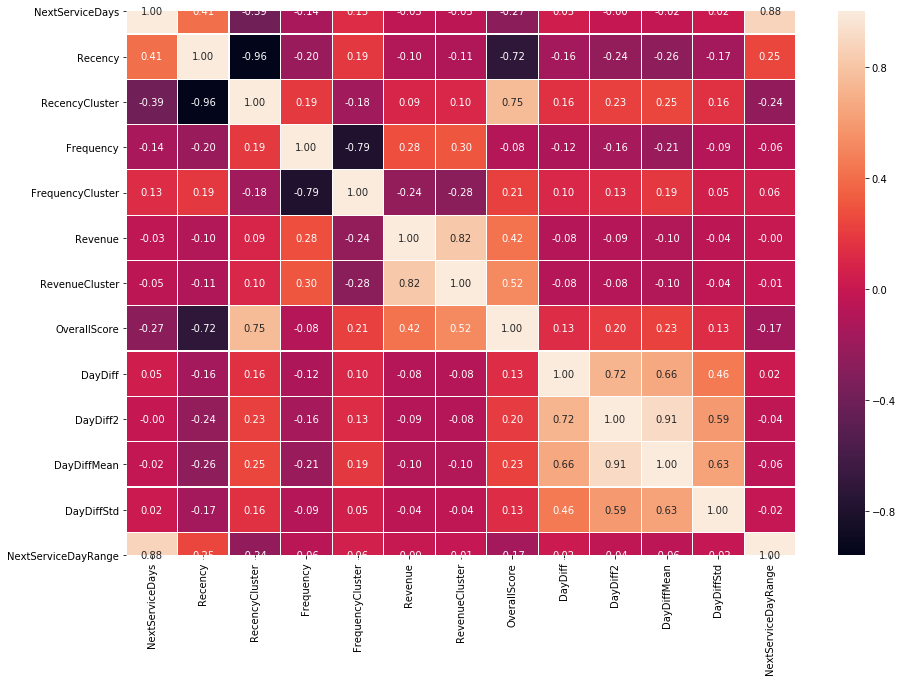

In [211]:
corr = inv_next_cust[inv_next_cust.columns].corr()
plt.figure(figsize = (15,10))
sns.heatmap(corr, annot = True, linewidths=0.2, fmt=".2f")

In [212]:
X = pd.get_dummies(inv_next_cust.drop(columns=["Customer No.", "Regn No", "NextServiceDays", "NextServiceDayRange"]))
y = inv_next_cust["NextServiceDayRange"]

In [213]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=44)

In [214]:
models = []
models.append(("LR",LogisticRegression()))
models.append(("NB",GaussianNB()))
models.append(("RF",RandomForestClassifier()))
models.append(("SVC",SVC()))
models.append(("Dtree",DecisionTreeClassifier()))
models.append(("XGB",xgb.XGBClassifier()))
models.append(("KNN",KNeighborsClassifier()))

In [215]:
for name,model in models:
    kfold = KFold(n_splits=2, random_state=22)
    cv_result = cross_val_score(model,X_train,y_train, cv = kfold,scoring = "accuracy")
    print(name, cv_result)

LR [0.69045772 0.67597621]
NB [0.58637186 0.58313938]
RF [0.63822084 0.63343677]
SVC [0.66640807 0.65606413]
Dtree [0.56309801 0.56852858]
XGB [0.69459529 0.67907939]
KNN [0.60460305 0.60162917]


In [216]:
param_test1 = {
 'max_depth':range(3,10,2),
 'min_child_weight':range(1,6,2)
}
gsearch1 = GridSearchCV(estimator = xgb.XGBClassifier(), 
param_grid = param_test1, scoring='accuracy',n_jobs=-1,iid=False, cv=2)
gsearch1.fit(X_train,y_train)
gsearch1.best_params_, gsearch1.best_score_

({'max_depth': 3, 'min_child_weight': 5}, 0.6869019912076545)

In [217]:
xgbModel = xgb.XGBClassifier(max_depth=3, min_child_weight=5)
xgbModel.fit(X_train, y_train)
y_pred = xgbModel.predict(X_test)

In [218]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       311
           1       0.46      0.01      0.03       461
           2       0.54      0.49      0.51       514
           3       0.72      0.95      0.82      2581

    accuracy                           0.70      3867
   macro avg       0.43      0.36      0.34      3867
weighted avg       0.61      0.70      0.62      3867



In [401]:
final_cars_2 = pd.merge(final_cars, invoice[["Regn No", "District"]], on="Regn No", how="left")

In [423]:
final_cars_2["Car"].value_counts().tail()

GENERAL MOTORS TRAILBLAZER    1
MARUTI SUZUKI ESTILO          1
HINDUSTAN MOTORS PUSHPAK      1
BMW Z4                        1
HINDUSTAN MOTORS AVIGO        1
Name: Car, dtype: int64

In [402]:
cars_by_state = pd.DataFrame(final_cars_2.groupby(by=["District", "Car"]).size())
cars_by_state.rename(columns={0: "Car Count"}, inplace=True)

In [412]:
g = cars_by_state[["Car Count"]].groupby(level=0, group_keys=False)
cars_by_state2 = g.apply(lambda x: x.sort_values("Car Count", ascending=False).head(5)).reset_index()
cars_by_state2 = cars_by_state2.sort_values("Car Count", ascending=False)

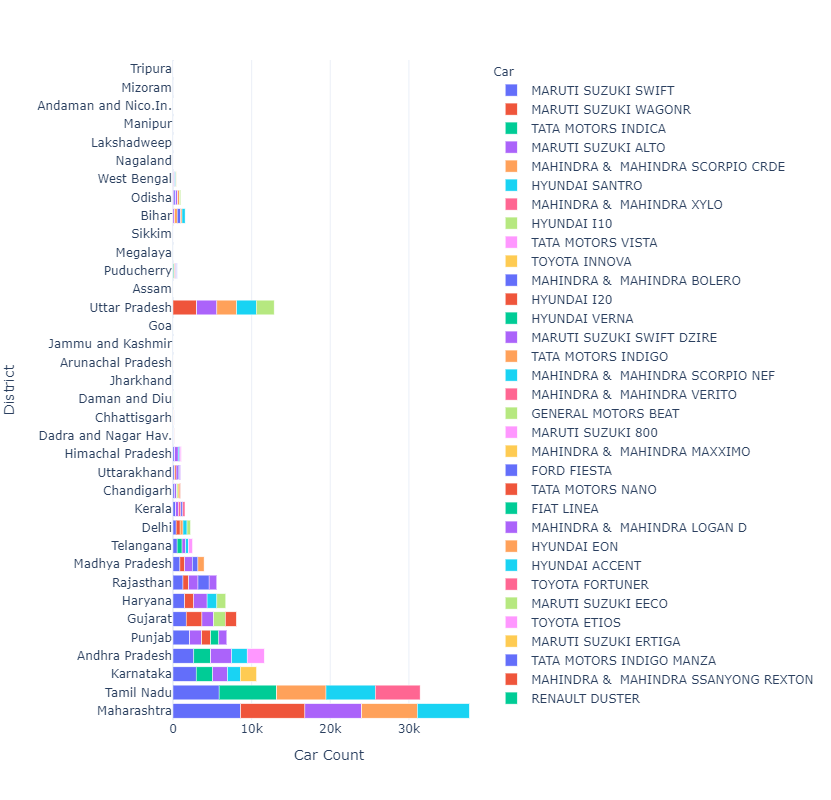

In [450]:
fig = px.bar(cars_by_state2, y = "District", x = "Car Count", color = "Car", orientation='h', height=800, template="plotly_white")
# fig.xa
save_fig(fig, name="Top 5 Cars from each State")

In [224]:
pyoff.plot(fig,filename='state.html')

'state.html'

In [225]:
# fig.write_image("car_by_state.png")

In [226]:
odr_typ_by_state = pd.DataFrame(invoice.groupby(["District", "Order Type"]).size())
odr_typ_by_state.rename(columns={0: "Count"}, inplace=True)

In [227]:
g = odr_typ_by_state[["Count"]].groupby(level=0, group_keys=False)
odr_typ_by_state2 = g.apply(lambda x: x.sort_values("Count", ascending=False))
odr_typ_by_state2 = odr_typ_by_state2.sort_values("Count", ascending=False).reset_index()

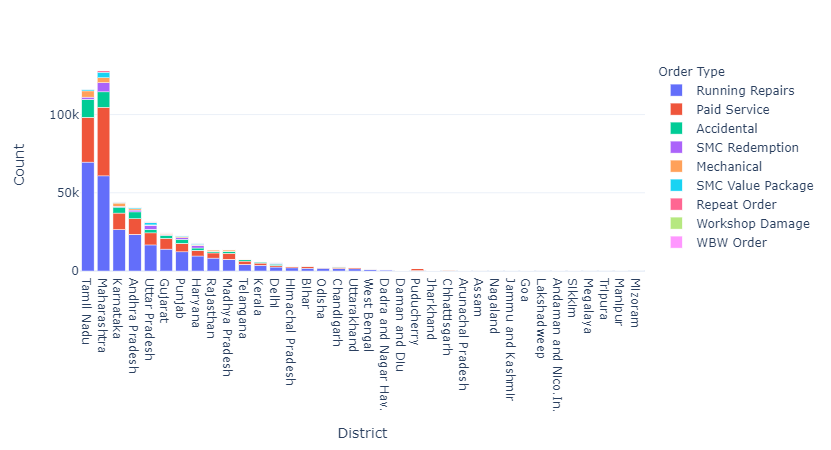

In [228]:
px.bar(odr_typ_by_state2, x = "District", y = "Count", color = "Order Type", orientation='v', template="plotly_white")

In [229]:
cars_by_state3 = pd.DataFrame(invoice.groupby(by=["District", "Make"]).size())
cars_by_state3.rename(columns={0: "Car Count"}, inplace=True)

In [230]:
g = cars_by_state3[["Car Count"]].groupby(level=0, group_keys=False)
cars_by_state4 = g.apply(lambda x: x.sort_values("Car Count", ascending=False).head(5))
cars_by_state4 = cars_by_state4.sort_values("Car Count", ascending=False).reset_index()

In [231]:
fig = px.bar(cars_by_state4, y = "District", x = "Car Count", color = "Make", orientation='h', height=800, template="plotly_white")

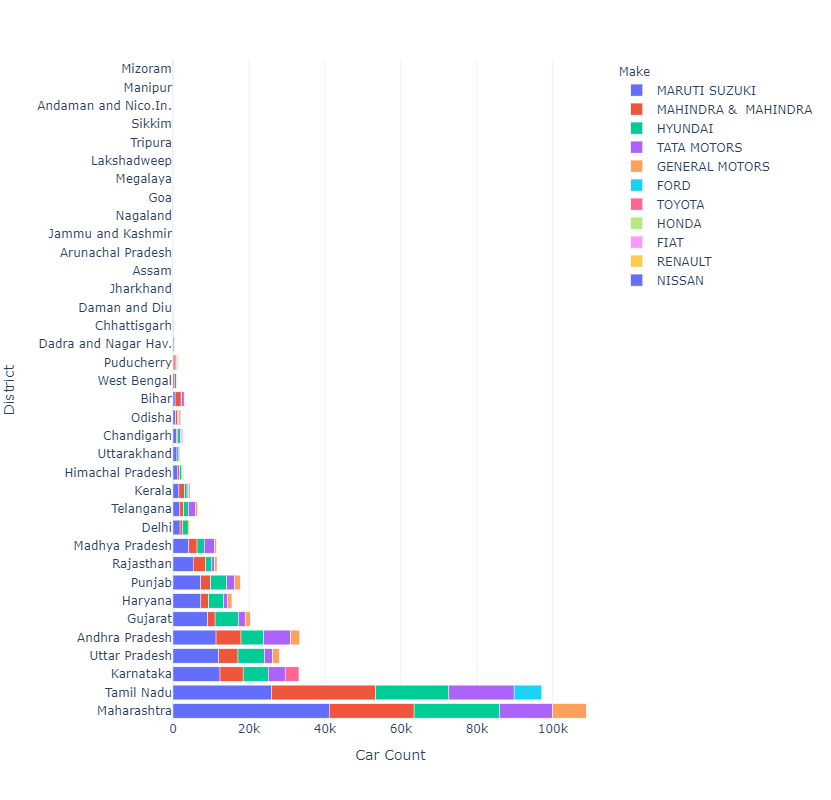

In [232]:
fig.show()

In [233]:
inv_jtd = pd.merge(invoice, jtd, how="inner", left_on="Job Card No", right_on="DBM Order")

In [234]:
make_order = pd.DataFrame(invoice.groupby(["Make", "Order Type"]).size())
make_order.rename(columns={0: "Count"}, inplace=True)
g = make_order[["Count"]].groupby(level=0, group_keys=False)
make_order = g.apply(lambda x: x.sort_values("Count", ascending=False).head(5))
make_order = make_order.sort_values("Count", ascending=False).reset_index()

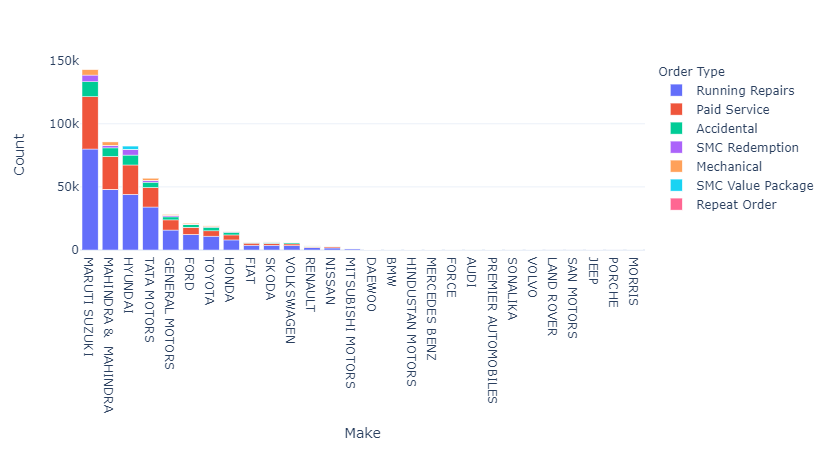

In [235]:
px.bar(make_order, x = "Make", y = "Count", color = "Order Type", orientation='v', template="plotly_white")

In [236]:
district_order = pd.DataFrame(invoice.groupby(["District", "Order Type"]).size())
district_order.rename(columns={0: "Count"}, inplace=True)
g = district_order[["Count"]].groupby(level=0, group_keys=False)
district_order = g.apply(lambda x: x.sort_values("Count", ascending=False).head(5))
district_order = district_order.sort_values("Count", ascending=False).reset_index()

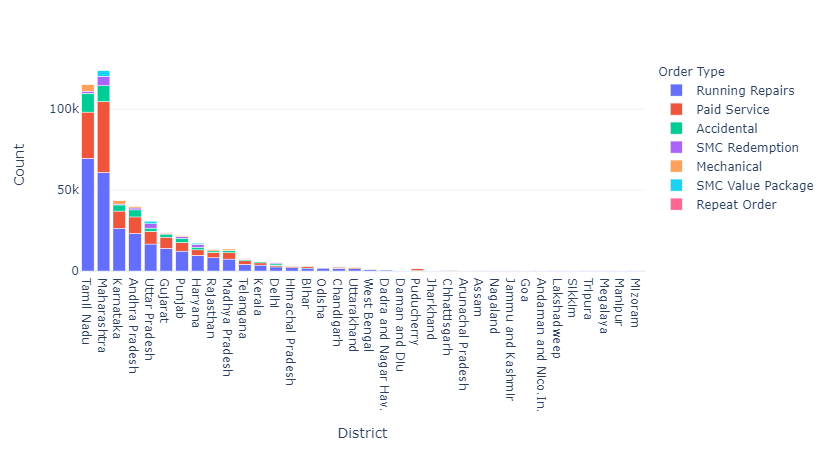

In [237]:
px.bar(district_order, x = "District", y = "Count", color = "Order Type", orientation='v', template="plotly_white")

In [238]:
order_cost = invoice[invoice["Total Value"]>0].groupby("Order Type")[["Parts Total", "Labour Total", "Misc Total", "OSL Total"]].sum()

In [239]:
order_cost = order_cost.unstack().reset_index()
order_cost.columns = ["Cost Type", "Order Type", "Cost"]

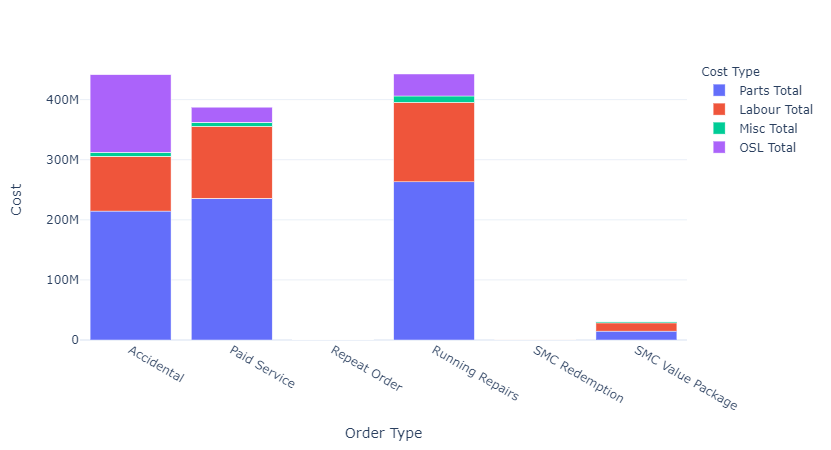

In [452]:
fig = px.bar(order_cost, x="Order Type", y="Cost", color="Cost Type", template="plotly_white")

save_fig(fig, name="Cost for each order type")

In [242]:
inv_service = invoice[invoice["Order Type"] == "Paid Service"]
inv_service["Invoice Date"] = pd.to_datetime(inv_service["Invoice Date"])
inv_service["Year"] = inv_service["Invoice Date"].dt.year
inv_service["Month"] = inv_service["Invoice Date"].dt.month

In [243]:
inv_ser_count = inv_service.groupby(["Year", "Month"]).size().reset_index()
inv_ser_count.rename(columns={0:"Count"}, inplace=True)

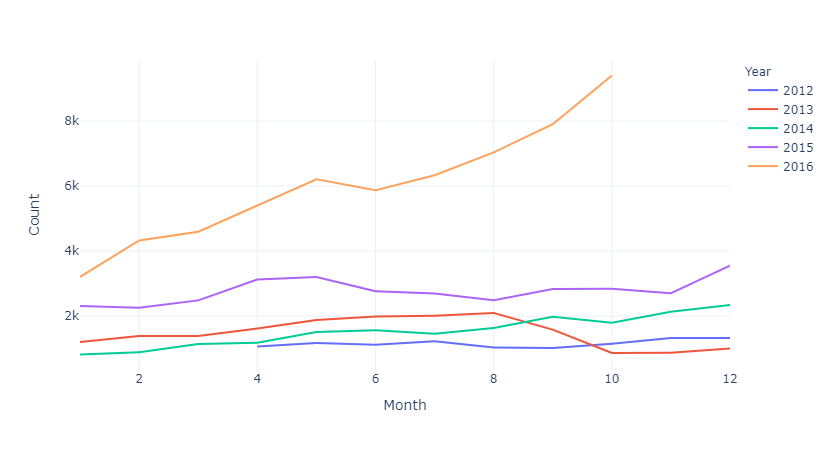

In [453]:
fig = px.line(inv_ser_count, x="Month", y="Count", color="Year", template="plotly_white")

save_fig(fig, name="Monthly Customer Count")

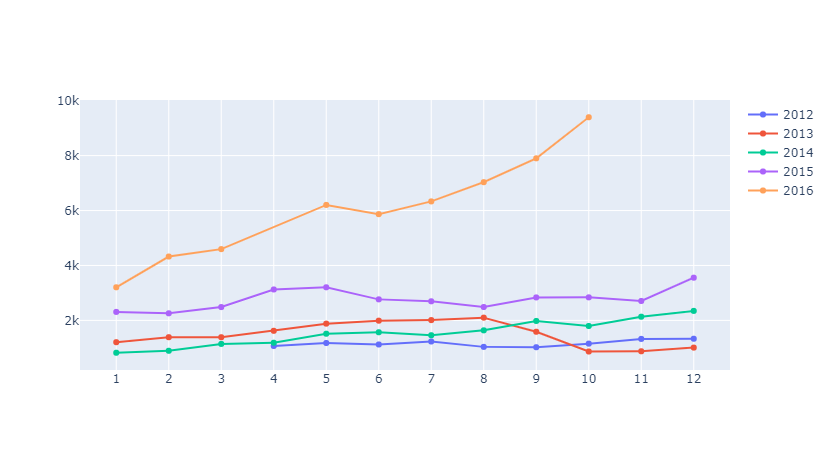

In [245]:
plot_data = []
for yr in inv_ser_count["Year"].unique():
    plt_dta = go.Scatter(
        x = inv_ser_count[inv_ser_count["Year"]==yr]["Month"],
        y = inv_ser_count[inv_ser_count["Year"]==yr]["Count"],
        name = str(yr)
    )
    plot_data.append(plt_dta)
    
fig = go.Figure(plot_data)
fig.layout.xaxis.tickvals = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
pyoff.iplot(fig)

In [246]:
inv_cust_new2 = pd.DataFrame(invoice["Customer No."].unique())
inv_cust_new2.columns = ["Customer No."]

In [247]:
inv_cust_rec = invoice[["Customer No.", "Invoice Date"]]
inv_cust_rec["Invoice Date"] = pd.to_datetime(inv_cust_rec["Invoice Date"])
last = inv_cust_rec["Invoice Date"].max()
inv_cust_rec = (last - inv_cust_rec.groupby(["Customer No."])["Invoice Date"].max()).dt.days.reset_index()
inv_cust_rec.columns = ["Customer No.", "Recency"]
inv_cust_new2 = pd.merge(inv_cust_new2, inv_cust_rec, on="Customer No.")

In [248]:
inv_cust_rec = inv_cust_new2[(inv_cust_new2["Recency"]>inv_cust_new2["Recency"].quantile(0.05)) & (inv_cust_new2["Recency"]<inv_cust_new2["Recency"].quantile(0.95))]

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_cust[["Recency"]])
inv_cust_rec["Recency_Cluster"] = kmean.predict(inv_cust_rec[["Recency"]])

inv_cust_rec = order_cluster("Recency_Cluster", "Recency", inv_cust_rec, False)

In [249]:
inv_cust_new2 = pd.merge(inv_cust_new2, inv_cust_rec[["Customer No.", "Recency_Cluster"]], on="Customer No.", how="left")

In [250]:
inv_cust_new2.loc[inv_cust_new2["Recency"]<=inv_cust_new2["Recency"].quantile(0.05), "Recency_Cluster"] = 3
inv_cust_new2.loc[inv_cust_new2["Recency"]>=inv_cust_new2["Recency"].quantile(0.95), "Recency_Cluster"] = 0

In [251]:
inv_cust_new2 = pd.merge(inv_cust_new2, invoice.groupby("Customer No.").size().reset_index().rename(columns={0:"Frequency"}), on="Customer No.", how="left")

In [252]:
inv_cust_rec = inv_cust_new2[(inv_cust_new2["Frequency"]>inv_cust_new2["Frequency"].quantile(0.05)) & (inv_cust_new2["Frequency"]<inv_cust_new2["Frequency"].quantile(0.95))]

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_cust[["Frequency"]])
inv_cust_rec["Frequency_Cluster"] = kmean.predict(inv_cust_rec[["Frequency"]])

inv_cust_rec = order_cluster("Frequency_Cluster", "Frequency", inv_cust_rec, True)

In [253]:
inv_cust_new2 = pd.merge(inv_cust_new2, inv_cust_rec[["Customer No.", "Frequency_Cluster"]], on="Customer No.", how="left")

In [254]:
inv_cust_new2.loc[inv_cust_new2["Frequency"]<=inv_cust_new2["Frequency"].quantile(0.05), "Frequency_Cluster"] = 0
inv_cust_new2.loc[inv_cust_new2["Frequency"]>=inv_cust_new2["Frequency"].quantile(0.95), "Frequency_Cluster"] = 3

In [255]:
inv_cust_new2 = pd.merge(inv_cust_new2, invoice.groupby("Customer No.")["Total Amt Wtd Tax."].sum().reset_index().rename(columns={"Total Amt Wtd Tax." : "Revenue"}), on="Customer No.", how="left")

In [256]:
inv_cust_rec = inv_cust_new2[(inv_cust_new2["Revenue"]>inv_cust_new2["Revenue"].quantile(0.05)) & (inv_cust_new2["Revenue"]<inv_cust_new2["Revenue"].quantile(0.95))]

kmean = KMeans(n_clusters=4, max_iter=1000)
kmean.fit(inv_cust[["Revenue"]])
inv_cust_rec["Revenue_Cluster"] = kmean.predict(inv_cust_rec[["Revenue"]])

inv_cust_rec = order_cluster("Revenue_Cluster", "Revenue", inv_cust_rec, True)

In [257]:
inv_cust_new2 = pd.merge(inv_cust_new2, inv_cust_rec[["Customer No.", "Revenue_Cluster"]], on="Customer No.", how="left")

In [258]:
inv_cust_new2.loc[inv_cust_new2["Revenue"]<=inv_cust_new2["Revenue"].quantile(0.05), "Revenue_Cluster"] = 0
inv_cust_new2.loc[inv_cust_new2["Revenue"]>=inv_cust_new2["Revenue"].quantile(0.95), "Revenue_Cluster"] = 3

In [259]:
inv_cust_new2["Overall Score"] = inv_cust_new2["Recency_Cluster"] + inv_cust_new2["Frequency_Cluster"] + inv_cust_new2["Revenue_Cluster"]

In [260]:
inv_cust_new2["Segment"] = "Low-Value"
inv_cust_new2.loc[inv_cust_new2["Overall Score"]>3, "Segment"] = "Mid-Value"
inv_cust_new2.loc[inv_cust_new2["Overall Score"]>7, "Segment"] = "High-Value"

In [261]:
inv_cust_new2[inv_cust_new2["Customer No."] == "E4981"]

,Customer No.,Recency,Recency_Cluster,Frequency,Frequency_Cluster,Revenue,Revenue_Cluster,Overall Score,Segment
8296,E4981,48,3.0,2668,3.0,11859728.34,3.0,9.0,High-Value


In [262]:
inv_cust_new[inv_cust_new["Customer No."] == "E4981"]

,Customer No.,Recency,RecencyCluster,Frequency,FrequencyCluster,Revenue,RevenueCluster,OverallScore,Segment


In [263]:
inv_cust_new.loc[inv_cust_new.shape[0]] = ["E4981", 0, 4, 2668, 4, 11859728.34, 4, 12, "High-Value"]

In [264]:
inv_cust_new[inv_cust_new["Customer No."] == "E4981"]

,Customer No.,Recency,RecencyCluster,Frequency,FrequencyCluster,Revenue,RevenueCluster,OverallScore,Segment
76345,E4981,0,4,2668,4,11859728.34,4,12,High-Value


In [265]:
inv_cus_seg = pd.merge(invoice, inv_cust_new, how="inner", on="Customer No.")
inv_cus_seg2 = pd.merge(invoice, inv_cust_new2, how="inner", on="Customer No.")

In [266]:
cust_seg = inv_cus_seg.groupby("Segment")
cust_seg2 = inv_cus_seg2.groupby("Segment")

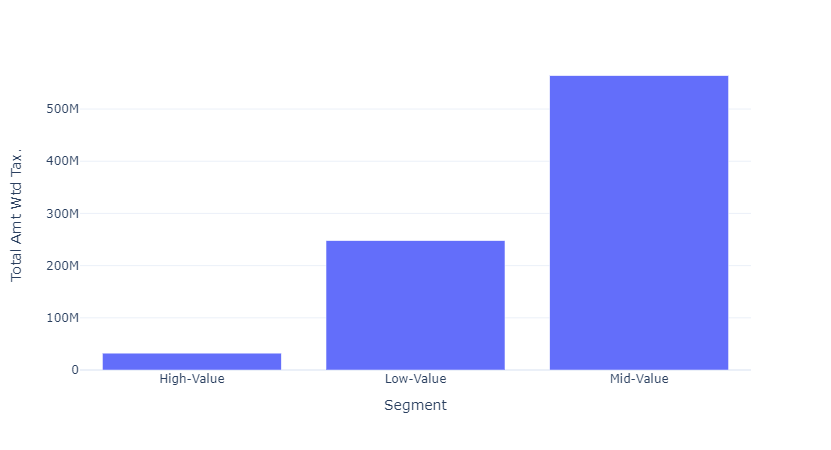

In [267]:
temp = cust_seg["Total Amt Wtd Tax."].sum().reset_index()
px.bar(temp, x="Segment", y="Total Amt Wtd Tax.", template="plotly_white")

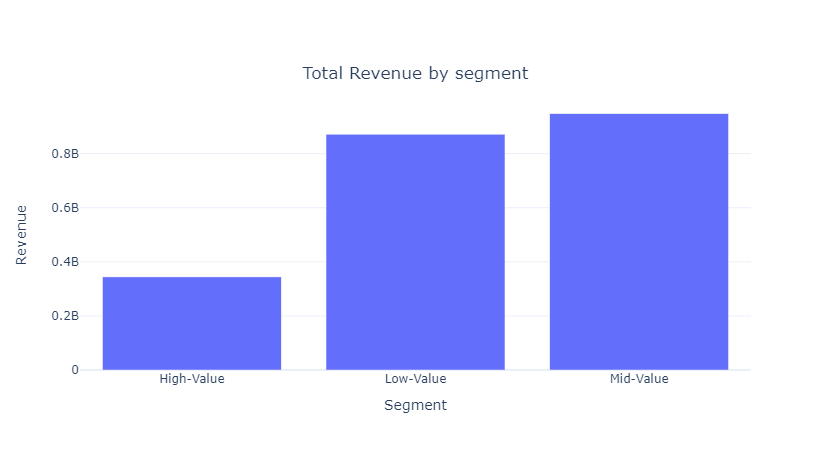

In [468]:
temp = cust_seg2["Total Amt Wtd Tax."].sum().reset_index()
fig = px.bar(temp, x="Segment", y="Total Amt Wtd Tax.", template="plotly_white", labels={"Total Amt Wtd Tax.":"Revenue"}, title={"text":"Total Revenue by segment", "x":0.5, "y":0.85})
save_fig(fig, name="Total Revenue by segment")

In [486]:
inv_cus_seg2["Invoice Date"] = pd.to_datetime(inv_cus_seg2["Invoice Date"])
inv_cus_seg2["YYYYMM"] = inv_cus_seg2["Invoice Date"].dt.year*100 + inv_cus_seg2["Invoice Date"].dt.month

In [491]:
g = inv_cus_seg2.groupby(["YYYYMM", "Segment"])["Total Amt Wtd Tax."].sum().reset_index()
g1 = inv_cus_seg2.groupby(["YYYYMM", "Segment"]).size().reset_index()
temp = pd.merge(g, g1, on=["YYYYMM", "Segment"])

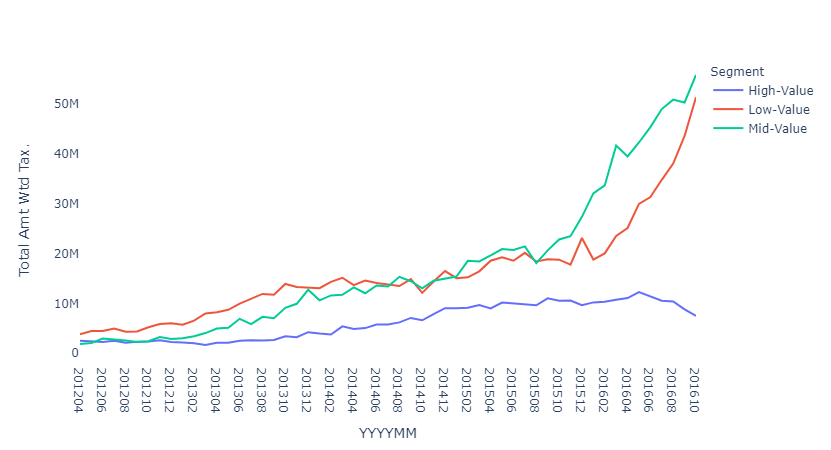

In [492]:
fig = px.line(
    temp,
    x="YYYYMM",
    y="Total Amt Wtd Tax.",
    color="Segment"
)

fig.update_layout(
    xaxis={
        "type" : "category"
    }
)

save_fig(fig, name="Revenue by segment")

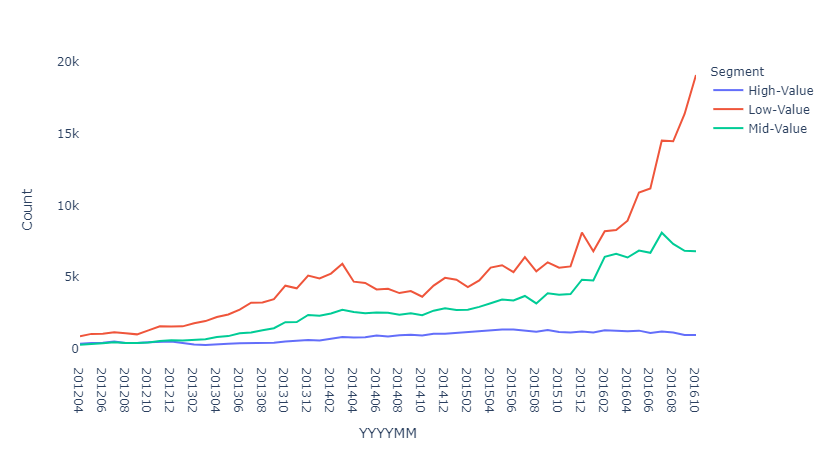

In [494]:
fig = px.line(
    temp,
    x="YYYYMM",
    y=0,
    color="Segment"
)

fig.update_layout(
    xaxis={
        "type" : "category"
    },
    yaxis={
        "title" : "Count"
    }
)

save_fig(fig, name="Customer count by segment")

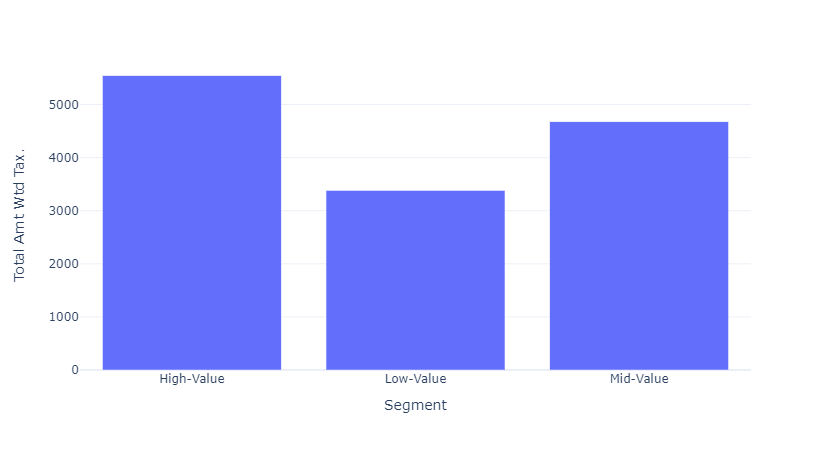

In [269]:
temp = cust_seg["Total Amt Wtd Tax."].mean().reset_index()
px.bar(temp, x="Segment", y="Total Amt Wtd Tax.", template="plotly_white")

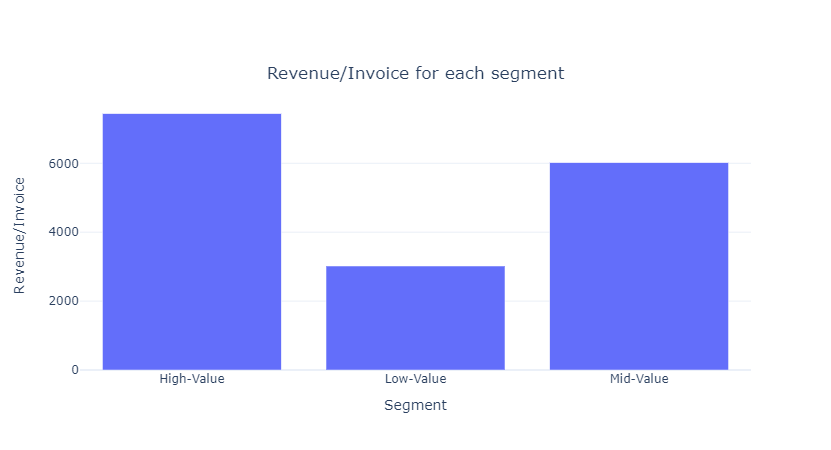

In [470]:
temp = cust_seg2["Total Amt Wtd Tax."].mean().reset_index()
fig = px.bar(temp, x="Segment", y="Total Amt Wtd Tax.", template="plotly_white", title={"text":"Revenue/Invoice for each segment", "x":0.5, "y":0.85}, labels={"Total Amt Wtd Tax.":"Revenue/Invoice"})
save_fig(fig, name="Revenue_Invoice for each segment")

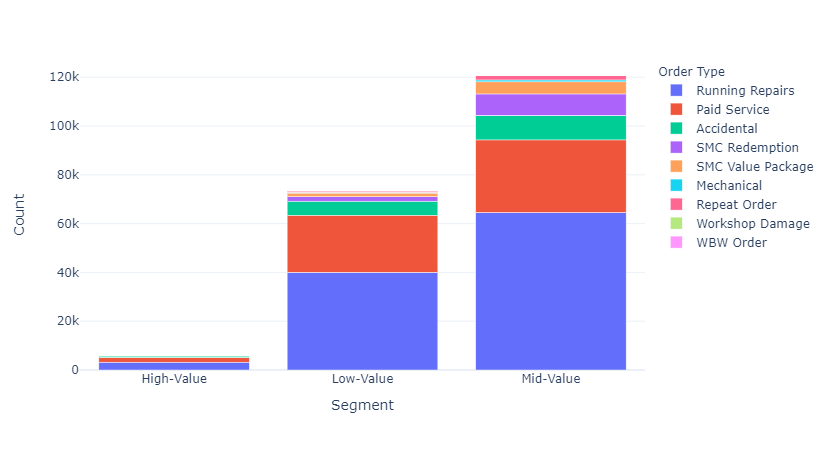

In [271]:
temp = pd.DataFrame(cust_seg["Order Type"].value_counts()).rename(columns = {"Order Type" : "Count"}).reset_index()
px.bar(temp, x="Segment", y="Count", color="Order Type", template="plotly_white")

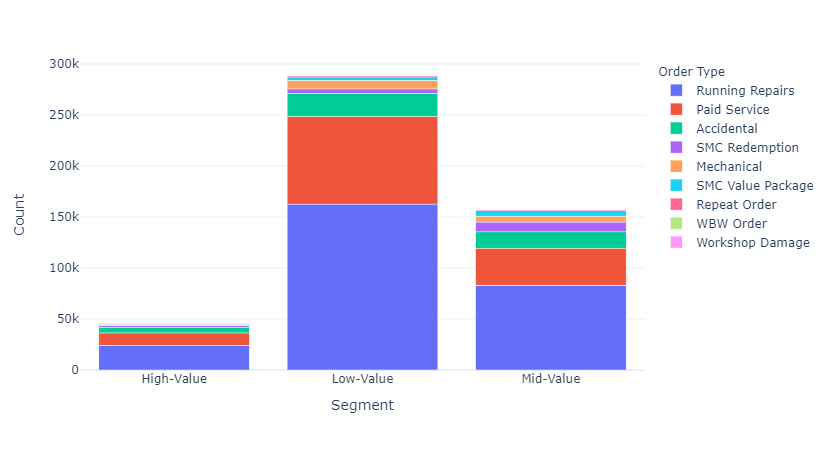

In [471]:
temp = pd.DataFrame(cust_seg2["Order Type"].value_counts()).rename(columns = {"Order Type" : "Count"}).reset_index()
fig = px.bar(temp, x="Segment", y="Count", color="Order Type", template="plotly_white")
save_fig(fig, name="Top order type by each state")

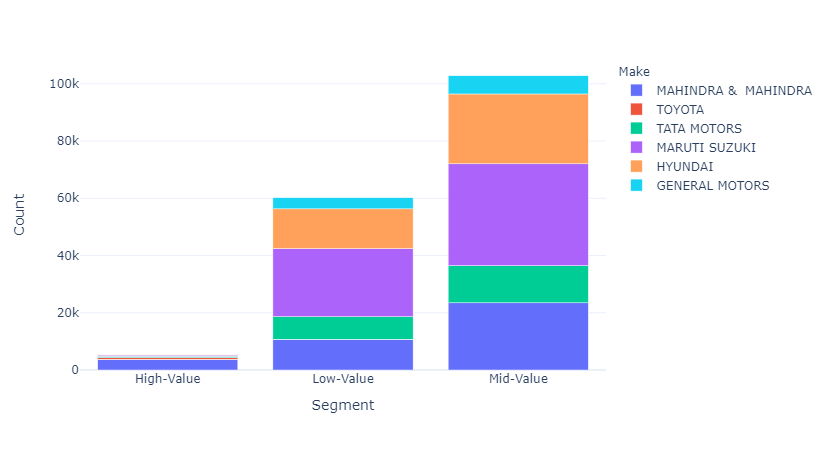

In [273]:
temp = pd.DataFrame(cust_seg["Make"].value_counts()).rename(columns = {"Make" : "Count"})
g = temp.groupby(level=0, group_keys=False)
temp = g.apply(lambda x: x.head(5))
temp = temp.reset_index()
px.bar(temp, x="Segment", y="Count", color="Make", template="plotly_white")

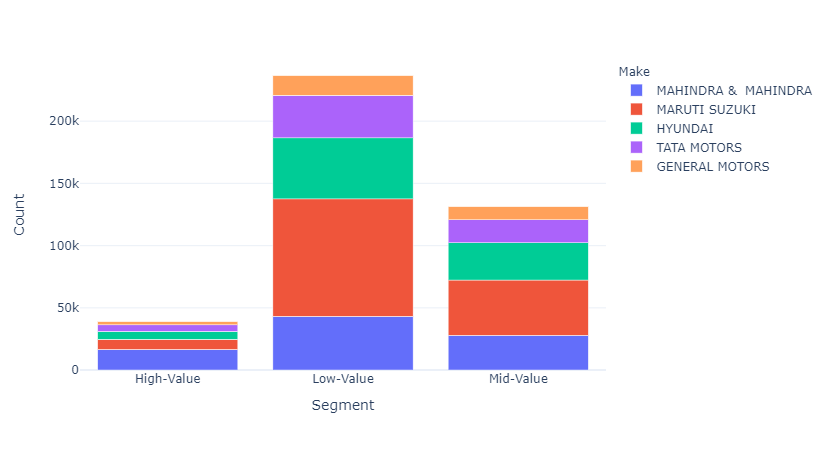

In [472]:
temp = pd.DataFrame(cust_seg2["Make"].value_counts()).rename(columns = {"Make" : "Count"})
g = temp.groupby(level=0, group_keys=False)
temp = g.apply(lambda x: x.head(5))
temp = temp.reset_index()
fig = px.bar(temp, x="Segment", y="Count", color="Make", template="plotly_white")
save_fig(fig, name="Top Manufacturer by each cluster")

In [275]:
jtd.head()

,DBM Order,Order Item,Material,Labor Value Number,Description,Item Category,Order Quantity,Target quantity UoM,Net value
0,22385,180,OSLCC_SRV31,NaN,MACHINING RR.SUSPENSION CHARGE (MAJOR),P010,1.2,MIN,1869.87
1,23910,10,1DM279018170117,NaN,ASSY.OIL COOLER (6-PLATE) (VOR,P002,1.0,EA,2151.13
2,23910,40,1IS150203BE01,NaN,FRONT WHEEL BEARING/ LUBRICATE,P002,1.0,EA,2552.92
3,23910,60,1DM279001990173,NaN,ASSY.CYL.HEAD W /O INJ.(NA W /O,P002,1.0,EA,20360.14
4,23910,70,1DM88552790S001SA,NaN,Engine Overhaul Kit -Indica Di,P002,1.0,EA,10691.63


In [276]:
jtd[["Material", "Item Category", "Description"]].drop_duplicates().shape, jtd[["Material", "Item Category"]].drop_duplicates().shape

((140667, 3), (126610, 2))

In [277]:
jtd.Description.nunique(), jtd["Item Category"].nunique(), jtd.Material.nunique(), jtd.shape

(58558, 5, 126567, (5619484, 9))

In [278]:
temp = jtd[["Material", "Item Category"]].drop_duplicates()
temp = temp[temp.duplicated(subset=["Material"], keep=False)]
temp = temp.sort_values("Material")
temp

,Material,Item Category
1938152,AUA4_VAS8,P001
706662,AUA4_VAS8,P011
115805,AUA4_VAS8,P010
4819727,GENERALMOTORS_SRV,P011
303,GENERALMOTORS_SRV,P001
...,...,...
2015039,OSLPS_SRV139,P011
4881384,TOLC_MENU4,P011
4943113,TOLC_MENU4,P001
16494,VWPO_MENU3,P001


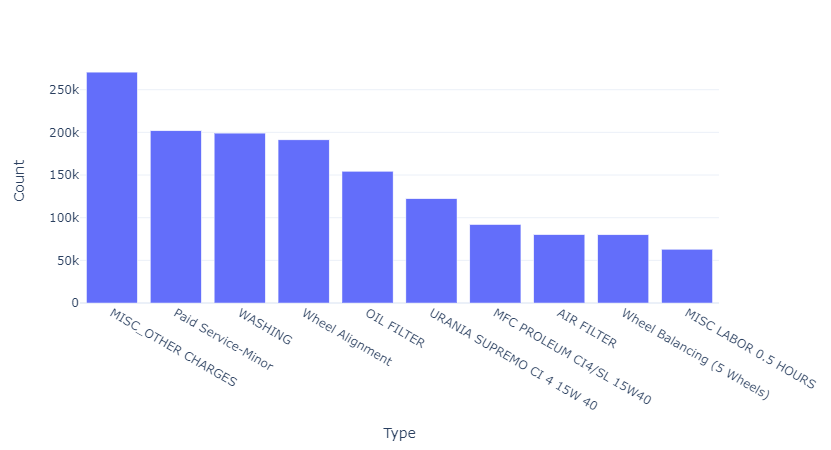

In [279]:
temp = jtd["Description"].value_counts().head(10).reset_index()
temp.columns = ["Type", "Count"]
px.bar(temp, x = "Type", y = "Count", template="plotly_white")

In [280]:
invoice2 = invoice.copy()
invoice2["Invoice DateTime"] = pd.to_datetime(invoice["Invoice Date"] + " " +invoice["Invoice Time"])

In [281]:
invoice2["Hr"] = invoice2["Invoice DateTime"].dt.hour
invoice2["Day"] = invoice2["Invoice DateTime"].dt.day_name()

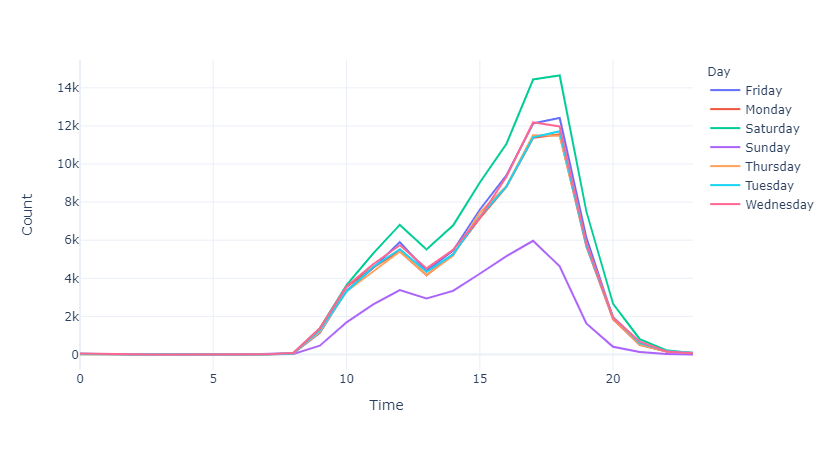

In [454]:
temp = invoice2.groupby(["Day", "Hr"]).size().reset_index()
fig = px.line(temp, x="Hr", y=0, color="Day", template="plotly_white", labels={"0":"Count", "Hr":"Time"})

save_fig(fig, name="Weekly customer count")

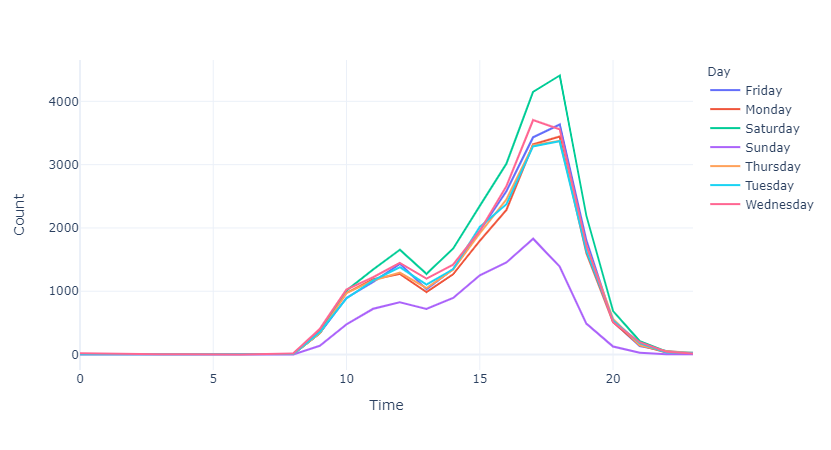

In [456]:
temp = invoice2[invoice2["Order Type"]=="Paid Service"]
temp = temp.groupby(["Day", "Hr"]).size().reset_index()
px.line(temp, x="Hr", y=0, color="Day", template="plotly_white", labels={"0":"Count", "Hr":"Time"})

In [617]:
g = pd.DataFrame(inv_jtd.groupby(["District","Description"]).size())
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False).head(2))
g.columns = ["Count"]
g = g.reset_index().sort_values("Count", ascending=False)

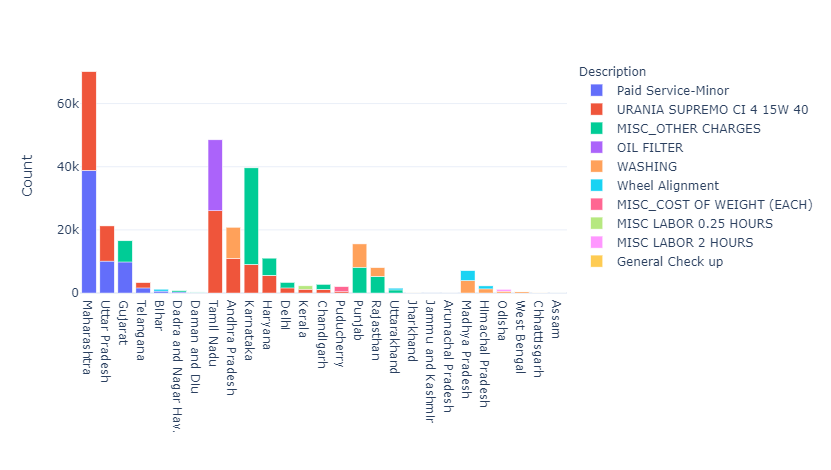

In [622]:
fig = px.bar(
    g[g["Count"]>10], 
    x="District",
    y="Count",
    color="Description",
    template="plotly_white",
    labels={
        "District" : ""
    },
    width=800,
    height = 470
)

save_fig(fig, name="Sate Wise Inventory Item Used")

In [629]:
g = pd.DataFrame(inv_jtd.groupby(["Make","Description"]).size())
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False).head(3))
g.columns = ["Count"]
g = g.reset_index().sort_values("Count", ascending=False)

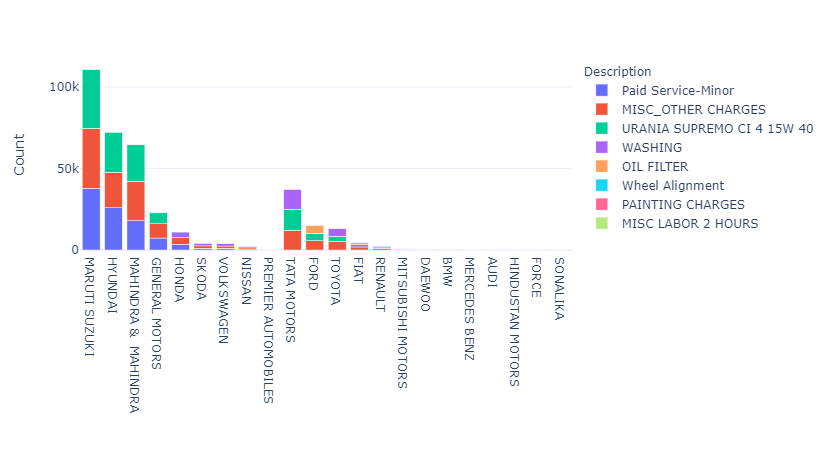

In [630]:
fig = px.bar(
    g[g["Count"]>10], 
    x="Make",
    y="Count",
    color="Description",
    template="plotly_white",
    labels={
        "Make" : ""
    }
)

save_fig(fig, name="Car Inventory Item used")

In [645]:
g = pd.DataFrame(inv_jtd.groupby(["Order Type","Description"]).size())
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False).head(3))
g.columns = ["Count"]
g = g.reset_index().sort_values("Count", ascending=False)

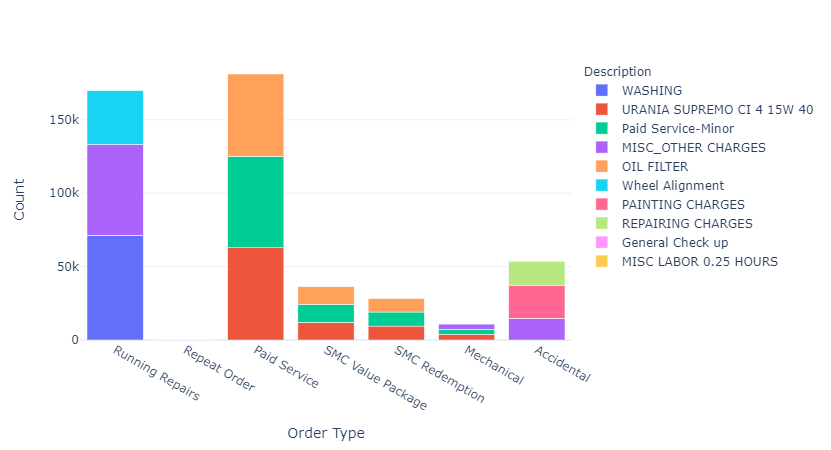

In [646]:
fig = px.bar(
    g[g["Count"]>10], 
    x="Order Type",
    y="Count",
    color="Description",
    template="plotly_white"
)

save_fig(fig, name="Top Inventory Item by Order Type")

In [289]:
cust_inv = pd.merge(customer, invoice, on="Customer No.")

In [290]:
cust_inv["Data Origin"].value_counts()

Z001    16214
Name: Data Origin, dtype: int64

In [291]:
g = customer.groupby(["Data Origin", "Partner Type"]).size()
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False).head(1)).reset_index().rename(columns={0:"Count"})

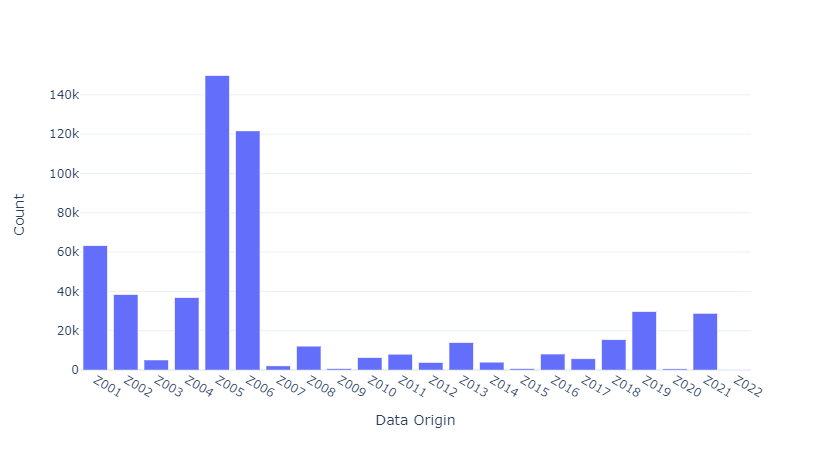

In [292]:
px.bar(g, x="Data Origin", y="Count", template="plotly_white")

In [293]:
invoice2["Year"] = invoice2["Invoice DateTime"].dt.year
invoice2["Month"] = invoice2["Invoice DateTime"].dt.month
invoice2["YYYYMM"] = invoice2["Year"]*100 + invoice2["Month"]

In [294]:
cust_type_count = invoice2.groupby("YYYYMM")["Cust Type"].value_counts().reset_index(name="Count")

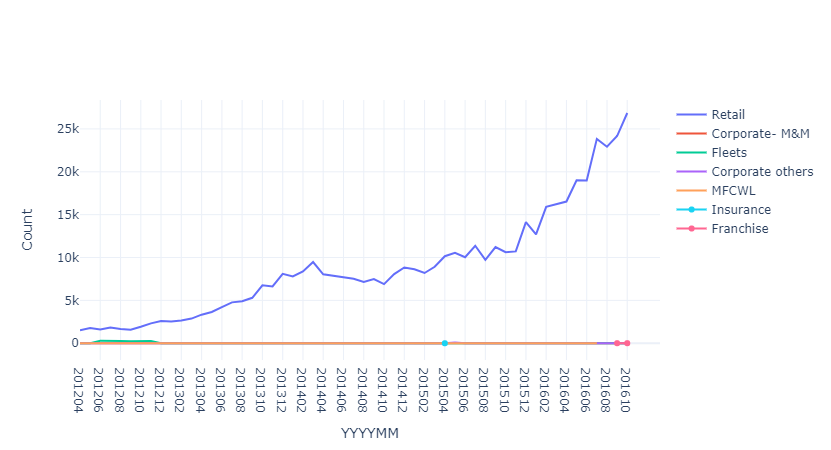

In [647]:
plot_data = []

for cutype in cust_type_count["Cust Type"].unique():
    plt_dt = go.Scatter(
        x=cust_type_count[cust_type_count["Cust Type"] == cutype]["YYYYMM"],
        y=cust_type_count[cust_type_count["Cust Type"] == cutype]["Count"],
        name=cutype
    )
    plot_data.append(plt_dt)

plot_layout = go.Layout(
    xaxis={
        "type" : "category",
        "title" : "YYYYMM"
    },
    template="plotly_white",
    yaxis={
        "title" : "Count"
    }
)

fig = go.Figure(plot_data, plot_layout)
# pyoff.iplot(fig)
save_fig(fig, name="Top Customer Type")

In [657]:
g = invoice2.groupby(["YYYYMM", "Make"]).size()
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False).head(5)).reset_index().rename(columns={0:"Count"})
# g = g.sort_values("YYYYMM")

In [306]:
top_cars = g["Make"].unique()

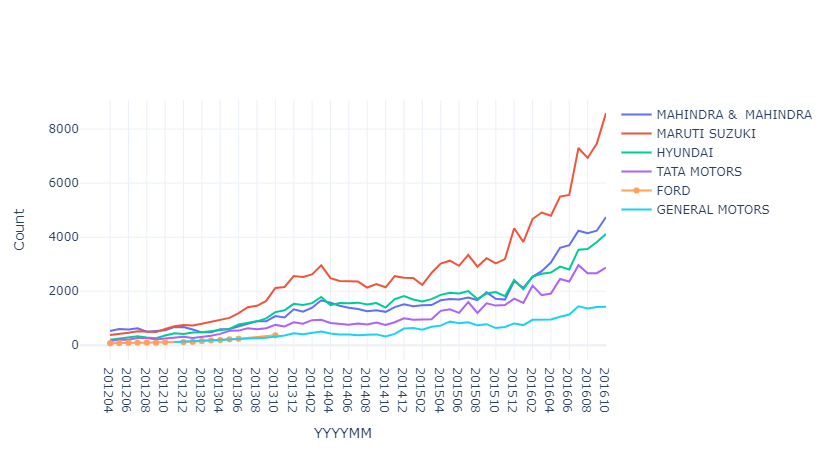

In [658]:
plot_data = []

for temp in g["Make"].unique():
    plt_dt = go.Scatter(
        x=g[g["Make"] == temp]["YYYYMM"],
        y=g[g["Make"] == temp]["Count"],
        name=temp
    )
    plot_data.append(plt_dt)

plot_layout = go.Layout(
    xaxis={
        "type" : "category",
        "title" : "YYYYMM"
    },
    template="plotly_white",
    yaxis={
        "title" : "Count"
    },
#     title={
#         "text":"Top 5 Cars",
#         "x":0.5,
#         "y":0.85
#     }
)

fig = go.Figure(plot_data, plot_layout)
# pyoff.iplot(fig)
save_fig(fig, name="Top cars hist")

In [654]:
g = invoice2.groupby(["YYYYMM", "Order Type"]).size()
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False)).reset_index().rename(columns={0:"Count"})
g = g[g["Order Type"]!="Mechanical"]
g = g[g["YYYYMM"]!=201604]

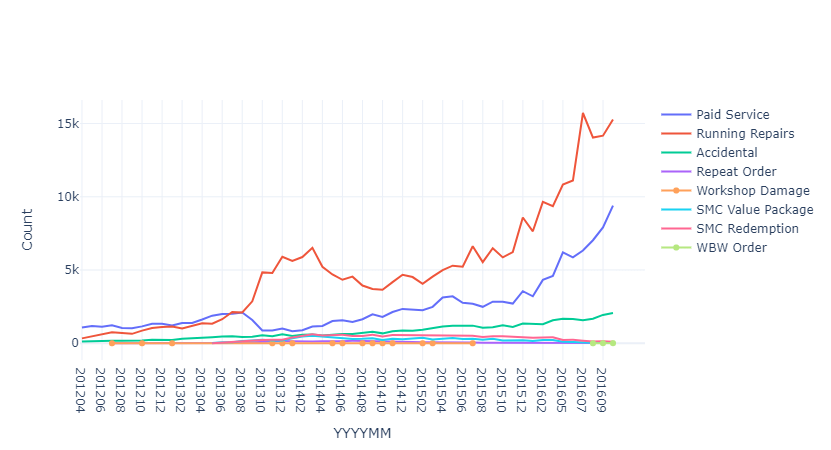

In [656]:
plot_data = []

for temp in g["Order Type"].unique():
    plt_dt = go.Scatter(
        x=g[g["Order Type"] == temp]["YYYYMM"],
        y=g[g["Order Type"] == temp]["Count"],
        name=temp
    )
    plot_data.append(plt_dt)

plot_layout = go.Layout(
    xaxis={
        "type" : "category",
        "title" : "YYYYMM"
    },
    template="plotly_white",
    yaxis={
        "title" : "Count"
    },
#     title={
#         "text":"Top 5 Order Type",
#         "x":0.5,
#         "y":0.85
#     }
)

fig = go.Figure(plot_data, plot_layout)
# pyoff.iplot(fig)
save_fig(fig, name="Top Order Types hist")

In [300]:
inv_jtd2 = pd.merge(invoice2, jtd, how="inner", left_on="Job Card No", right_on="DBM Order")

In [608]:
g = inv_jtd2.groupby(["YYYYMM", "Description"]).size()
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False).head(2)).reset_index().rename(columns={0:"Count"})

In [609]:
temp = g["Description"].unique()
temp = inv_jtd2.loc[inv_jtd2["Description"].isin(temp),:]

In [610]:
g = temp.groupby(["YYYYMM", "Description"]).size()
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False)).reset_index().rename(columns={0:"Count"})

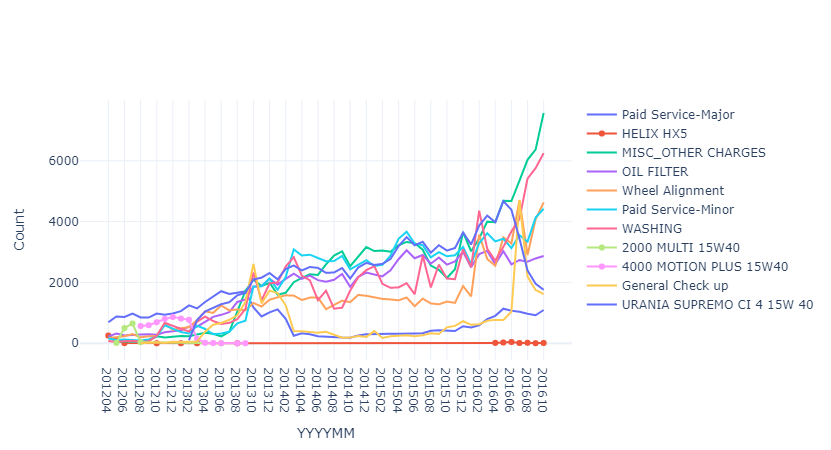

In [612]:
plot_data = []

for temp in g["Description"].unique():
    plt_dt = go.Scatter(
        x=g[g["Description"] == temp]["YYYYMM"],
        y=g[g["Description"] == temp]["Count"],
        name=temp
    )
    plot_data.append(plt_dt)

plot_layout = go.Layout(
    xaxis={
        "type" : "category",
        "title" : "YYYYMM"
    },
    template="plotly_white",
    yaxis={
        "title" : "Count"
    },
#     title={
#         "text":"Top Order Type",
#         "x":0.5,
#         "y":0.85
#     }
)

fig = go.Figure(plot_data, plot_layout)
save_fig(fig, name="Top Inventory Items")
# pyoff.iplot(fig)

In [308]:
top_cars_only = inv_jtd2.loc[inv_jtd["Make"].isin(top_cars), :]

In [426]:
g = top_cars_only.groupby(["Make", "Order Type"]).size()
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False)).reset_index().rename(columns={0:"Count"})

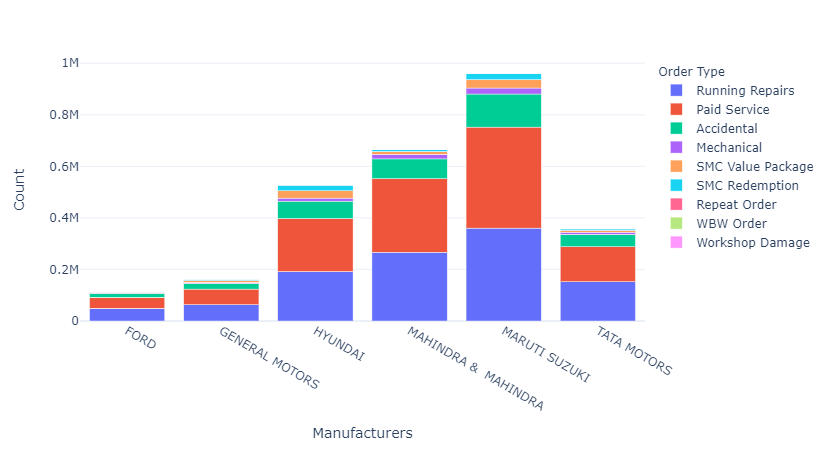

In [449]:
fig = px.bar(g, x="Make", y="Count", color="Order Type", template="plotly_white", labels={"Make":"Manufacturers"})

save_fig(fig, name="Top Manufacturers and there order type")

In [320]:
g = top_cars_only.groupby(["Make", "Description"]).size()
g = g.groupby(level=0, group_keys=False)
g = g.apply(lambda x: x.sort_values(0, ascending=False).head(5)).reset_index().rename(columns={0:"Count"})

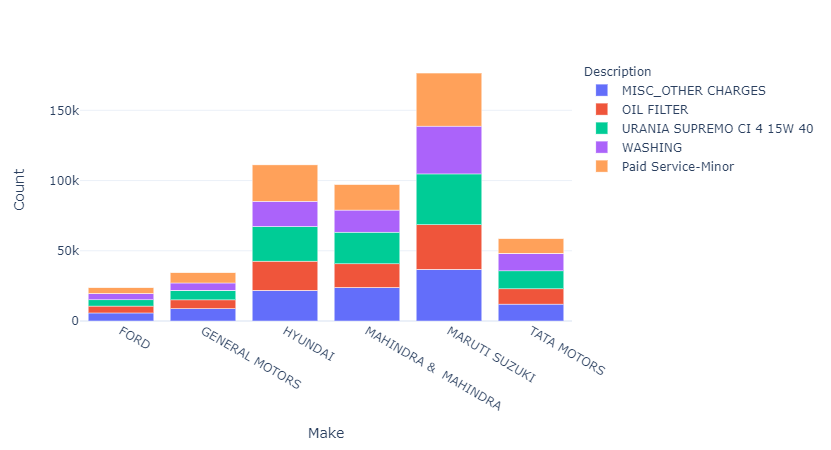

In [321]:
px.bar(g, x="Make", y="Count", color="Description", template="plotly_white")

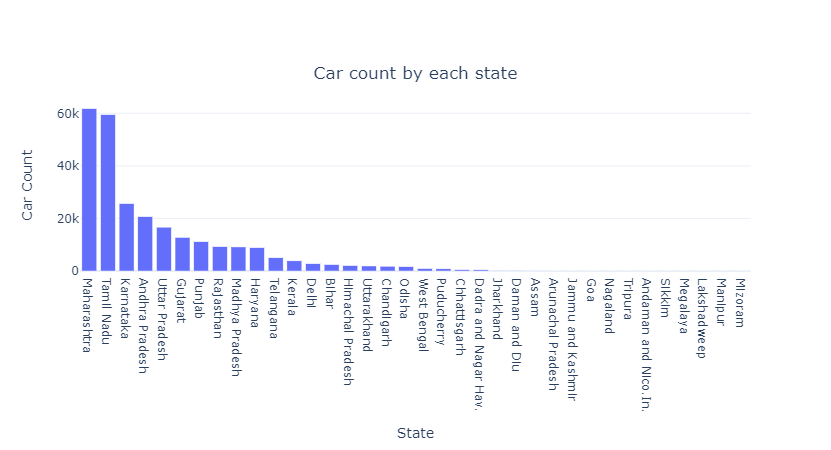

In [448]:
fig = px.bar(
    invoice[["District", "Regn No"]].drop_duplicates().groupby("District").size().reset_index().rename(columns={0:"Count"}).sort_values("Count", ascending=False),
    x="District",
    y="Count",
    labels={
        "District" : "State",
        "Count" : "Car Count"
    },
    title = {
        "text" : "Car count by each state",
        "x" : 0.5,
        "y" : 0.85
    },
    template = "plotly_white"
)

save_fig(fig, name="Car Count by each State")